In [1]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [2]:
import scape
import katdal
import katpoint
import katsdpscripts
import glob
import re
import pandas as pd 

import csv
import operator

INFO: Generating grammar tables from /usr/lib/python2.7/lib2to3/Grammar.txt
INFO: Generating grammar tables from /usr/lib/python2.7/lib2to3/PatternGrammar.txt


In [3]:
from os import system

In [4]:
print "Scape version: %s"%scape.__version__
print "katdal version: %s"%katdal.__version__
print "katpoint version: %s"%katpoint.__version__
print "katsdpscripts version: %s"%katsdpscripts.__version__

Scape version: 0.1.dev616+master.e836eb2
katdal version: 0.9.6.dev664+master.3ff15ef
katpoint version: 0.8.dev355+master.341001f
katsdpscripts version: 0.1.dev2808+master.790eabe


In [5]:
h5_filename ='/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/07/1523065879.h5'
%set_env h5_filename = $h5_filename

env: h5_filename=/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/07/1523065879.h5


In [6]:
d = katdal.open(h5_filename);
ant_list,ants = [],[]
[ant_list.append(ant.name) for ant in d.ants]
print(ant_list)

DEBUG: Found int_time=7.996616972 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1523010668.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
DEBUG: Added '1127-145' [radec] (and 1 aliases)
DEBUG: Added '1334-127' [radec] (and 1 aliases)
DEBUG: Added '1345+125' [radec] (and 1 aliases)
DEBUG: Added 'CTD93' [radec] (and 1 aliases)
DEBUG: Added '1709-281' [radec] (and 1 aliases)
DEBUG: Added '1722-554' [radec] (and 1 aliases)
DEBUG: Added 'NRAO530' [radec] (and 1 aliases)
DEBUG: Added '1740-517' [radec] (and 1 aliases)
DEBUG: Added '1827-360' [radec] (and 1 aliases)
DEBUG: Added '1830-210' [radec] (and 1 aliases)
DEBUG: Added 'OV-236' [radec] (and 1 aliases)
DEBUG: Added '1934-638' [radec] (and 1 aliases)
DEBUG: Added '

In [7]:
ant_list.remove('m009') # flatline
ant_list.remove('m022') # bad
ant_list.remove('m004') # bad
ant_list.remove('m025') # died and came back
ant_list.remove('m038') # dead all the time
ant_list.remove('m026') # died during obs

ants=','.join(ant_list)
print ants
%set_env ants=$ants

m000,m001,m002,m003,m005,m006,m008,m010,m011,m012,m013,m014,m015,m016,m017,m020,m021,m023,m024,m027,m029,m030,m031,m032,m033,m034,m036,m039,m040,m041,m042,m043,m044,m045,m046,m047,m048,m049,m050,m051,m052,m053,m054,m055,m056,m057,m058,m059,m060,m061,m062,m063
env: ants=m000,m001,m002,m003,m005,m006,m008,m010,m011,m012,m013,m014,m015,m016,m017,m020,m021,m023,m024,m027,m029,m030,m031,m032,m033,m034,m036,m039,m040,m041,m042,m043,m044,m045,m046,m047,m048,m049,m050,m051,m052,m053,m054,m055,m056,m057,m058,m059,m060,m061,m062,m063


In [8]:
matplotlib.rcParams['font.size']=5.0

In [9]:
ref_ant='m005'
%set_env ref_ant=$ref_ant

env: ref_ant=m005



Loading and processing data...

DEBUG: Found int_time=7.996616972 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1523010668.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
antennas (52): m000, m001, m002, m003, m005 (*ref*), m006, m008, m010, m011, m012, m013, m014, m015, m016, m017, m020, m021, m023, m024, m027, m029, m030, m031, m032, m033, m034, m036, m039, m040, m041, m042, m043, m044, m045, m046, m047, m048, m049, m050, m051, m052, m053, m054, m055, m056, m057, m058, m059, m060, m061, m062, m063 [pol H]
baselines (1326): 0-1 0-2 1-2 0-3 1-3 2-3 0-4 1-4 2-4 3-4 0-5 1-5 2-5 3-5 4-5 0-6 1-6 2-6 3-6 4-6 5-6 0-7 1-7 2-7 3-7 4-7 5-7 6-7 0-8 1-8 2-8 3-8 4-8 5-8 6-8 7-8 0-9 1-9 2-9 3-9 4-9 5-9 6-9 7-9 8-9 0-10 1-10 2

scan   1 (  16 samples) 0.032 0.034 0.034 0.034 0.034 0.035 0.036 0.035 0.036 0.035 0.036 0.033 0.035 0.033 0.035 0.035 0.035 0.037 0.037 0.036 0.034 0.035 0.033 0.037 0.035 0.035 0.034 0.036 0.034 0.032 0.036 0.034 0.036 0.034 0.036 0.035 0.035 0.033 0.035 0.034 0.037 0.036 0.037 0.035 0.035 0.034 0.032 0.035 0.034 0.034 0.034 0.036 0.034 0.033 0.035 0.034 0.032 0.035 0.034 0.035 0.034 0.035 0.033 0.033 0.034 0.033 0.033 0.033 0.033 0.032 0.033 0.032 0.036 0.033 0.033 0.035 0.034 0.032 0.033 0.032 0.035 0.035 0.035 0.033 0.036 0.038 0.035 0.036 0.035 0.036 0.036 0.035 0.034 0.037 0.034 0.035 0.035 0.037 0.035 0.034 0.035 0.034 0.034 0.034 0.037 0.034 0.032 0.035 0.034 0.035 0.034 0.034 0.034 0.033 0.035 0.034 0.033 0.034 0.036 0.035 0.034 0.033 0.033 0.034 0.034 0.032 0.035 0.034 0.033 0.036 0.034 0.033 0.032 0.034 0.035 0.034 0.034 0.033 0.035 0.033 0.034 0.033 0.035 0.033 0.034 0.035 0.034 0.032 0.033 0.034 0.034 0.034 0.034 0.032 0.031 0.033 0.032 0.033 0.033 0.035 0.033 0.033 0.03

scan   5 (  16 samples) 0.031 0.033 0.030 0.032 0.031 0.034 0.031 0.031 0.035 0.033 0.033 0.030 0.033 0.030 0.033 0.033 0.032 0.034 0.034 0.033 0.033 0.032 0.030 0.034 0.031 0.033 0.031 0.034 0.032 0.030 0.032 0.031 0.032 0.032 0.032 0.032 0.032 0.031 0.034 0.034 0.032 0.032 0.033 0.032 0.034 0.032 0.030 0.032 0.031 0.032 0.031 0.033 0.031 0.031 0.032 0.030 0.030 0.032 0.032 0.031 0.032 0.031 0.032 0.031 0.031 0.030 0.031 0.028 0.032 0.029 0.030 0.029 0.032 0.030 0.031 0.032 0.030 0.029 0.032 0.030 0.032 0.032 0.031 0.030 0.033 0.032 0.032 0.031 0.032 0.032 0.038 0.031 0.030 0.033 0.033 0.031 0.033 0.033 0.033 0.032 0.033 0.031 0.031 0.030 0.032 0.031 0.029 0.030 0.032 0.032 0.031 0.032 0.032 0.031 0.033 0.033 0.031 0.028 0.032 0.031 0.031 0.032 0.032 0.032 0.032 0.030 0.032 0.032 0.032 0.031 0.030 0.030 0.030 0.030 0.031 0.031 0.031 0.030 0.032 0.032 0.030 0.030 0.033 0.031 0.031 0.031 0.031 0.030 0.029 0.030 0.030 0.030 0.030 0.029 0.029 0.031 0.029 0.029 0.028 0.031 0.029 0.030 0.03

scan   9 (  16 samples) 0.032 0.036 0.034 0.037 0.033 0.037 0.034 0.033 0.035 0.036 0.032 0.033 0.033 0.035 0.034 0.036 0.035 0.038 0.038 0.038 0.036 0.036 0.035 0.037 0.036 0.037 0.033 0.036 0.034 0.032 0.036 0.035 0.034 0.036 0.035 0.034 0.035 0.035 0.036 0.035 0.037 0.033 0.035 0.034 0.035 0.036 0.035 0.036 0.036 0.037 0.034 0.037 0.032 0.034 0.034 0.034 0.034 0.034 0.035 0.035 0.034 0.035 0.034 0.033 0.033 0.033 0.035 0.033 0.036 0.032 0.035 0.033 0.035 0.033 0.033 0.032 0.032 0.032 0.036 0.033 0.036 0.035 0.035 0.035 0.037 0.035 0.034 0.037 0.035 0.037 0.033 0.033 0.035 0.035 0.035 0.036 0.034 0.037 0.036 0.035 0.036 0.036 0.032 0.032 0.036 0.033 0.031 0.033 0.034 0.034 0.034 0.035 0.033 0.032 0.034 0.035 0.032 0.033 0.032 0.033 0.032 0.032 0.036 0.035 0.034 0.034 0.036 0.037 0.035 0.034 0.036 0.036 0.033 0.035 0.035 0.033 0.033 0.033 0.036 0.032 0.034 0.035 0.039 0.039 0.036 0.038 0.038 0.038 0.034 0.037 0.035 0.034 0.033 0.035 0.035 0.037 0.036 0.037 0.037 0.044 0.045 0.040 0.04

scan  13 (  16 samples) 0.020 0.022 0.022 0.022 0.020 0.022 0.022 0.021 0.023 0.022 0.021 0.021 0.022 0.021 0.022 0.022 0.022 0.023 0.022 0.023 0.022 0.021 0.021 0.022 0.021 0.022 0.022 0.023 0.021 0.021 0.022 0.021 0.022 0.021 0.022 0.021 0.021 0.021 0.023 0.022 0.023 0.021 0.023 0.022 0.021 0.021 0.020 0.022 0.022 0.022 0.021 0.022 0.021 0.021 0.021 0.021 0.020 0.022 0.021 0.022 0.021 0.022 0.021 0.021 0.022 0.021 0.021 0.020 0.021 0.021 0.021 0.021 0.022 0.021 0.021 0.021 0.021 0.020 0.022 0.022 0.023 0.022 0.023 0.021 0.023 0.022 0.022 0.022 0.021 0.022 0.021 0.021 0.021 0.023 0.022 0.023 0.021 0.023 0.022 0.022 0.022 0.022 0.021 0.021 0.022 0.021 0.020 0.021 0.021 0.022 0.021 0.022 0.021 0.021 0.021 0.021 0.021 0.020 0.022 0.021 0.021 0.021 0.022 0.022 0.022 0.021 0.022 0.022 0.022 0.022 0.021 0.022 0.021 0.022 0.022 0.021 0.021 0.020 0.022 0.021 0.022 0.021 0.022 0.022 0.021 0.022 0.022 0.022 0.021 0.022 0.022 0.021 0.021 0.020 0.020 0.021 0.021 0.021 0.021 0.021 0.021 0.020 0.02

scan  17 (  16 samples) 0.032 0.031 0.035 0.026 0.033 0.031 0.033 0.028 0.034 0.030 0.035 0.034 0.040 0.037 0.032 0.036 0.039 0.041 0.041 0.041 0.039 0.043 0.042 0.046 0.041 0.043 0.039 0.031 0.039 0.036 0.039 0.038 0.039 0.037 0.035 0.038 0.043 0.038 0.043 0.035 0.039 0.036 0.031 0.039 0.029 0.037 0.039 0.039 0.039 0.038 0.038 0.030 0.036 0.036 0.031 0.036 0.032 0.034 0.035 0.039 0.037 0.031 0.036 0.030 0.028 0.033 0.033 0.036 0.041 0.037 0.031 0.033 0.043 0.037 0.043 0.035 0.041 0.036 0.036 0.037 0.036 0.043 0.041 0.033 0.042 0.040 0.033 0.036 0.040 0.033 0.030 0.036 0.032 0.035 0.035 0.034 0.034 0.040 0.042 0.037 0.038 0.041 0.038 0.035 0.035 0.036 0.038 0.034 0.036 0.035 0.029 0.040 0.038 0.027 0.034 0.036 0.030 0.033 0.026 0.034 0.036 0.033 0.034 0.033 0.031 0.033 0.039 0.043 0.037 0.036 0.040 0.033 0.037 0.039 0.029 0.033 0.039 0.034 0.035 0.039 0.042 0.036 0.036 0.040 0.043 0.040 0.040 0.040 0.035 0.034 0.039 0.042 0.043 0.041 0.043 0.041 0.041 0.042 0.040 0.035 0.034 0.038 0.03

scan  21 (  16 samples) 0.025 0.029 0.026 0.029 0.027 0.028 0.028 0.027 0.030 0.027 0.029 0.027 0.029 0.027 0.028 0.029 0.028 0.030 0.029 0.030 0.029 0.028 0.027 0.029 0.029 0.029 0.029 0.031 0.028 0.027 0.028 0.027 0.028 0.028 0.029 0.029 0.028 0.027 0.030 0.029 0.030 0.028 0.029 0.030 0.026 0.028 0.028 0.029 0.028 0.029 0.028 0.030 0.028 0.026 0.028 0.027 0.026 0.029 0.028 0.028 0.026 0.028 0.027 0.027 0.028 0.029 0.027 0.026 0.029 0.028 0.028 0.027 0.029 0.027 0.028 0.029 0.027 0.028 0.030 0.028 0.031 0.029 0.030 0.029 0.030 0.032 0.029 0.031 0.030 0.030 0.026 0.029 0.029 0.031 0.030 0.030 0.028 0.030 0.029 0.029 0.030 0.028 0.028 0.026 0.028 0.027 0.026 0.031 0.028 0.029 0.028 0.031 0.027 0.029 0.030 0.028 0.028 0.025 0.028 0.027 0.027 0.026 0.028 0.027 0.028 0.028 0.030 0.028 0.027 0.028 0.028 0.028 0.028 0.029 0.030 0.028 0.028 0.027 0.029 0.028 0.028 0.028 0.029 0.028 0.027 0.028 0.028 0.027 0.027 0.028 0.028 0.027 0.029 0.027 0.025 0.028 0.027 0.027 0.026 0.028 0.027 0.026 0.02

scan  25 (  16 samples) 0.058 0.066 0.066 0.059 0.058 0.066 0.058 0.063 0.066 0.063 0.063 0.059 0.061 0.062 0.064 0.062 0.059 0.066 0.063 0.066 0.062 0.062 0.058 0.063 0.059 0.063 0.061 0.063 0.059 0.062 0.061 0.064 0.057 0.059 0.062 0.062 0.063 0.058 0.066 0.059 0.068 0.061 0.062 0.061 0.070 0.060 0.059 0.061 0.057 0.063 0.063 0.065 0.060 0.064 0.060 0.060 0.056 0.063 0.060 0.058 0.062 0.064 0.062 0.058 0.065 0.057 0.062 0.059 0.059 0.058 0.062 0.062 0.061 0.057 0.058 0.059 0.058 0.057 0.063 0.060 0.067 0.060 0.062 0.065 0.064 0.061 0.062 0.064 0.061 0.056 0.055 0.060 0.059 0.065 0.059 0.062 0.065 0.064 0.060 0.061 0.062 0.062 0.061 0.058 0.061 0.057 0.055 0.062 0.059 0.064 0.060 0.063 0.060 0.058 0.059 0.060 0.060 0.060 0.062 0.063 0.062 0.061 0.061 0.059 0.065 0.057 0.063 0.060 0.059 0.061 0.060 0.062 0.057 0.061 0.062 0.057 0.059 0.057 0.062 0.061 0.060 0.061 0.064 0.060 0.061 0.060 0.060 0.060 0.057 0.062 0.060 0.059 0.059 0.056 0.054 0.059 0.057 0.059 0.057 0.061 0.059 0.058 0.05

scan  29 (  16 samples) 0.032 0.035 0.033 0.033 0.032 0.036 0.036 0.033 0.037 0.036 0.034 0.035 0.036 0.033 0.035 0.036 0.034 0.037 0.036 0.036 0.036 0.034 0.033 0.036 0.035 0.036 0.034 0.035 0.033 0.032 0.036 0.035 0.034 0.034 0.036 0.034 0.033 0.033 0.036 0.035 0.036 0.034 0.038 0.035 0.034 0.034 0.032 0.035 0.035 0.036 0.034 0.035 0.034 0.035 0.034 0.033 0.032 0.034 0.034 0.036 0.034 0.036 0.033 0.034 0.034 0.032 0.033 0.032 0.033 0.034 0.034 0.034 0.033 0.032 0.033 0.034 0.032 0.031 0.033 0.034 0.035 0.034 0.035 0.034 0.036 0.035 0.035 0.035 0.035 0.033 0.034 0.034 0.035 0.036 0.036 0.037 0.035 0.036 0.035 0.035 0.035 0.034 0.033 0.033 0.035 0.034 0.033 0.034 0.034 0.034 0.032 0.036 0.034 0.034 0.035 0.034 0.033 0.033 0.034 0.034 0.033 0.033 0.035 0.034 0.036 0.033 0.036 0.035 0.034 0.034 0.034 0.033 0.033 0.033 0.034 0.033 0.033 0.032 0.035 0.033 0.034 0.033 0.036 0.034 0.034 0.034 0.034 0.033 0.033 0.034 0.034 0.033 0.032 0.033 0.029 0.034 0.032 0.032 0.032 0.034 0.032 0.032 0.03

scan  33 (  15 samples) 0.070 0.074 0.074 0.062 0.059 0.059 0.054 0.064 0.072 0.073 0.068 0.054 0.066 0.063 0.064 0.062 0.061 0.063 0.073 0.065 0.076 0.071 0.065 0.065 0.070 0.077 0.071 0.065 0.062 0.081 0.059 0.073 0.073 0.077 0.061 0.071 0.070 0.066 0.067 0.076 0.067 0.075 0.068 0.053 0.067 0.069 0.070 0.075 0.065 0.075 0.073 0.073 0.060 0.069 0.063 0.072 0.078 0.078 0.083 0.080 0.070 0.072 0.065 0.077 0.066 0.066 0.060 0.067 0.074 0.066 0.074 0.069 0.069 0.065 0.072 0.061 0.060 0.066 0.078 0.072 0.075 0.065 0.070 0.070 0.081 0.071 0.068 0.063 0.069 0.068 0.059 0.057 0.060 0.065 0.064 0.064 0.065 0.067 0.067 0.057 0.063 0.066 0.067 0.068 0.074 0.064 0.071 0.069 0.068 0.070 0.068 0.065 0.064 0.073 0.059 0.070 0.071 0.058 0.075 0.076 0.058 0.079 0.063 0.067 0.062 0.067 0.075 0.078 0.071 0.080 0.062 0.063 0.070 0.067 0.080 0.070 0.077 0.072 0.072 0.066 0.072 0.080 0.066 0.073 0.080 0.079 0.073 0.069 0.069 0.068 0.068 0.071 0.071 0.068 0.066 0.063 0.069 0.067 0.071 0.066 0.077 0.060 0.07

scan  37 (  15 samples) 0.038 0.038 0.042 0.038 0.048 0.043 0.031 0.033 0.032 0.031 0.046 0.055 0.037 0.045 0.035 0.045 0.052 0.040 0.040 0.031 0.046 0.036 0.038 0.036 0.041 0.038 0.036 0.039 0.040 0.033 0.036 0.033 0.033 0.033 0.032 0.034 0.038 0.050 0.044 0.057 0.040 0.052 0.045 0.039 0.046 0.046 0.049 0.049 0.053 0.041 0.050 0.040 0.037 0.035 0.060 0.040 0.046 0.045 0.045 0.040 0.041 0.039 0.038 0.035 0.050 0.053 0.034 0.042 0.044 0.050 0.038 0.037 0.046 0.039 0.037 0.033 0.035 0.044 0.051 0.054 0.061 0.050 0.037 0.070 0.054 0.038 0.057 0.068 0.072 0.058 0.056 0.043 0.054 0.037 0.050 0.034 0.054 0.041 0.035 0.035 0.047 0.047 0.060 0.039 0.061 0.036 0.047 0.034 0.048 0.034 0.047 0.045 0.035 0.056 0.041 0.044 0.047 0.027 0.054 0.042 0.029 0.037 0.034 0.037 0.041 0.034 0.041 0.041 0.040 0.038 0.038 0.035 0.037 0.049 0.037 0.032 0.041 0.042 0.040 0.037 0.035 0.053 0.043 0.035 0.040 0.059 0.056 0.052 0.046 0.055 0.052 0.047 0.039 0.027 0.053 0.038 0.052 0.028 0.039 0.036 0.038 0.037 0.02

scan  41 (  16 samples) 0.018 0.019 0.018 0.021 0.020 0.020 0.021 0.021 0.022 0.019 0.019 0.018 0.020 0.021 0.020 0.020 0.020 0.021 0.021 0.021 0.021 0.020 0.019 0.021 0.020 0.020 0.019 0.022 0.020 0.019 0.021 0.020 0.019 0.020 0.022 0.019 0.020 0.020 0.020 0.020 0.020 0.020 0.022 0.019 0.018 0.019 0.019 0.020 0.020 0.020 0.019 0.021 0.019 0.019 0.019 0.020 0.019 0.020 0.020 0.020 0.019 0.020 0.019 0.019 0.020 0.018 0.020 0.018 0.020 0.019 0.019 0.019 0.020 0.018 0.018 0.020 0.018 0.017 0.020 0.020 0.020 0.020 0.020 0.019 0.022 0.019 0.019 0.019 0.019 0.021 0.020 0.020 0.020 0.021 0.019 0.019 0.020 0.021 0.019 0.019 0.020 0.019 0.019 0.018 0.020 0.019 0.019 0.020 0.020 0.019 0.018 0.019 0.019 0.021 0.020 0.019 0.019 0.018 0.020 0.019 0.020 0.020 0.021 0.019 0.019 0.019 0.021 0.019 0.019 0.020 0.019 0.019 0.019 0.019 0.019 0.019 0.020 0.019 0.020 0.019 0.019 0.019 0.021 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.020 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.018 0.019 0.019 0.018 0.01

scan  45 (  15 samples) 0.010 0.011 0.010 0.011 0.010 0.011 0.011 0.010 0.011 0.011 0.010 0.010 0.011 0.011 0.011 0.011 0.010 0.011 0.011 0.011 0.011 0.011 0.010 0.011 0.011 0.011 0.010 0.011 0.010 0.010 0.011 0.011 0.010 0.010 0.011 0.010 0.011 0.010 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.010 0.010 0.011 0.010 0.011 0.010 0.011 0.010 0.010 0.011 0.010 0.010 0.011 0.010 0.011 0.010 0.011 0.010 0.010 0.011 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.011 0.010 0.010 0.010 0.010 0.010 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.012 0.011 0.012 0.011 0.010 0.011 0.011 0.010 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.010 0.010 0.011 0.010 0.010 0.010 0.011 0.011 0.010 0.011 0.011 0.011 0.011 0.010 0.010 0.010 0.011 0.010 0.011 0.010 0.011 0.010 0.011 0.010 0.011 0.011 0.010 0.011 0.010 0.010 0.010 0.011 0.011 0.010 0.010 0.010 0.011 0.010 0.011 0.010 0.011 0.010 0.010 0.011 0.010 0.010 0.010 0.011 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.01

scan  49 (  16 samples) 0.036 0.038 0.037 0.037 0.036 0.039 0.037 0.037 0.038 0.039 0.036 0.035 0.038 0.038 0.036 0.037 0.038 0.040 0.039 0.038 0.038 0.037 0.036 0.038 0.038 0.038 0.036 0.039 0.037 0.035 0.039 0.037 0.038 0.036 0.038 0.035 0.037 0.037 0.039 0.038 0.037 0.037 0.040 0.037 0.037 0.036 0.035 0.039 0.036 0.038 0.036 0.038 0.037 0.036 0.038 0.035 0.035 0.038 0.036 0.037 0.035 0.037 0.037 0.035 0.038 0.036 0.035 0.035 0.037 0.036 0.037 0.035 0.037 0.035 0.034 0.035 0.035 0.035 0.037 0.036 0.039 0.037 0.038 0.036 0.039 0.049 0.037 0.039 0.038 0.037 0.036 0.037 0.036 0.038 0.039 0.038 0.036 0.040 0.037 0.037 0.038 0.037 0.037 0.036 0.038 0.035 0.034 0.037 0.037 0.036 0.035 0.038 0.036 0.035 0.036 0.036 0.036 0.035 0.036 0.036 0.037 0.035 0.039 0.037 0.037 0.036 0.037 0.038 0.036 0.037 0.037 0.036 0.034 0.037 0.038 0.036 0.035 0.035 0.037 0.037 0.037 0.036 0.037 0.037 0.036 0.037 0.036 0.036 0.035 0.037 0.037 0.036 0.035 0.035 0.033 0.036 0.036 0.036 0.034 0.036 0.034 0.034 0.03

scan  53 (  15 samples) 0.072 0.070 0.074 0.079 0.075 0.077 0.077 0.081 0.084 0.079 0.070 0.068 0.070 0.079 0.088 0.081 0.071 0.081 0.069 0.078 0.079 0.077 0.081 0.082 0.078 0.089 0.080 0.091 0.078 0.078 0.082 0.086 0.095 0.080 0.088 0.072 0.089 0.083 0.089 0.091 0.102 0.089 0.090 0.073 0.072 0.096 0.090 0.099 0.104 0.109 0.103 0.092 0.082 0.090 0.087 0.093 0.097 0.102 0.106 0.112 0.101 0.094 0.090 0.085 0.084 0.076 0.093 0.100 0.096 0.099 0.098 0.090 0.094 0.083 0.081 0.075 0.076 0.074 0.097 0.099 0.097 0.106 0.097 0.095 0.101 0.080 0.086 0.079 0.072 0.078 0.084 0.090 0.086 0.092 0.095 0.092 0.084 0.095 0.074 0.078 0.080 0.078 0.081 0.072 0.077 0.082 0.082 0.085 0.085 0.095 0.081 0.095 0.067 0.065 0.075 0.088 0.083 0.081 0.089 0.074 0.090 0.095 0.097 0.089 0.087 0.100 0.093 0.117 0.115 0.123 0.126 0.106 0.087 0.080 0.093 0.108 0.102 0.101 0.104 0.101 0.094 0.103 0.086 0.091 0.115 0.120 0.120 0.121 0.125 0.115 0.113 0.117 0.078 0.080 0.092 0.084 0.079 0.085 0.091 0.083 0.076 0.102 0.10

scan  57 (  16 samples) 0.055 0.067 0.058 0.054 0.054 0.059 0.056 0.056 0.056 0.055 0.053 0.054 0.059 0.053 0.053 0.055 0.056 0.063 0.055 0.059 0.056 0.053 0.053 0.059 0.054 0.055 0.053 0.054 0.054 0.054 0.060 0.053 0.055 0.052 0.058 0.055 0.056 0.053 0.061 0.056 0.055 0.056 0.056 0.053 0.054 0.055 0.052 0.059 0.054 0.055 0.053 0.056 0.056 0.054 0.057 0.053 0.051 0.058 0.053 0.054 0.052 0.054 0.049 0.054 0.052 0.054 0.052 0.051 0.058 0.053 0.054 0.052 0.052 0.053 0.054 0.054 0.052 0.050 0.054 0.053 0.060 0.054 0.056 0.056 0.056 0.056 0.056 0.055 0.054 0.063 0.053 0.051 0.052 0.058 0.056 0.055 0.056 0.057 0.056 0.056 0.056 0.053 0.056 0.054 0.058 0.053 0.053 0.058 0.053 0.054 0.054 0.056 0.056 0.052 0.055 0.052 0.054 0.051 0.053 0.052 0.052 0.054 0.057 0.054 0.052 0.051 0.056 0.054 0.056 0.054 0.054 0.052 0.051 0.055 0.054 0.053 0.053 0.052 0.059 0.053 0.053 0.054 0.055 0.053 0.053 0.055 0.053 0.053 0.051 0.053 0.055 0.052 0.052 0.050 0.049 0.056 0.052 0.052 0.050 0.053 0.051 0.051 0.05

scan  61 (  16 samples) 0.034 0.036 0.036 0.034 0.033 0.036 0.035 0.037 0.038 0.038 0.035 0.033 0.037 0.033 0.035 0.038 0.035 0.039 0.037 0.038 0.037 0.036 0.035 0.037 0.036 0.036 0.035 0.038 0.036 0.035 0.036 0.037 0.037 0.036 0.037 0.035 0.037 0.037 0.038 0.039 0.036 0.037 0.038 0.036 0.034 0.035 0.034 0.038 0.035 0.035 0.034 0.037 0.036 0.036 0.035 0.037 0.033 0.038 0.036 0.036 0.035 0.036 0.035 0.033 0.034 0.035 0.034 0.034 0.036 0.034 0.034 0.032 0.037 0.034 0.034 0.036 0.033 0.035 0.038 0.036 0.039 0.038 0.037 0.036 0.038 0.037 0.035 0.036 0.036 0.035 0.037 0.036 0.036 0.039 0.037 0.036 0.034 0.038 0.037 0.034 0.036 0.034 0.036 0.034 0.036 0.035 0.035 0.037 0.034 0.035 0.034 0.037 0.034 0.035 0.035 0.035 0.033 0.033 0.036 0.035 0.037 0.033 0.037 0.037 0.037 0.035 0.037 0.035 0.034 0.035 0.035 0.034 0.034 0.035 0.035 0.035 0.037 0.034 0.037 0.036 0.037 0.034 0.036 0.034 0.033 0.034 0.034 0.033 0.034 0.034 0.035 0.034 0.034 0.035 0.033 0.034 0.036 0.034 0.034 0.035 0.033 0.032 0.03

scan  65 (  16 samples) 0.033 0.034 0.032 0.031 0.034 0.038 0.034 0.032 0.033 0.034 0.031 0.031 0.033 0.034 0.035 0.034 0.033 0.034 0.034 0.034 0.033 0.032 0.032 0.033 0.033 0.033 0.032 0.032 0.033 0.032 0.034 0.031 0.033 0.034 0.034 0.033 0.033 0.031 0.032 0.035 0.033 0.032 0.033 0.032 0.033 0.032 0.031 0.034 0.033 0.033 0.031 0.033 0.032 0.034 0.032 0.032 0.033 0.035 0.030 0.034 0.032 0.035 0.033 0.031 0.035 0.031 0.029 0.030 0.032 0.032 0.033 0.029 0.031 0.031 0.032 0.031 0.030 0.032 0.035 0.032 0.034 0.032 0.032 0.034 0.036 0.033 0.033 0.034 0.034 0.031 0.041 0.034 0.033 0.035 0.032 0.032 0.034 0.035 0.032 0.031 0.033 0.033 0.033 0.034 0.034 0.034 0.031 0.033 0.031 0.032 0.034 0.035 0.031 0.030 0.033 0.034 0.032 0.033 0.032 0.031 0.031 0.033 0.036 0.030 0.034 0.032 0.035 0.033 0.031 0.034 0.033 0.030 0.031 0.032 0.033 0.032 0.034 0.031 0.032 0.033 0.031 0.033 0.034 0.032 0.032 0.032 0.032 0.032 0.032 0.031 0.032 0.032 0.032 0.031 0.030 0.032 0.031 0.031 0.030 0.032 0.030 0.031 0.03

scan  69 (  16 samples) 0.023 0.025 0.023 0.024 0.024 0.025 0.024 0.023 0.026 0.024 0.023 0.022 0.025 0.024 0.024 0.025 0.024 0.025 0.025 0.025 0.025 0.024 0.023 0.024 0.024 0.025 0.023 0.026 0.023 0.022 0.025 0.023 0.025 0.024 0.025 0.024 0.024 0.023 0.025 0.024 0.025 0.024 0.025 0.024 0.023 0.024 0.023 0.024 0.023 0.024 0.023 0.025 0.023 0.023 0.024 0.023 0.023 0.024 0.023 0.024 0.023 0.024 0.024 0.024 0.024 0.022 0.023 0.022 0.024 0.023 0.024 0.023 0.024 0.023 0.022 0.023 0.023 0.023 0.024 0.024 0.025 0.024 0.025 0.024 0.026 0.024 0.024 0.024 0.024 0.024 0.026 0.024 0.023 0.025 0.024 0.024 0.025 0.025 0.024 0.024 0.024 0.024 0.023 0.023 0.025 0.023 0.023 0.024 0.024 0.024 0.023 0.025 0.023 0.023 0.023 0.023 0.023 0.023 0.025 0.024 0.023 0.023 0.024 0.024 0.023 0.024 0.024 0.024 0.023 0.024 0.023 0.023 0.023 0.024 0.024 0.023 0.023 0.022 0.024 0.023 0.024 0.023 0.024 0.024 0.023 0.024 0.023 0.023 0.023 0.024 0.024 0.023 0.023 0.022 0.022 0.023 0.022 0.023 0.022 0.023 0.023 0.022 0.02

scan  73 (  16 samples) 0.018 0.019 0.018 0.019 0.018 0.019 0.018 0.018 0.018 0.019 0.019 0.019 0.020 0.020 0.020 0.020 0.019 0.020 0.019 0.020 0.019 0.019 0.018 0.019 0.019 0.019 0.019 0.019 0.019 0.018 0.020 0.019 0.020 0.019 0.020 0.019 0.020 0.019 0.020 0.019 0.020 0.020 0.019 0.020 0.018 0.018 0.018 0.019 0.019 0.019 0.019 0.019 0.018 0.020 0.020 0.018 0.018 0.019 0.019 0.019 0.018 0.019 0.019 0.018 0.019 0.019 0.018 0.017 0.019 0.019 0.019 0.019 0.019 0.019 0.017 0.018 0.019 0.017 0.019 0.019 0.020 0.020 0.020 0.020 0.020 0.019 0.018 0.019 0.020 0.018 0.018 0.019 0.020 0.021 0.018 0.020 0.019 0.020 0.019 0.019 0.020 0.019 0.019 0.018 0.019 0.018 0.019 0.018 0.019 0.019 0.019 0.020 0.019 0.020 0.020 0.018 0.019 0.019 0.020 0.020 0.019 0.017 0.020 0.018 0.019 0.019 0.020 0.019 0.018 0.019 0.019 0.019 0.018 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.019 0.018 0.019 0.018 0.018 0.019 0.019 0.019 0.018 0.019 0.019 0.018 0.01

scan  77 (  16 samples) 0.028 0.028 0.028 0.028 0.028 0.030 0.028 0.027 0.028 0.031 0.026 0.027 0.027 0.028 0.027 0.030 0.029 0.031 0.029 0.030 0.030 0.028 0.027 0.029 0.029 0.028 0.028 0.029 0.028 0.026 0.029 0.029 0.028 0.029 0.029 0.027 0.028 0.027 0.030 0.030 0.030 0.028 0.029 0.029 0.031 0.028 0.027 0.029 0.028 0.029 0.028 0.030 0.028 0.027 0.030 0.028 0.026 0.029 0.027 0.028 0.027 0.029 0.026 0.027 0.029 0.026 0.027 0.025 0.028 0.028 0.028 0.028 0.029 0.027 0.026 0.028 0.027 0.025 0.028 0.028 0.029 0.029 0.029 0.028 0.031 0.032 0.029 0.028 0.030 0.030 0.027 0.029 0.026 0.030 0.029 0.031 0.030 0.030 0.029 0.029 0.030 0.029 0.028 0.026 0.030 0.027 0.025 0.029 0.029 0.028 0.029 0.030 0.027 0.024 0.030 0.027 0.026 0.026 0.029 0.029 0.029 0.027 0.030 0.028 0.030 0.028 0.029 0.028 0.028 0.028 0.028 0.028 0.028 0.029 0.028 0.028 0.027 0.026 0.029 0.028 0.028 0.028 0.029 0.027 0.028 0.028 0.028 0.028 0.027 0.028 0.028 0.028 0.027 0.027 0.026 0.027 0.027 0.028 0.026 0.028 0.027 0.027 0.02

scan  81 (  16 samples) 0.037 0.043 0.042 0.040 0.038 0.042 0.043 0.040 0.040 0.041 0.040 0.038 0.043 0.042 0.043 0.041 0.041 0.043 0.042 0.043 0.042 0.041 0.039 0.041 0.039 0.042 0.040 0.043 0.039 0.040 0.040 0.039 0.040 0.041 0.041 0.039 0.039 0.041 0.044 0.043 0.043 0.041 0.041 0.044 0.041 0.041 0.039 0.041 0.039 0.041 0.041 0.041 0.040 0.041 0.042 0.039 0.039 0.040 0.040 0.039 0.040 0.042 0.040 0.037 0.040 0.040 0.038 0.038 0.037 0.038 0.038 0.039 0.041 0.038 0.037 0.042 0.038 0.038 0.039 0.040 0.042 0.039 0.042 0.040 0.042 0.040 0.039 0.042 0.039 0.042 0.039 0.041 0.040 0.042 0.039 0.043 0.040 0.043 0.041 0.042 0.042 0.041 0.041 0.040 0.042 0.040 0.038 0.044 0.040 0.042 0.040 0.040 0.041 0.041 0.040 0.041 0.040 0.040 0.041 0.041 0.040 0.039 0.042 0.040 0.040 0.042 0.041 0.040 0.040 0.041 0.039 0.040 0.039 0.040 0.042 0.040 0.039 0.039 0.041 0.042 0.041 0.041 0.040 0.041 0.039 0.039 0.039 0.039 0.038 0.040 0.043 0.039 0.038 0.037 0.039 0.039 0.039 0.039 0.039 0.040 0.038 0.037 0.03

scan  85 (  15 samples) 0.034 0.035 0.033 0.033 0.033 0.036 0.035 0.034 0.037 0.035 0.035 0.032 0.035 0.035 0.036 0.036 0.034 0.036 0.036 0.037 0.035 0.035 0.034 0.036 0.034 0.036 0.035 0.037 0.034 0.032 0.036 0.034 0.035 0.033 0.035 0.036 0.035 0.032 0.037 0.034 0.036 0.035 0.036 0.036 0.034 0.034 0.032 0.035 0.034 0.035 0.035 0.036 0.034 0.035 0.036 0.033 0.032 0.034 0.033 0.035 0.034 0.035 0.033 0.034 0.034 0.035 0.033 0.031 0.034 0.033 0.034 0.032 0.035 0.033 0.032 0.033 0.032 0.033 0.033 0.034 0.036 0.035 0.036 0.035 0.037 0.035 0.035 0.037 0.037 0.035 0.033 0.035 0.034 0.036 0.034 0.036 0.035 0.037 0.035 0.036 0.035 0.035 0.034 0.033 0.035 0.034 0.032 0.035 0.034 0.034 0.034 0.035 0.034 0.033 0.035 0.034 0.034 0.031 0.034 0.035 0.034 0.032 0.035 0.034 0.035 0.034 0.035 0.034 0.034 0.035 0.034 0.034 0.034 0.034 0.035 0.034 0.034 0.032 0.035 0.033 0.036 0.034 0.035 0.034 0.034 0.035 0.034 0.033 0.032 0.034 0.034 0.033 0.033 0.032 0.031 0.033 0.032 0.034 0.032 0.034 0.033 0.032 0.03

scan  89 (  15 samples) 0.053 0.058 0.057 0.055 0.055 0.061 0.057 0.055 0.061 0.061 0.055 0.055 0.056 0.058 0.056 0.059 0.057 0.062 0.060 0.059 0.060 0.058 0.056 0.059 0.056 0.061 0.056 0.062 0.056 0.052 0.058 0.058 0.059 0.059 0.059 0.057 0.057 0.057 0.060 0.058 0.061 0.058 0.061 0.058 0.059 0.056 0.055 0.061 0.057 0.058 0.058 0.058 0.058 0.056 0.057 0.053 0.054 0.058 0.055 0.057 0.056 0.058 0.056 0.056 0.055 0.056 0.054 0.050 0.053 0.054 0.057 0.055 0.057 0.056 0.053 0.056 0.054 0.052 0.055 0.055 0.060 0.058 0.058 0.059 0.066 0.058 0.058 0.062 0.059 0.058 0.058 0.058 0.056 0.060 0.059 0.059 0.058 0.061 0.057 0.058 0.058 0.058 0.055 0.054 0.059 0.057 0.055 0.058 0.059 0.057 0.056 0.059 0.056 0.053 0.058 0.055 0.058 0.055 0.062 0.057 0.055 0.054 0.059 0.056 0.055 0.055 0.058 0.057 0.056 0.057 0.056 0.055 0.055 0.057 0.059 0.056 0.055 0.055 0.057 0.056 0.058 0.056 0.058 0.055 0.057 0.057 0.057 0.053 0.054 0.056 0.057 0.057 0.055 0.053 0.050 0.056 0.050 0.055 0.055 0.057 0.053 0.053 0.05

scan  93 (  32 samples) 0.036 0.039 0.039 0.533 0.531 0.540 0.038 0.038 0.039 0.535 0.036 0.039 0.040 0.535 0.039 0.039 0.040 0.042 0.537 0.040 0.040 0.036 0.036 0.039 0.530 0.036 0.036 0.038 0.037 0.034 0.038 0.534 0.037 0.039 0.039 0.036 0.038 0.035 0.040 0.528 0.041 0.039 0.039 0.039 0.038 0.037 0.036 0.037 0.534 0.038 0.037 0.039 0.037 0.035 0.037 0.036 0.036 0.037 0.533 0.038 0.036 0.039 0.037 0.036 0.038 0.036 0.035 0.034 0.037 0.532 0.037 0.035 0.037 0.035 0.034 0.037 0.036 0.035 0.038 0.038 0.039 0.534 0.040 0.037 0.041 0.039 0.040 0.039 0.038 0.054 0.052 0.042 0.038 0.039 0.535 0.039 0.039 0.043 0.038 0.037 0.039 0.038 0.038 0.037 0.039 0.037 0.036 0.038 0.534 0.038 0.035 0.038 0.036 0.037 0.037 0.037 0.035 0.034 0.040 0.037 0.037 0.038 0.039 0.532 0.037 0.037 0.039 0.036 0.036 0.037 0.036 0.038 0.035 0.037 0.039 0.036 0.038 0.038 0.038 0.537 0.036 0.038 0.038 0.036 0.036 0.038 0.036 0.036 0.035 0.038 0.038 0.040 0.037 0.034 0.033 0.035 0.529 0.036 0.035 0.036 0.035 0.033 0.03

scan  97 (  16 samples) 0.033 0.038 0.033 0.034 0.033 0.033 0.034 0.035 0.037 0.038 0.033 0.037 0.035 0.034 0.033 0.035 0.034 0.037 0.037 0.037 0.035 0.034 0.034 0.036 0.035 0.035 0.035 0.033 0.035 0.035 0.036 0.035 0.035 0.034 0.034 0.033 0.035 0.034 0.037 0.034 0.036 0.034 0.037 0.035 0.032 0.035 0.034 0.036 0.036 0.036 0.035 0.035 0.033 0.033 0.034 0.034 0.034 0.035 0.035 0.036 0.036 0.034 0.033 0.033 0.033 0.033 0.032 0.033 0.033 0.034 0.034 0.033 0.033 0.032 0.034 0.034 0.034 0.031 0.033 0.034 0.036 0.037 0.036 0.035 0.036 0.037 0.037 0.038 0.035 0.035 0.035 0.036 0.039 0.035 0.037 0.036 0.039 0.036 0.035 0.042 0.035 0.037 0.035 0.035 0.036 0.034 0.032 0.035 0.034 0.034 0.034 0.033 0.034 0.031 0.035 0.033 0.033 0.033 0.035 0.036 0.033 0.034 0.034 0.036 0.035 0.036 0.037 0.036 0.035 0.037 0.037 0.035 0.035 0.037 0.035 0.035 0.033 0.034 0.035 0.035 0.035 0.036 0.038 0.038 0.036 0.038 0.039 0.038 0.036 0.038 0.036 0.036 0.033 0.036 0.034 0.036 0.035 0.037 0.036 0.041 0.043 0.039 0.04

scan 101 (  16 samples) 0.029 0.030 0.030 0.030 0.029 0.032 0.030 0.030 0.031 0.030 0.029 0.028 0.032 0.030 0.029 0.030 0.029 0.032 0.031 0.033 0.031 0.030 0.028 0.032 0.030 0.030 0.029 0.031 0.029 0.029 0.030 0.029 0.030 0.029 0.032 0.030 0.029 0.030 0.031 0.030 0.031 0.030 0.032 0.032 0.030 0.028 0.029 0.030 0.030 0.030 0.029 0.032 0.031 0.029 0.029 0.029 0.027 0.031 0.029 0.030 0.028 0.030 0.029 0.029 0.030 0.029 0.029 0.029 0.029 0.029 0.030 0.028 0.030 0.029 0.030 0.029 0.029 0.031 0.032 0.038 0.033 0.031 0.032 0.030 0.032 0.032 0.032 0.035 0.030 0.030 0.031 0.030 0.029 0.031 0.030 0.031 0.031 0.032 0.032 0.030 0.031 0.030 0.030 0.029 0.031 0.030 0.029 0.030 0.030 0.031 0.030 0.030 0.030 0.030 0.030 0.029 0.029 0.028 0.031 0.031 0.030 0.028 0.030 0.030 0.030 0.029 0.031 0.029 0.030 0.030 0.030 0.029 0.028 0.030 0.030 0.030 0.030 0.027 0.030 0.030 0.030 0.028 0.031 0.029 0.029 0.031 0.029 0.029 0.028 0.031 0.029 0.029 0.029 0.028 0.027 0.029 0.028 0.029 0.028 0.030 0.028 0.029 0.02

scan 105 (  16 samples) 0.020 0.021 0.020 0.019 0.020 0.021 0.020 0.020 0.021 0.020 0.019 0.019 0.021 0.020 0.021 0.021 0.020 0.022 0.021 0.022 0.021 0.020 0.019 0.021 0.020 0.021 0.020 0.021 0.020 0.019 0.020 0.020 0.021 0.020 0.021 0.021 0.021 0.020 0.022 0.020 0.021 0.021 0.021 0.020 0.021 0.021 0.019 0.020 0.020 0.020 0.020 0.021 0.021 0.019 0.021 0.020 0.018 0.021 0.020 0.020 0.020 0.020 0.019 0.020 0.021 0.021 0.020 0.019 0.020 0.019 0.019 0.020 0.020 0.019 0.020 0.019 0.019 0.019 0.019 0.019 0.021 0.020 0.021 0.019 0.026 0.021 0.022 0.026 0.021 0.021 0.021 0.020 0.019 0.020 0.020 0.021 0.020 0.021 0.021 0.020 0.021 0.020 0.020 0.020 0.021 0.020 0.018 0.021 0.020 0.021 0.020 0.020 0.020 0.020 0.020 0.021 0.019 0.019 0.021 0.021 0.020 0.019 0.019 0.021 0.021 0.020 0.021 0.021 0.019 0.021 0.019 0.020 0.019 0.020 0.020 0.020 0.019 0.018 0.020 0.021 0.021 0.019 0.020 0.020 0.020 0.020 0.020 0.019 0.020 0.020 0.020 0.019 0.020 0.019 0.019 0.019 0.019 0.020 0.019 0.020 0.019 0.019 0.02

scan 109 (  16 samples) 0.022 0.024 0.023 0.023 0.022 0.024 0.023 0.022 0.024 0.024 0.023 0.022 0.024 0.023 0.023 0.023 0.023 0.024 0.024 0.024 0.023 0.023 0.022 0.024 0.023 0.023 0.023 0.024 0.022 0.022 0.023 0.022 0.023 0.023 0.024 0.023 0.023 0.022 0.024 0.023 0.023 0.023 0.024 0.024 0.023 0.023 0.022 0.023 0.023 0.024 0.023 0.023 0.023 0.023 0.023 0.022 0.021 0.023 0.022 0.023 0.023 0.024 0.023 0.022 0.023 0.023 0.022 0.021 0.023 0.022 0.022 0.022 0.023 0.022 0.022 0.023 0.022 0.022 0.023 0.022 0.024 0.024 0.024 0.023 0.024 0.024 0.023 0.024 0.023 0.025 0.023 0.023 0.022 0.024 0.023 0.024 0.023 0.024 0.023 0.023 0.024 0.023 0.023 0.023 0.025 0.023 0.022 0.024 0.022 0.023 0.022 0.023 0.022 0.022 0.023 0.023 0.022 0.022 0.023 0.023 0.022 0.022 0.023 0.023 0.023 0.022 0.024 0.023 0.022 0.023 0.023 0.022 0.022 0.023 0.023 0.022 0.022 0.022 0.024 0.022 0.024 0.023 0.023 0.023 0.022 0.023 0.022 0.022 0.022 0.023 0.023 0.022 0.023 0.022 0.021 0.022 0.022 0.022 0.021 0.022 0.022 0.022 0.02

scan 113 (  16 samples) 0.029 0.027 0.030 0.031 0.028 0.031 0.030 0.028 0.030 0.029 0.030 0.027 0.029 0.029 0.029 0.030 0.028 0.032 0.030 0.031 0.032 0.030 0.028 0.030 0.029 0.031 0.030 0.031 0.030 0.027 0.030 0.029 0.030 0.030 0.029 0.030 0.029 0.029 0.030 0.030 0.030 0.029 0.032 0.030 0.031 0.029 0.028 0.029 0.030 0.030 0.028 0.031 0.030 0.030 0.030 0.029 0.028 0.030 0.029 0.030 0.029 0.030 0.029 0.028 0.029 0.029 0.027 0.027 0.029 0.029 0.029 0.029 0.030 0.028 0.028 0.029 0.029 0.027 0.029 0.029 0.031 0.030 0.031 0.031 0.031 0.030 0.029 0.030 0.031 0.029 0.027 0.030 0.027 0.032 0.028 0.030 0.030 0.030 0.030 0.029 0.031 0.029 0.029 0.029 0.031 0.029 0.027 0.031 0.028 0.029 0.029 0.029 0.030 0.028 0.031 0.029 0.028 0.028 0.030 0.029 0.029 0.028 0.031 0.030 0.031 0.030 0.031 0.029 0.029 0.030 0.029 0.029 0.028 0.031 0.030 0.029 0.029 0.028 0.030 0.029 0.030 0.029 0.031 0.029 0.029 0.030 0.029 0.029 0.028 0.030 0.030 0.029 0.029 0.028 0.026 0.029 0.028 0.029 0.028 0.030 0.029 0.028 0.02

scan 117 (  15 samples) 0.037 0.042 0.038 0.039 0.037 0.039 0.040 0.038 0.041 0.040 0.038 0.036 0.043 0.041 0.041 0.041 0.038 0.043 0.041 0.041 0.040 0.040 0.037 0.041 0.038 0.040 0.039 0.040 0.038 0.038 0.039 0.039 0.041 0.040 0.043 0.040 0.039 0.039 0.043 0.039 0.041 0.039 0.042 0.040 0.041 0.038 0.039 0.041 0.039 0.041 0.040 0.040 0.039 0.041 0.039 0.039 0.035 0.040 0.039 0.040 0.037 0.040 0.038 0.040 0.038 0.040 0.038 0.036 0.039 0.037 0.038 0.037 0.039 0.038 0.038 0.037 0.038 0.037 0.039 0.038 0.041 0.040 0.041 0.039 0.041 0.040 0.039 0.039 0.041 0.038 0.037 0.039 0.039 0.043 0.042 0.042 0.039 0.042 0.040 0.040 0.040 0.039 0.040 0.039 0.040 0.040 0.036 0.041 0.038 0.039 0.039 0.039 0.038 0.041 0.039 0.038 0.038 0.036 0.038 0.039 0.037 0.038 0.041 0.039 0.042 0.038 0.042 0.040 0.040 0.040 0.038 0.039 0.039 0.040 0.038 0.038 0.038 0.036 0.041 0.039 0.040 0.037 0.039 0.039 0.039 0.039 0.039 0.038 0.036 0.040 0.039 0.037 0.040 0.038 0.035 0.038 0.036 0.037 0.036 0.038 0.036 0.037 0.03

scan 121 (  16 samples) 0.031 0.034 0.033 0.034 0.032 0.036 0.034 0.033 0.035 0.035 0.034 0.032 0.034 0.035 0.035 0.036 0.034 0.037 0.036 0.036 0.035 0.034 0.032 0.036 0.034 0.034 0.034 0.035 0.034 0.032 0.035 0.032 0.034 0.034 0.035 0.033 0.034 0.032 0.036 0.034 0.036 0.035 0.037 0.033 0.033 0.034 0.032 0.035 0.034 0.035 0.033 0.036 0.033 0.033 0.033 0.032 0.031 0.034 0.034 0.034 0.032 0.035 0.032 0.033 0.034 0.032 0.032 0.032 0.034 0.033 0.034 0.032 0.035 0.032 0.033 0.033 0.033 0.032 0.034 0.033 0.036 0.034 0.035 0.034 0.036 0.034 0.034 0.035 0.035 0.034 0.032 0.035 0.033 0.036 0.034 0.035 0.033 0.036 0.034 0.034 0.036 0.035 0.033 0.032 0.034 0.034 0.032 0.034 0.034 0.033 0.032 0.034 0.033 0.031 0.034 0.032 0.032 0.033 0.032 0.034 0.034 0.032 0.034 0.034 0.035 0.033 0.035 0.033 0.033 0.034 0.034 0.033 0.032 0.034 0.035 0.033 0.033 0.032 0.034 0.033 0.034 0.033 0.035 0.033 0.033 0.034 0.033 0.033 0.032 0.034 0.033 0.033 0.033 0.032 0.030 0.033 0.032 0.033 0.032 0.033 0.031 0.031 0.03

scan 125 (  15 samples) 0.024 0.026 0.024 0.024 0.023 0.026 0.025 0.024 0.026 0.025 0.024 0.024 0.026 0.025 0.024 0.026 0.025 0.027 0.026 0.026 0.025 0.025 0.025 0.025 0.025 0.026 0.025 0.026 0.024 0.024 0.026 0.025 0.025 0.024 0.025 0.026 0.025 0.024 0.026 0.025 0.026 0.026 0.027 0.025 0.025 0.025 0.023 0.025 0.025 0.026 0.025 0.026 0.024 0.025 0.025 0.023 0.024 0.025 0.024 0.024 0.024 0.025 0.024 0.024 0.025 0.025 0.024 0.023 0.024 0.025 0.025 0.023 0.025 0.023 0.024 0.024 0.023 0.024 0.025 0.025 0.026 0.025 0.025 0.025 0.026 0.025 0.025 0.026 0.026 0.024 0.025 0.025 0.024 0.026 0.025 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.025 0.025 0.026 0.025 0.023 0.025 0.025 0.025 0.024 0.026 0.024 0.024 0.024 0.024 0.025 0.023 0.026 0.025 0.024 0.024 0.026 0.024 0.026 0.025 0.026 0.025 0.025 0.025 0.025 0.024 0.024 0.025 0.025 0.024 0.025 0.023 0.025 0.024 0.026 0.025 0.026 0.024 0.024 0.025 0.024 0.024 0.023 0.025 0.025 0.024 0.024 0.023 0.023 0.023 0.024 0.024 0.024 0.025 0.023 0.024 0.02

scan 129 (  16 samples) 0.053 0.061 0.057 0.056 0.054 0.059 0.058 0.053 0.060 0.058 0.057 0.052 0.059 0.057 0.059 0.057 0.057 0.061 0.058 0.062 0.058 0.057 0.054 0.060 0.057 0.059 0.057 0.058 0.059 0.053 0.055 0.057 0.057 0.056 0.058 0.055 0.055 0.055 0.063 0.057 0.060 0.059 0.061 0.057 0.057 0.054 0.054 0.058 0.056 0.059 0.054 0.059 0.056 0.057 0.058 0.054 0.053 0.057 0.056 0.056 0.058 0.057 0.055 0.056 0.057 0.055 0.053 0.054 0.056 0.054 0.057 0.056 0.056 0.054 0.055 0.056 0.054 0.051 0.058 0.055 0.062 0.057 0.059 0.057 0.062 0.059 0.059 0.060 0.059 0.060 0.056 0.055 0.056 0.060 0.056 0.060 0.058 0.060 0.057 0.056 0.059 0.058 0.056 0.055 0.058 0.056 0.054 0.055 0.054 0.057 0.053 0.057 0.056 0.054 0.057 0.054 0.054 0.054 0.056 0.056 0.055 0.053 0.059 0.057 0.059 0.056 0.058 0.056 0.055 0.056 0.056 0.056 0.055 0.056 0.057 0.055 0.054 0.052 0.057 0.057 0.058 0.056 0.058 0.056 0.056 0.057 0.056 0.055 0.053 0.056 0.056 0.054 0.052 0.052 0.052 0.056 0.050 0.055 0.053 0.056 0.053 0.053 0.05

scan 133 (  15 samples) 0.033 0.038 0.035 0.034 0.034 0.036 0.036 0.035 0.037 0.036 0.035 0.034 0.035 0.035 0.035 0.036 0.035 0.038 0.036 0.037 0.037 0.034 0.034 0.036 0.036 0.036 0.034 0.038 0.034 0.033 0.038 0.036 0.035 0.034 0.036 0.036 0.034 0.034 0.037 0.036 0.036 0.035 0.037 0.034 0.035 0.034 0.034 0.036 0.036 0.036 0.035 0.036 0.035 0.033 0.035 0.034 0.033 0.036 0.034 0.035 0.033 0.036 0.034 0.033 0.035 0.034 0.033 0.032 0.035 0.033 0.035 0.033 0.035 0.033 0.033 0.034 0.033 0.032 0.035 0.034 0.038 0.035 0.036 0.034 0.040 0.035 0.036 0.036 0.036 0.035 0.035 0.035 0.034 0.037 0.036 0.036 0.035 0.037 0.035 0.035 0.035 0.034 0.035 0.034 0.036 0.035 0.032 0.034 0.035 0.034 0.032 0.037 0.034 0.035 0.034 0.034 0.034 0.033 0.042 0.035 0.035 0.034 0.037 0.035 0.036 0.034 0.038 0.034 0.034 0.034 0.034 0.033 0.033 0.034 0.034 0.033 0.034 0.033 0.035 0.035 0.034 0.033 0.035 0.034 0.033 0.035 0.034 0.033 0.032 0.035 0.036 0.034 0.034 0.034 0.031 0.034 0.032 0.033 0.031 0.034 0.032 0.032 0.03

scan 137 (  15 samples) 0.028 0.030 0.029 0.029 0.028 0.030 0.030 0.027 0.031 0.029 0.028 0.027 0.030 0.028 0.030 0.030 0.029 0.031 0.030 0.032 0.029 0.029 0.028 0.031 0.030 0.030 0.030 0.031 0.028 0.028 0.030 0.030 0.030 0.028 0.031 0.030 0.029 0.028 0.030 0.029 0.030 0.028 0.030 0.030 0.030 0.029 0.027 0.030 0.028 0.029 0.029 0.031 0.029 0.029 0.030 0.028 0.027 0.029 0.028 0.028 0.029 0.030 0.028 0.029 0.029 0.028 0.028 0.026 0.030 0.028 0.031 0.028 0.029 0.028 0.027 0.028 0.027 0.027 0.034 0.033 0.033 0.030 0.031 0.029 0.031 0.035 0.031 0.033 0.029 0.028 0.031 0.030 0.030 0.031 0.030 0.030 0.030 0.031 0.029 0.029 0.030 0.029 0.028 0.029 0.029 0.028 0.027 0.028 0.028 0.028 0.028 0.029 0.028 0.029 0.029 0.028 0.028 0.028 0.030 0.030 0.029 0.027 0.030 0.029 0.033 0.029 0.030 0.028 0.028 0.030 0.028 0.028 0.028 0.029 0.029 0.028 0.028 0.028 0.030 0.029 0.029 0.028 0.030 0.028 0.028 0.030 0.028 0.027 0.027 0.029 0.028 0.029 0.028 0.028 0.026 0.028 0.027 0.028 0.027 0.028 0.027 0.027 0.02

scan 141 (  16 samples) 0.032 0.034 0.034 0.030 0.031 0.035 0.035 0.030 0.036 0.032 0.033 0.031 0.036 0.033 0.034 0.037 0.033 0.035 0.036 0.035 0.033 0.033 0.032 0.035 0.032 0.034 0.033 0.034 0.033 0.033 0.033 0.032 0.033 0.035 0.037 0.034 0.034 0.032 0.034 0.033 0.034 0.035 0.035 0.034 0.030 0.031 0.032 0.034 0.032 0.034 0.034 0.036 0.035 0.032 0.034 0.033 0.031 0.034 0.032 0.033 0.033 0.033 0.031 0.032 0.032 0.032 0.032 0.030 0.033 0.030 0.032 0.034 0.035 0.032 0.031 0.032 0.031 0.033 0.037 0.037 0.036 0.034 0.034 0.033 0.033 0.034 0.033 0.033 0.034 0.032 0.034 0.032 0.033 0.035 0.035 0.036 0.031 0.035 0.035 0.034 0.035 0.034 0.035 0.034 0.033 0.031 0.030 0.034 0.031 0.032 0.035 0.035 0.034 0.031 0.033 0.032 0.031 0.030 0.033 0.034 0.033 0.032 0.035 0.034 0.038 0.032 0.034 0.033 0.034 0.034 0.033 0.032 0.032 0.033 0.032 0.032 0.034 0.031 0.034 0.034 0.033 0.032 0.034 0.033 0.032 0.033 0.032 0.032 0.031 0.033 0.034 0.033 0.033 0.032 0.030 0.032 0.031 0.031 0.031 0.032 0.031 0.031 0.03

scan 145 (  16 samples) 0.024 0.027 0.025 0.024 0.025 0.026 0.025 0.025 0.026 0.025 0.025 0.023 0.025 0.025 0.026 0.025 0.025 0.026 0.026 0.026 0.025 0.025 0.024 0.025 0.025 0.026 0.025 0.026 0.025 0.023 0.026 0.024 0.026 0.025 0.026 0.025 0.025 0.024 0.026 0.026 0.026 0.025 0.027 0.026 0.025 0.024 0.024 0.025 0.025 0.026 0.025 0.026 0.024 0.025 0.026 0.025 0.023 0.025 0.024 0.025 0.024 0.025 0.025 0.025 0.025 0.025 0.024 0.023 0.025 0.024 0.025 0.024 0.024 0.024 0.023 0.024 0.024 0.024 0.026 0.025 0.026 0.025 0.026 0.025 0.026 0.025 0.025 0.026 0.025 0.025 0.024 0.025 0.024 0.026 0.025 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.025 0.025 0.027 0.025 0.024 0.025 0.024 0.025 0.025 0.025 0.025 0.024 0.025 0.025 0.024 0.024 0.026 0.024 0.024 0.024 0.025 0.025 0.026 0.024 0.026 0.025 0.025 0.026 0.025 0.024 0.024 0.025 0.025 0.024 0.024 0.024 0.025 0.024 0.025 0.024 0.026 0.025 0.024 0.025 0.024 0.024 0.024 0.025 0.025 0.024 0.024 0.023 0.022 0.024 0.023 0.024 0.023 0.024 0.024 0.023 0.02

scan 149 (  16 samples) 0.019 0.020 0.019 0.017 0.019 0.020 0.017 0.019 0.020 0.018 0.017 0.019 0.019 0.018 0.019 0.020 0.019 0.019 0.020 0.020 0.019 0.019 0.018 0.019 0.018 0.019 0.019 0.018 0.019 0.018 0.019 0.018 0.019 0.019 0.019 0.018 0.019 0.018 0.019 0.018 0.019 0.019 0.019 0.018 0.018 0.019 0.018 0.019 0.019 0.019 0.018 0.019 0.020 0.019 0.019 0.019 0.017 0.019 0.018 0.019 0.018 0.018 0.017 0.019 0.018 0.019 0.018 0.018 0.018 0.018 0.018 0.018 0.018 0.019 0.019 0.018 0.018 0.018 0.019 0.018 0.019 0.019 0.020 0.019 0.019 0.018 0.018 0.018 0.019 0.018 0.020 0.018 0.019 0.019 0.018 0.019 0.018 0.019 0.019 0.020 0.019 0.019 0.019 0.017 0.020 0.019 0.018 0.018 0.019 0.019 0.019 0.018 0.018 0.017 0.018 0.019 0.018 0.019 0.018 0.019 0.019 0.017 0.019 0.018 0.019 0.019 0.019 0.018 0.018 0.019 0.019 0.018 0.017 0.019 0.019 0.018 0.019 0.017 0.019 0.019 0.019 0.018 0.019 0.018 0.018 0.019 0.018 0.018 0.018 0.018 0.019 0.018 0.019 0.018 0.017 0.018 0.018 0.018 0.017 0.018 0.018 0.018 0.01

scan 153 (  16 samples) 0.009 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.010 0.010 0.010 0.011 0.010 0.011 0.010 0.010 0.009 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.009 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.011 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.012 0.010 0.010 0.011 0.010 0.010 0.010 0.011 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.010 0.009 0.012 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.010 0.010 0.009 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.010 0.009 0.009 0.010 0.010 0.010 0.010 0.009 0.009 0.010 0.009 0.009 0.009 0.010 0.009 0.009 0.01

scan 157 (  15 samples) 0.046 0.051 0.052 0.055 0.046 0.057 0.051 0.053 0.056 0.054 0.052 0.048 0.053 0.049 0.054 0.053 0.052 0.056 0.055 0.057 0.053 0.053 0.052 0.057 0.054 0.057 0.057 0.054 0.051 0.052 0.054 0.052 0.054 0.049 0.052 0.051 0.054 0.055 0.057 0.054 0.053 0.053 0.053 0.053 0.053 0.054 0.053 0.056 0.053 0.054 0.050 0.055 0.052 0.052 0.050 0.049 0.049 0.055 0.053 0.053 0.051 0.050 0.047 0.046 0.051 0.049 0.052 0.049 0.053 0.049 0.051 0.046 0.050 0.050 0.049 0.051 0.049 0.050 0.054 0.054 0.056 0.054 0.053 0.050 0.052 0.053 0.053 0.052 0.055 0.050 0.047 0.049 0.047 0.057 0.050 0.053 0.049 0.053 0.053 0.050 0.054 0.056 0.049 0.053 0.055 0.054 0.052 0.053 0.052 0.053 0.051 0.052 0.053 0.051 0.052 0.052 0.049 0.050 0.051 0.050 0.056 0.049 0.053 0.051 0.056 0.052 0.058 0.055 0.051 0.052 0.054 0.054 0.051 0.056 0.054 0.053 0.059 0.050 0.053 0.049 0.057 0.052 0.059 0.057 0.054 0.055 0.058 0.051 0.052 0.057 0.052 0.052 0.052 0.054 0.051 0.058 0.054 0.059 0.056 0.058 0.058 0.054 0.05

scan 161 (  16 samples) 0.024 0.025 0.024 0.023 0.025 0.025 0.025 0.025 0.026 0.025 0.024 0.024 0.026 0.024 0.024 0.025 0.024 0.027 0.026 0.026 0.025 0.025 0.024 0.026 0.025 0.026 0.025 0.027 0.025 0.023 0.026 0.025 0.026 0.025 0.026 0.025 0.024 0.024 0.026 0.025 0.025 0.025 0.027 0.025 0.026 0.024 0.023 0.025 0.024 0.025 0.024 0.026 0.025 0.024 0.025 0.024 0.024 0.025 0.024 0.025 0.024 0.025 0.025 0.024 0.025 0.024 0.024 0.022 0.025 0.024 0.024 0.023 0.025 0.023 0.023 0.024 0.024 0.025 0.025 0.023 0.026 0.026 0.025 0.025 0.026 0.026 0.025 0.025 0.026 0.028 0.024 0.024 0.024 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.026 0.025 0.025 0.025 0.026 0.024 0.024 0.026 0.023 0.025 0.023 0.024 0.024 0.025 0.025 0.024 0.023 0.023 0.025 0.025 0.025 0.023 0.025 0.025 0.025 0.024 0.025 0.025 0.025 0.025 0.025 0.024 0.023 0.025 0.025 0.024 0.024 0.024 0.025 0.025 0.024 0.024 0.026 0.024 0.024 0.025 0.024 0.024 0.023 0.024 0.024 0.024 0.024 0.023 0.022 0.024 0.024 0.024 0.022 0.025 0.023 0.023 0.02

scan 165 (  17 samples) 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.012 0.012 0.011 0.010 0.012 0.011 0.011 0.012 0.011 0.012 0.012 0.012 0.011 0.011 0.011 0.012 0.011 0.012 0.011 0.012 0.011 0.011 0.012 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.012 0.011 0.012 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.012 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.012 0.012 0.012 0.011 0.012 0.012 0.011 0.012 0.012 0.011 0.012 0.011 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.012 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.010 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.01

scan 169 (  16 samples) 0.136 0.070 0.163 0.129 0.075 0.181 0.098 0.097 0.108 0.100 0.098 0.094 0.092 0.089 0.087 0.115 0.117 0.115 0.112 0.110 0.109 0.100 0.104 0.101 0.102 0.102 0.106 0.105 0.099 0.101 0.094 0.093 0.093 0.095 0.108 0.101 0.096 0.098 0.103 0.095 0.088 0.094 0.108 0.104 0.059 0.096 0.092 0.104 0.090 0.092 0.095 0.106 0.104 0.089 0.082 0.096 0.086 0.094 0.090 0.101 0.089 0.104 0.111 0.133 0.098 0.097 0.101 0.087 0.110 0.079 0.089 0.086 0.114 0.108 0.095 0.100 0.097 0.087 0.091 0.096 0.093 0.096 0.098 0.098 0.115 0.118 0.107 0.112 0.116 0.104 0.092 0.098 0.147 0.107 0.113 0.110 0.109 0.126 0.118 0.116 0.109 0.103 0.102 0.099 0.098 0.097 0.093 0.092 0.089 0.099 0.113 0.107 0.105 0.142 0.096 0.093 0.085 0.094 0.098 0.107 0.096 0.107 0.098 0.102 0.103 0.094 0.092 0.092 0.091 0.089 0.091 0.093 0.092 0.097 0.099 0.095 0.097 0.090 0.091 0.093 0.090 0.090 0.103 0.091 0.086 0.088 0.092 0.087 0.087 0.092 0.088 0.087 0.102 0.098 0.090 0.093 0.090 0.099 0.095 0.110 0.102 0.093 0.09

scan 173 (  16 samples) 0.032 0.038 0.036 0.036 0.036 0.036 0.037 0.036 0.039 0.035 0.035 0.034 0.036 0.035 0.034 0.036 0.036 0.038 0.037 0.039 0.036 0.035 0.034 0.037 0.035 0.035 0.035 0.037 0.035 0.034 0.036 0.036 0.035 0.034 0.036 0.036 0.036 0.034 0.038 0.037 0.036 0.034 0.037 0.035 0.034 0.035 0.034 0.036 0.035 0.034 0.034 0.037 0.035 0.034 0.036 0.034 0.032 0.035 0.035 0.035 0.033 0.036 0.034 0.034 0.035 0.033 0.034 0.033 0.035 0.033 0.034 0.033 0.036 0.033 0.033 0.035 0.033 0.033 0.035 0.035 0.037 0.035 0.036 0.034 0.038 0.035 0.037 0.036 0.036 0.037 0.035 0.035 0.035 0.038 0.036 0.036 0.035 0.038 0.035 0.035 0.036 0.035 0.035 0.032 0.034 0.035 0.034 0.037 0.035 0.033 0.032 0.036 0.034 0.034 0.035 0.034 0.034 0.032 0.036 0.034 0.035 0.035 0.036 0.036 0.035 0.034 0.037 0.034 0.032 0.034 0.034 0.033 0.033 0.034 0.035 0.034 0.034 0.033 0.035 0.035 0.035 0.033 0.036 0.033 0.033 0.034 0.034 0.033 0.033 0.034 0.035 0.033 0.034 0.034 0.033 0.035 0.033 0.033 0.031 0.035 0.032 0.033 0.03

scan 177 (  16 samples) 0.117 0.101 0.098 0.049 0.047 0.091 0.083 0.070 0.108 0.080 0.074 0.070 0.073 0.070 0.064 0.077 0.076 0.077 0.075 0.080 0.073 0.073 0.074 0.076 0.071 0.079 0.075 0.073 0.077 0.074 0.075 0.076 0.077 0.079 0.075 0.075 0.075 0.075 0.078 0.074 0.075 0.077 0.076 0.078 0.067 0.077 0.071 0.075 0.074 0.074 0.076 0.073 0.079 0.078 0.089 0.075 0.073 0.072 0.073 0.071 0.066 0.072 0.074 0.092 0.076 0.070 0.090 0.072 0.090 0.069 0.075 0.072 0.074 0.070 0.068 0.072 0.075 0.072 0.074 0.072 0.076 0.076 0.077 0.073 0.078 0.078 0.077 0.076 0.085 0.082 0.194 0.080 0.072 0.076 0.074 0.075 0.073 0.082 0.078 0.081 0.078 0.074 0.075 0.077 0.077 0.077 0.071 0.076 0.074 0.101 0.054 0.078 0.076 0.145 0.081 0.077 0.088 0.075 0.075 0.071 0.075 0.069 0.071 0.076 0.070 0.083 0.077 0.072 0.068 0.076 0.075 0.073 0.070 0.073 0.071 0.073 0.073 0.070 0.077 0.070 0.078 0.072 0.073 0.072 0.072 0.071 0.072 0.071 0.068 0.074 0.076 0.074 0.076 0.068 0.069 0.071 0.067 0.072 0.071 0.075 0.069 0.071 0.07

scan 181 (  31 samples) 0.011 0.012 0.011 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.011 0.012 0.012 0.012 0.012 0.013 0.444 0.440 0.444 0.444 0.445 0.444 0.447 0.444 0.444 0.447 0.446 0.443 0.442 0.443 0.443 0.445 0.300 0.444 0.445 0.444 0.444 0.444 0.449 0.442 0.443 0.393 0.400 0.443 0.442 0.447 0.442 0.446 0.445 0.443 0.443 0.379 0.330 0.405 0.011 0.011 0.012 0.011 0.012 0.012 0.012 0.011 0.443 0.444 0.444 0.438 0.015 0.015 0.014 0.013 0.012 0.012 0.013 0.014 0.445 0.445 0.445 0.443 0.012 0.012 0.011 0.012 0.012 0.012 0.011 0.012 0.012 0.442 0.441 0.447 0.444 0.011 0.011 0.011 0.011 0.012 0.012 0.011 0.011 0.012 0.011 0.436 0.442 0.440 0.440 0.011 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.013 0.011 0.444 0.447 0.447 0.442 0.011 0.011 0.012 0.012 0.011 0.011 0.011 0.011 0.012 0.011 0.012 0.012 0.443 0.445 0.444 0.442 0.011 0.012 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.443 0.44

scan 185 (  15 samples) 0.032 0.034 0.034 0.031 0.033 0.032 0.034 0.034 0.032 0.034 0.035 0.040 0.033 0.036 0.032 0.034 0.031 0.037 0.033 0.035 0.034 0.032 0.031 0.034 0.032 0.034 0.032 0.032 0.034 0.031 0.034 0.033 0.035 0.031 0.034 0.032 0.035 0.031 0.034 0.034 0.034 0.031 0.033 0.035 0.032 0.033 0.032 0.034 0.033 0.033 0.033 0.032 0.033 0.035 0.032 0.033 0.031 0.033 0.034 0.033 0.032 0.032 0.033 0.031 0.031 0.033 0.031 0.031 0.031 0.031 0.032 0.032 0.035 0.032 0.031 0.032 0.033 0.032 0.033 0.034 0.033 0.033 0.032 0.034 0.034 0.034 0.036 0.034 0.031 0.035 0.033 0.031 0.035 0.033 0.032 0.033 0.035 0.035 0.034 0.034 0.034 0.033 0.033 0.032 0.033 0.034 0.031 0.033 0.034 0.033 0.032 0.033 0.034 0.030 0.029 0.032 0.031 0.031 0.032 0.033 0.032 0.033 0.034 0.034 0.035 0.035 0.035 0.034 0.032 0.033 0.032 0.032 0.032 0.033 0.034 0.032 0.032 0.033 0.034 0.034 0.033 0.034 0.034 0.033 0.032 0.033 0.031 0.032 0.031 0.032 0.033 0.033 0.032 0.030 0.031 0.032 0.031 0.031 0.034 0.032 0.030 0.031 0.03

scan 189 (  15 samples) 0.023 0.026 0.023 0.024 0.022 0.025 0.024 0.024 0.025 0.024 0.023 0.023 0.025 0.023 0.024 0.024 0.023 0.026 0.024 0.025 0.025 0.024 0.022 0.024 0.024 0.024 0.023 0.025 0.024 0.022 0.024 0.024 0.024 0.024 0.025 0.023 0.024 0.023 0.025 0.024 0.025 0.024 0.025 0.024 0.024 0.023 0.022 0.024 0.023 0.024 0.024 0.025 0.023 0.024 0.024 0.023 0.022 0.024 0.023 0.024 0.023 0.024 0.024 0.023 0.024 0.024 0.023 0.022 0.023 0.023 0.023 0.022 0.024 0.022 0.022 0.024 0.022 0.023 0.024 0.023 0.025 0.023 0.024 0.024 0.025 0.023 0.023 0.025 0.024 0.024 0.023 0.023 0.024 0.025 0.024 0.024 0.023 0.025 0.024 0.024 0.025 0.024 0.024 0.023 0.025 0.022 0.023 0.025 0.024 0.024 0.023 0.024 0.024 0.023 0.025 0.024 0.023 0.023 0.024 0.023 0.023 0.022 0.024 0.024 0.024 0.023 0.024 0.023 0.023 0.024 0.023 0.023 0.023 0.024 0.024 0.023 0.023 0.022 0.025 0.023 0.024 0.023 0.024 0.024 0.023 0.024 0.023 0.023 0.023 0.023 0.024 0.023 0.023 0.022 0.022 0.023 0.022 0.023 0.022 0.023 0.022 0.022 0.02

scan 193 (  15 samples) 0.020 0.021 0.018 0.018 0.020 0.020 0.018 0.021 0.020 0.019 0.019 0.019 0.018 0.019 0.019 0.020 0.020 0.020 0.020 0.022 0.021 0.018 0.018 0.019 0.019 0.019 0.018 0.021 0.018 0.019 0.018 0.019 0.019 0.018 0.019 0.020 0.019 0.019 0.019 0.019 0.020 0.018 0.019 0.020 0.018 0.019 0.018 0.019 0.019 0.020 0.019 0.020 0.019 0.018 0.019 0.018 0.021 0.019 0.019 0.019 0.020 0.020 0.018 0.018 0.019 0.018 0.019 0.018 0.018 0.019 0.019 0.018 0.018 0.018 0.018 0.018 0.019 0.021 0.019 0.021 0.019 0.019 0.019 0.020 0.021 0.018 0.019 0.021 0.019 0.021 0.022 0.019 0.028 0.020 0.021 0.021 0.024 0.021 0.019 0.020 0.020 0.022 0.023 0.022 0.026 0.018 0.018 0.020 0.019 0.019 0.019 0.020 0.018 0.018 0.019 0.018 0.018 0.019 0.019 0.019 0.018 0.018 0.020 0.018 0.019 0.019 0.020 0.019 0.019 0.019 0.018 0.018 0.018 0.019 0.019 0.018 0.018 0.018 0.019 0.019 0.019 0.019 0.021 0.018 0.018 0.019 0.019 0.018 0.018 0.019 0.018 0.018 0.019 0.018 0.018 0.018 0.018 0.018 0.018 0.019 0.018 0.018 0.01

scan 197 (  15 samples) 0.012 0.015 0.013 0.012 0.014 0.013 0.013 0.013 0.014 0.013 0.012 0.012 0.013 0.012 0.013 0.013 0.012 0.013 0.013 0.013 0.013 0.012 0.012 0.013 0.012 0.013 0.012 0.013 0.012 0.012 0.013 0.012 0.012 0.012 0.013 0.012 0.013 0.012 0.013 0.012 0.013 0.012 0.013 0.013 0.012 0.012 0.012 0.013 0.012 0.013 0.012 0.013 0.013 0.012 0.013 0.012 0.012 0.012 0.012 0.013 0.012 0.013 0.012 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.013 0.012 0.014 0.013 0.014 0.013 0.013 0.013 0.013 0.013 0.013 0.012 0.015 0.013 0.013 0.013 0.014 0.013 0.012 0.013 0.013 0.013 0.013 0.013 0.012 0.012 0.014 0.012 0.012 0.013 0.012 0.013 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.013 0.013 0.013 0.012 0.013 0.012 0.013 0.012 0.013 0.012 0.012 0.013 0.012 0.012 0.012 0.013 0.013 0.012 0.012 0.012 0.013 0.012 0.013 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.01

scan 201 (  16 samples) 0.027 0.031 0.029 0.029 0.028 0.030 0.029 0.028 0.030 0.029 0.028 0.027 0.030 0.029 0.029 0.029 0.029 0.031 0.030 0.031 0.030 0.029 0.027 0.030 0.029 0.028 0.028 0.030 0.029 0.028 0.030 0.029 0.028 0.028 0.030 0.028 0.030 0.029 0.032 0.030 0.029 0.028 0.030 0.028 0.028 0.029 0.028 0.030 0.028 0.028 0.028 0.029 0.027 0.027 0.028 0.029 0.028 0.030 0.028 0.028 0.027 0.029 0.028 0.027 0.027 0.027 0.028 0.026 0.029 0.028 0.028 0.026 0.029 0.027 0.026 0.027 0.027 0.026 0.028 0.028 0.030 0.029 0.029 0.027 0.032 0.031 0.028 0.033 0.029 0.029 0.027 0.028 0.028 0.030 0.028 0.029 0.027 0.030 0.028 0.028 0.029 0.028 0.028 0.027 0.029 0.029 0.027 0.030 0.028 0.028 0.027 0.029 0.028 0.027 0.029 0.027 0.027 0.027 0.028 0.027 0.028 0.027 0.030 0.028 0.028 0.027 0.029 0.027 0.028 0.029 0.027 0.027 0.027 0.029 0.028 0.028 0.028 0.027 0.030 0.028 0.028 0.027 0.029 0.027 0.027 0.028 0.028 0.027 0.026 0.027 0.028 0.027 0.028 0.027 0.026 0.028 0.026 0.027 0.026 0.028 0.026 0.026 0.02

scan 205 (  16 samples) 0.033 0.035 0.035 0.036 0.034 0.036 0.036 0.034 0.038 0.035 0.035 0.033 0.037 0.034 0.035 0.036 0.035 0.038 0.037 0.038 0.036 0.036 0.034 0.036 0.035 0.037 0.036 0.037 0.035 0.032 0.035 0.034 0.036 0.036 0.036 0.033 0.035 0.035 0.036 0.035 0.037 0.035 0.038 0.035 0.036 0.034 0.034 0.037 0.035 0.037 0.035 0.037 0.036 0.035 0.035 0.034 0.033 0.035 0.034 0.036 0.034 0.036 0.036 0.034 0.034 0.033 0.033 0.032 0.034 0.034 0.035 0.034 0.035 0.034 0.032 0.035 0.034 0.033 0.035 0.034 0.037 0.036 0.037 0.035 0.037 0.036 0.036 0.037 0.035 0.034 0.033 0.034 0.035 0.037 0.036 0.037 0.036 0.037 0.036 0.036 0.036 0.035 0.034 0.036 0.038 0.034 0.034 0.035 0.033 0.035 0.034 0.036 0.034 0.035 0.035 0.035 0.034 0.033 0.036 0.035 0.035 0.033 0.036 0.035 0.036 0.035 0.036 0.035 0.035 0.036 0.035 0.034 0.034 0.035 0.036 0.035 0.035 0.033 0.036 0.035 0.036 0.034 0.036 0.035 0.034 0.035 0.035 0.034 0.034 0.035 0.035 0.034 0.034 0.033 0.032 0.034 0.034 0.034 0.033 0.035 0.033 0.033 0.03

scan 209 (  15 samples) 0.041 0.058 0.042 0.038 0.060 0.079 0.066 0.045 0.050 0.056 0.056 0.054 0.054 0.058 0.037 0.054 0.045 0.053 0.055 0.051 0.059 0.062 0.059 0.055 0.053 0.054 0.053 0.059 0.041 0.059 0.044 0.053 0.072 0.082 0.049 0.052 0.059 0.047 0.045 0.073 0.055 0.048 0.054 0.051 0.050 0.090 0.060 0.047 0.066 0.040 0.046 0.043 0.051 0.067 0.044 0.043 0.060 0.055 0.051 0.069 0.064 0.053 0.052 0.049 0.055 0.070 0.044 0.047 0.052 0.061 0.053 0.046 0.057 0.047 0.058 0.046 0.058 0.037 0.048 0.068 0.067 0.050 0.059 0.052 0.053 0.049 0.052 0.061 0.058 0.057 0.061 0.050 0.065 0.064 0.054 0.056 0.049 0.053 0.051 0.051 0.059 0.055 0.056 0.058 0.031 0.086 0.050 0.040 0.070 0.047 0.045 0.048 0.052 0.072 0.036 0.028 0.066 0.054 0.064 0.060 0.051 0.053 0.055 0.060 0.061 0.056 0.069 0.048 0.051 0.053 0.051 0.043 0.051 0.047 0.056 0.055 0.056 0.051 0.044 0.058 0.050 0.047 0.056 0.072 0.050 0.057 0.062 0.051 0.055 0.050 0.043 0.059 0.053 0.054 0.060 0.071 0.054 0.063 0.054 0.043 0.048 0.051 0.05

scan 213 (  15 samples) 0.054 0.061 0.053 0.055 0.051 0.059 0.056 0.052 0.060 0.057 0.054 0.054 0.058 0.055 0.059 0.060 0.056 0.060 0.057 0.059 0.058 0.056 0.054 0.057 0.056 0.057 0.058 0.060 0.054 0.053 0.058 0.055 0.056 0.055 0.058 0.054 0.055 0.055 0.061 0.055 0.059 0.058 0.058 0.056 0.057 0.056 0.051 0.057 0.055 0.057 0.056 0.058 0.054 0.055 0.055 0.053 0.051 0.057 0.055 0.055 0.054 0.057 0.058 0.056 0.057 0.055 0.053 0.052 0.057 0.052 0.054 0.055 0.056 0.054 0.055 0.056 0.054 0.050 0.055 0.053 0.059 0.056 0.057 0.056 0.059 0.060 0.059 0.061 0.058 0.055 0.052 0.056 0.057 0.060 0.056 0.059 0.056 0.059 0.058 0.057 0.056 0.059 0.056 0.055 0.059 0.056 0.051 0.056 0.054 0.054 0.056 0.059 0.057 0.056 0.056 0.054 0.052 0.053 0.057 0.056 0.053 0.052 0.059 0.055 0.056 0.057 0.058 0.056 0.056 0.057 0.055 0.053 0.053 0.056 0.056 0.056 0.054 0.052 0.056 0.053 0.059 0.054 0.058 0.056 0.054 0.057 0.056 0.054 0.054 0.056 0.056 0.055 0.054 0.052 0.051 0.054 0.052 0.054 0.051 0.054 0.052 0.053 0.05

scan 217 (  15 samples) 0.032 0.037 0.033 0.032 0.033 0.035 0.035 0.033 0.037 0.035 0.035 0.032 0.035 0.034 0.035 0.034 0.033 0.037 0.035 0.036 0.034 0.034 0.032 0.034 0.034 0.035 0.033 0.035 0.033 0.032 0.034 0.034 0.034 0.034 0.035 0.035 0.034 0.032 0.036 0.034 0.035 0.033 0.035 0.034 0.034 0.032 0.032 0.034 0.032 0.034 0.033 0.035 0.033 0.033 0.033 0.032 0.032 0.034 0.033 0.034 0.032 0.034 0.033 0.033 0.034 0.033 0.031 0.031 0.033 0.033 0.032 0.032 0.034 0.033 0.032 0.033 0.033 0.033 0.034 0.033 0.036 0.034 0.035 0.034 0.037 0.036 0.034 0.037 0.035 0.035 0.033 0.035 0.032 0.036 0.035 0.035 0.034 0.036 0.034 0.034 0.035 0.035 0.034 0.033 0.034 0.032 0.032 0.034 0.032 0.034 0.033 0.035 0.033 0.033 0.034 0.032 0.034 0.032 0.034 0.034 0.033 0.032 0.036 0.033 0.035 0.033 0.035 0.033 0.032 0.034 0.034 0.033 0.032 0.034 0.034 0.033 0.032 0.032 0.034 0.033 0.034 0.033 0.034 0.033 0.033 0.033 0.033 0.032 0.032 0.034 0.033 0.032 0.034 0.031 0.030 0.032 0.031 0.032 0.031 0.033 0.032 0.031 0.03

scan 221 (  15 samples) 0.114 0.061 0.082 0.078 0.075 0.123 0.071 0.064 0.069 0.066 0.070 0.065 0.066 0.062 0.067 0.070 0.070 0.075 0.071 0.074 0.067 0.067 0.066 0.072 0.067 0.069 0.070 0.072 0.067 0.068 0.069 0.069 0.075 0.074 0.070 0.070 0.069 0.069 0.072 0.068 0.070 0.071 0.068 0.069 0.068 0.066 0.063 0.068 0.066 0.068 0.067 0.068 0.068 0.073 0.079 0.067 0.064 0.067 0.067 0.068 0.065 0.067 0.068 0.067 0.071 0.066 0.062 0.064 0.069 0.063 0.066 0.066 0.066 0.069 0.064 0.065 0.066 0.060 0.068 0.072 0.071 0.068 0.069 0.064 0.069 0.068 0.069 0.067 0.070 0.081 0.075 0.068 0.069 0.072 0.072 0.069 0.069 0.073 0.070 0.065 0.071 0.070 0.070 0.066 0.076 0.071 0.064 0.071 0.070 0.072 0.094 0.070 0.066 0.069 0.073 0.069 0.062 0.065 0.066 0.067 0.069 0.063 0.067 0.069 0.069 0.066 0.070 0.067 0.065 0.068 0.063 0.065 0.065 0.069 0.067 0.067 0.065 0.065 0.071 0.065 0.069 0.066 0.069 0.068 0.064 0.066 0.066 0.066 0.063 0.067 0.065 0.066 0.067 0.064 0.059 0.065 0.062 0.064 0.064 0.069 0.065 0.067 0.06

scan 225 (  16 samples) 0.047 0.033 0.042 0.038 0.041 0.048 0.041 0.044 0.043 0.033 0.037 0.041 0.044 0.044 0.040 0.047 0.050 0.047 0.044 0.050 0.047 0.043 0.044 0.046 0.043 0.049 0.048 0.050 0.044 0.044 0.045 0.043 0.044 0.038 0.045 0.049 0.046 0.044 0.049 0.045 0.049 0.049 0.049 0.041 0.037 0.038 0.046 0.047 0.056 0.052 0.047 0.049 0.049 0.046 0.044 0.047 0.046 0.051 0.044 0.051 0.048 0.049 0.043 0.045 0.039 0.045 0.049 0.054 0.054 0.048 0.050 0.050 0.041 0.045 0.043 0.046 0.047 0.039 0.049 0.045 0.049 0.049 0.047 0.048 0.048 0.042 0.046 0.050 0.041 0.041 0.039 0.050 0.047 0.042 0.053 0.048 0.046 0.049 0.048 0.045 0.050 0.046 0.039 0.043 0.040 0.047 0.044 0.046 0.045 0.047 0.041 0.045 0.045 0.044 0.045 0.044 0.043 0.039 0.046 0.035 0.045 0.043 0.052 0.047 0.044 0.053 0.048 0.048 0.052 0.048 0.052 0.054 0.061 0.053 0.054 0.051 0.047 0.054 0.049 0.051 0.048 0.046 0.050 0.048 0.047 0.049 0.047 0.049 0.052 0.051 0.056 0.045 0.047 0.043 0.044 0.046 0.043 0.046 0.038 0.049 0.047 0.046 0.04

scan 229 (  16 samples) 0.049 0.043 0.042 0.044 0.043 0.043 0.051 0.051 0.046 0.043 0.045 0.041 0.046 0.043 0.047 0.047 0.042 0.044 0.043 0.048 0.044 0.051 0.048 0.049 0.052 0.052 0.049 0.049 0.046 0.047 0.046 0.048 0.049 0.048 0.050 0.047 0.048 0.047 0.051 0.052 0.053 0.050 0.047 0.046 0.044 0.056 0.049 0.054 0.057 0.059 0.055 0.057 0.053 0.049 0.047 0.055 0.055 0.054 0.057 0.057 0.048 0.047 0.049 0.048 0.049 0.044 0.049 0.048 0.053 0.052 0.050 0.051 0.043 0.049 0.048 0.048 0.045 0.043 0.055 0.054 0.052 0.056 0.054 0.055 0.049 0.049 0.049 0.049 0.057 0.055 0.045 0.053 0.046 0.052 0.055 0.052 0.051 0.045 0.043 0.050 0.048 0.047 0.047 0.042 0.064 0.043 0.045 0.049 0.051 0.052 0.047 0.054 0.048 0.042 0.043 0.047 0.047 0.051 0.048 0.051 0.052 0.052 0.052 0.054 0.049 0.056 0.053 0.059 0.057 0.055 0.053 0.052 0.051 0.052 0.047 0.051 0.053 0.052 0.056 0.054 0.052 0.054 0.054 0.065 0.059 0.057 0.063 0.048 0.047 0.058 0.058 0.059 0.045 0.059 0.056 0.056 0.055 0.052 0.058 0.048 0.058 0.062 0.06

scan 233 (  15 samples) 0.058 0.036 0.063 0.063 0.059 0.063 0.078 0.059 0.108 0.062 0.057 0.055 0.063 0.066 0.062 0.074 0.075 0.072 0.086 0.070 0.066 0.086 0.070 0.080 0.072 0.064 0.071 0.065 0.072 0.078 0.071 0.078 0.073 0.061 0.064 0.056 0.077 0.083 0.084 0.093 0.080 0.071 0.045 0.064 0.054 0.093 0.082 0.086 0.085 0.087 0.070 0.068 0.085 0.067 0.062 0.080 0.082 0.069 0.084 0.064 0.073 0.060 0.060 0.060 0.063 0.061 0.072 0.068 0.069 0.071 0.074 0.065 0.074 0.073 0.069 0.064 0.074 0.066 0.070 0.074 0.072 0.076 0.072 0.069 0.063 0.081 0.040 0.064 0.068 0.065 0.060 0.070 0.067 0.069 0.058 0.060 0.061 0.077 0.075 0.072 0.076 0.077 0.076 0.063 0.065 0.075 0.077 0.068 0.065 0.064 0.062 0.068 0.072 0.066 0.061 0.070 0.066 0.028 0.061 0.061 0.065 0.067 0.066 0.063 0.065 0.066 0.091 0.081 0.078 0.093 0.078 0.082 0.080 0.079 0.074 0.079 0.075 0.063 0.071 0.073 0.065 0.076 0.089 0.096 0.073 0.079 0.108 0.079 0.076 0.085 0.079 0.075 0.068 0.075 0.078 0.074 0.079 0.075 0.094 0.050 0.084 0.073 0.04

scan 237 (  15 samples) 0.022 0.024 0.023 0.023 0.022 0.024 0.023 0.022 0.024 0.023 0.023 0.022 0.023 0.023 0.023 0.024 0.023 0.025 0.024 0.024 0.024 0.023 0.022 0.024 0.022 0.024 0.023 0.024 0.022 0.022 0.023 0.023 0.023 0.022 0.023 0.023 0.023 0.022 0.024 0.023 0.024 0.023 0.024 0.024 0.023 0.023 0.022 0.023 0.023 0.023 0.023 0.024 0.023 0.023 0.023 0.022 0.022 0.023 0.022 0.023 0.022 0.023 0.022 0.022 0.023 0.023 0.022 0.022 0.023 0.022 0.022 0.022 0.023 0.022 0.022 0.023 0.022 0.022 0.023 0.023 0.024 0.023 0.024 0.023 0.024 0.023 0.023 0.023 0.027 0.029 0.023 0.023 0.022 0.024 0.023 0.024 0.023 0.024 0.023 0.023 0.024 0.023 0.023 0.022 0.024 0.022 0.022 0.023 0.022 0.023 0.022 0.024 0.023 0.022 0.023 0.023 0.022 0.022 0.023 0.023 0.023 0.022 0.023 0.022 0.023 0.022 0.024 0.023 0.023 0.023 0.023 0.022 0.022 0.023 0.023 0.022 0.022 0.022 0.023 0.022 0.023 0.022 0.024 0.023 0.022 0.023 0.023 0.022 0.022 0.023 0.023 0.022 0.022 0.021 0.021 0.022 0.022 0.022 0.021 0.022 0.022 0.022 0.02

scan 241 (  16 samples) 0.029 0.086 0.085 0.089 0.089 0.088 0.029 0.028 0.090 0.088 0.028 0.026 0.088 0.088 0.030 0.210 0.211 0.213 0.209 0.211 0.212 0.029 0.027 0.088 0.088 0.029 0.028 0.206 0.027 0.027 0.089 0.087 0.029 0.027 0.207 0.028 0.030 0.028 0.089 0.087 0.029 0.029 0.213 0.030 0.028 0.028 0.028 0.088 0.088 0.028 0.029 0.209 0.027 0.028 0.029 0.027 0.027 0.088 0.087 0.029 0.027 0.208 0.028 0.027 0.029 0.028 0.027 0.027 0.088 0.085 0.028 0.028 0.208 0.027 0.028 0.027 0.026 0.028 0.029 0.027 0.089 0.088 0.029 0.029 0.212 0.029 0.028 0.029 0.032 0.028 0.028 0.029 0.027 0.089 0.089 0.029 0.027 0.212 0.029 0.029 0.029 0.029 0.027 0.028 0.029 0.029 0.026 0.087 0.087 0.028 0.027 0.208 0.028 0.029 0.027 0.028 0.027 0.027 0.027 0.027 0.029 0.027 0.089 0.088 0.028 0.028 0.208 0.028 0.028 0.029 0.027 0.027 0.027 0.029 0.028 0.028 0.027 0.027 0.087 0.086 0.028 0.027 0.213 0.028 0.027 0.029 0.028 0.027 0.027 0.028 0.028 0.027 0.027 0.027 0.026 0.087 0.087 0.027 0.026 0.209 0.027 0.027 0.02

scan 245 (  16 samples) 0.037 0.046 0.039 0.044 0.037 0.042 0.042 0.039 0.045 0.041 0.040 0.038 0.040 0.042 0.045 0.042 0.040 0.041 0.041 0.044 0.041 0.039 0.039 0.041 0.040 0.041 0.041 0.042 0.040 0.040 0.041 0.038 0.042 0.040 0.040 0.040 0.040 0.038 0.042 0.042 0.041 0.039 0.043 0.040 0.043 0.040 0.037 0.042 0.041 0.040 0.038 0.043 0.041 0.042 0.040 0.040 0.037 0.041 0.040 0.039 0.038 0.041 0.039 0.040 0.041 0.039 0.039 0.037 0.040 0.040 0.040 0.036 0.040 0.038 0.039 0.037 0.038 0.035 0.041 0.040 0.042 0.041 0.042 0.039 0.041 0.040 0.039 0.044 0.042 0.040 0.043 0.040 0.040 0.042 0.040 0.040 0.041 0.043 0.040 0.039 0.041 0.041 0.040 0.040 0.041 0.039 0.038 0.042 0.037 0.040 0.043 0.040 0.038 0.036 0.042 0.042 0.039 0.040 0.040 0.038 0.041 0.038 0.042 0.040 0.042 0.038 0.041 0.039 0.039 0.040 0.039 0.038 0.037 0.039 0.041 0.040 0.040 0.037 0.041 0.040 0.038 0.039 0.041 0.040 0.039 0.040 0.038 0.038 0.037 0.040 0.039 0.039 0.039 0.038 0.036 0.037 0.037 0.038 0.036 0.039 0.037 0.037 0.03

scan 249 (  15 samples) 0.035 0.038 0.036 0.038 0.035 0.038 0.039 0.037 0.040 0.037 0.036 0.034 0.037 0.035 0.037 0.037 0.037 0.039 0.038 0.040 0.038 0.038 0.035 0.038 0.036 0.037 0.036 0.039 0.035 0.035 0.038 0.036 0.037 0.036 0.038 0.036 0.035 0.036 0.038 0.038 0.038 0.037 0.039 0.039 0.037 0.036 0.035 0.037 0.036 0.038 0.036 0.038 0.037 0.037 0.038 0.036 0.034 0.037 0.036 0.037 0.036 0.037 0.037 0.036 0.037 0.036 0.035 0.033 0.037 0.035 0.036 0.035 0.037 0.036 0.035 0.035 0.035 0.035 0.036 0.035 0.038 0.037 0.038 0.037 0.039 0.039 0.037 0.037 0.037 0.037 0.036 0.037 0.036 0.038 0.037 0.039 0.038 0.038 0.037 0.037 0.037 0.037 0.036 0.035 0.037 0.036 0.034 0.036 0.037 0.038 0.039 0.037 0.036 0.036 0.036 0.035 0.036 0.034 0.036 0.036 0.036 0.036 0.039 0.036 0.037 0.036 0.037 0.037 0.035 0.037 0.036 0.035 0.035 0.037 0.037 0.036 0.036 0.034 0.037 0.036 0.037 0.035 0.038 0.037 0.036 0.037 0.036 0.036 0.035 0.037 0.037 0.035 0.035 0.034 0.034 0.035 0.034 0.036 0.034 0.037 0.035 0.034 0.03

scan 253 (  14 samples) 0.020 0.023 0.022 0.021 0.020 0.024 0.022 0.021 0.023 0.022 0.021 0.020 0.022 0.021 0.022 0.023 0.021 0.023 0.022 0.023 0.023 0.022 0.021 0.022 0.022 0.023 0.021 0.023 0.022 0.020 0.022 0.021 0.022 0.023 0.022 0.022 0.021 0.021 0.023 0.022 0.022 0.022 0.023 0.022 0.021 0.022 0.021 0.022 0.021 0.022 0.021 0.022 0.021 0.022 0.022 0.021 0.020 0.022 0.021 0.022 0.021 0.022 0.021 0.021 0.022 0.021 0.021 0.020 0.022 0.020 0.021 0.021 0.022 0.021 0.021 0.021 0.021 0.021 0.022 0.021 0.023 0.022 0.022 0.022 0.023 0.022 0.022 0.022 0.022 0.020 0.022 0.022 0.020 0.023 0.022 0.023 0.022 0.023 0.022 0.021 0.023 0.022 0.021 0.021 0.023 0.020 0.020 0.023 0.021 0.022 0.021 0.022 0.021 0.021 0.021 0.022 0.021 0.021 0.022 0.022 0.021 0.020 0.022 0.021 0.022 0.021 0.022 0.022 0.021 0.022 0.021 0.021 0.021 0.022 0.021 0.021 0.021 0.020 0.022 0.021 0.022 0.021 0.022 0.021 0.021 0.022 0.021 0.021 0.020 0.021 0.022 0.021 0.021 0.020 0.019 0.021 0.020 0.021 0.020 0.021 0.020 0.020 0.02

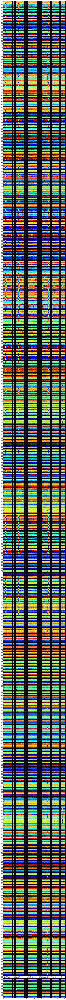

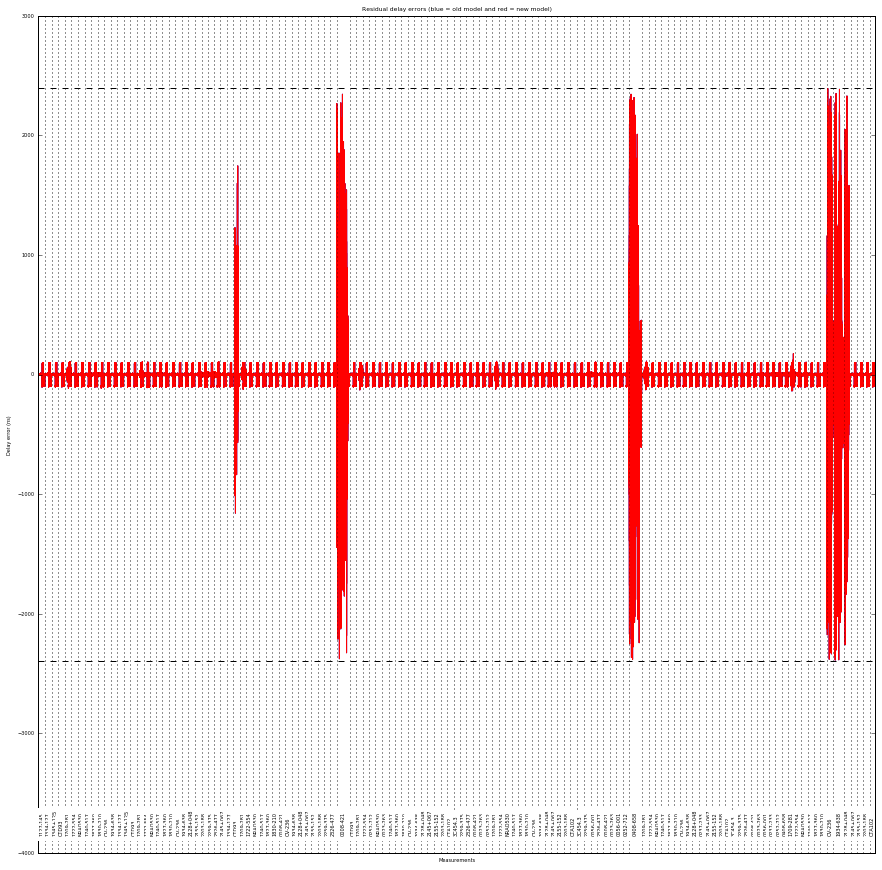

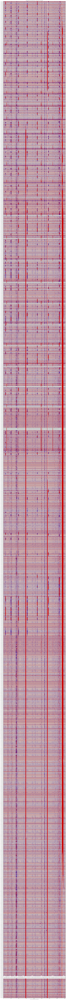

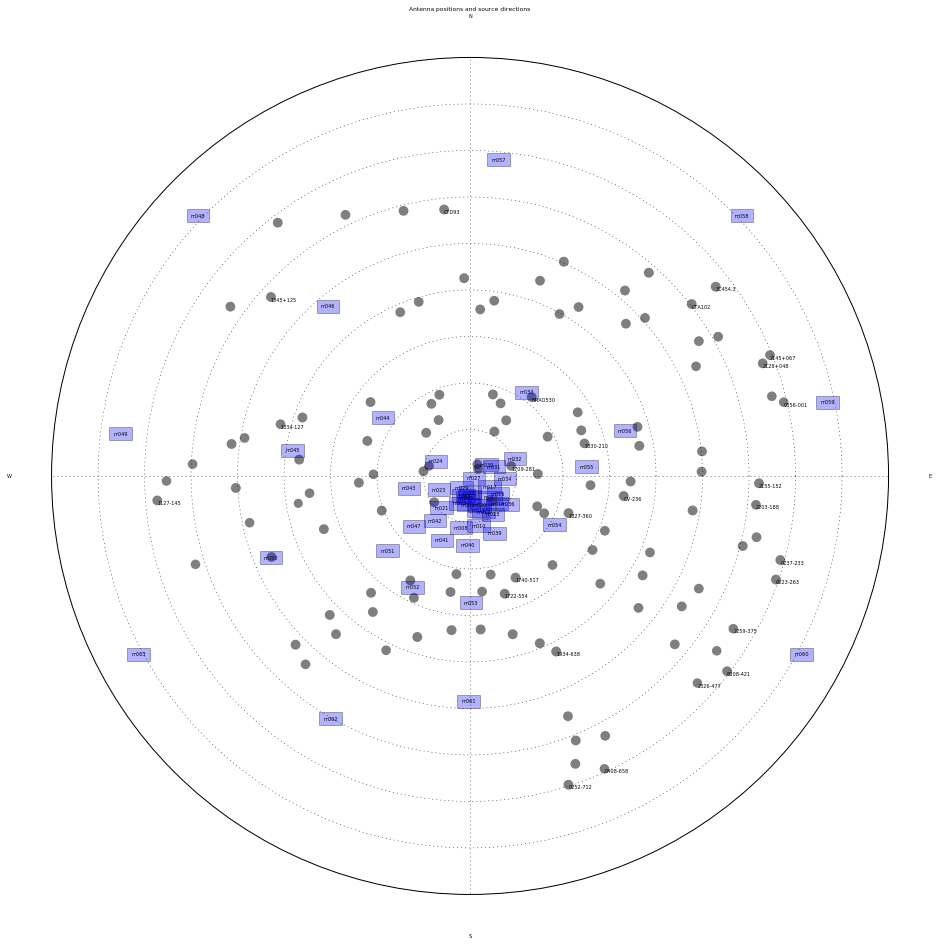

In [10]:
figure(1,figsize=(15,240))
figure(2,figsize=(15,15))
figure(3,figsize=(15,240))
figure(4,figsize=(15,15))
%run /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'H' -r $ref_ant \
 -a $ants $h5_filename


In [ ]:
raw_input("Press enter to continue")

Press enter to continue


''

In [ ]:
figure(1,figsize=(15,240))
figure(2,figsize=(15,15))
figure(3,figsize=(15,240))
figure(4,figsize=(15,15))
%run -e /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'V' -r $ref_ant \
 -a $ants $h5_filename



Loading and processing data...

DEBUG: Found int_time=7.996616972 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1523010668.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
antennas (52): m000, m001, m002, m003, m005 (*ref*), m006, m008, m010, m011, m012, m013, m014, m015, m016, m017, m020, m021, m023, m024, m027, m029, m030, m031, m032, m033, m034, m036, m039, m040, m041, m042, m043, m044, m045, m046, m047, m048, m049, m050, m051, m052, m053, m054, m055, m056, m057, m058, m059, m060, m061, m062, m063 [pol V]
baselines (1326): 0-1 0-2 1-2 0-3 1-3 2-3 0-4 1-4 2-4 3-4 0-5 1-5 2-5 3-5 4-5 0-6 1-6 2-6 3-6 4-6 5-6 0-7 1-7 2-7 3-7 4-7 5-7 6-7 0-8 1-8 2-8 3-8 4-8 5-8 6-8 7-8 0-9 1-9 2-9 3-9 4-9 5-9 6-9 7-9 8-9 0-10 1-10 2

scan   1 (  16 samples) 0.037 0.037 0.039 0.037 0.039 0.038 0.040 0.041 0.040 0.038 0.039 0.039 0.038 0.037 0.038 0.038 0.040 0.040 0.040 0.041 0.038 0.039 0.040 0.040 0.038 0.039 0.037 0.039 0.037 0.037 0.039 0.037 0.040 0.038 0.039 0.039 0.038 0.038 0.038 0.037 0.040 0.040 0.040 0.038 0.038 0.039 0.038 0.040 0.038 0.039 0.040 0.040 0.039 0.038 0.039 0.040 0.039 0.040 0.039 0.041 0.039 0.040 0.040 0.038 0.038 0.040 0.037 0.039 0.036 0.035 0.038 0.037 0.040 0.037 0.037 0.039 0.039 0.038 0.036 0.036 0.037 0.038 0.039 0.036 0.038 0.038 0.036 0.037 0.037 0.039 0.038 0.039 0.041 0.041 0.038 0.040 0.038 0.040 0.039 0.038 0.039 0.040 0.039 0.039 0.039 0.038 0.040 0.040 0.039 0.042 0.038 0.038 0.039 0.038 0.039 0.042 0.041 0.039 0.038 0.042 0.038 0.039 0.038 0.038 0.039 0.037 0.038 0.039 0.037 0.040 0.039 0.039 0.037 0.037 0.039 0.039 0.038 0.038 0.039 0.037 0.038 0.038 0.039 0.037 0.039 0.038 0.039 0.038 0.037 0.037 0.039 0.040 0.039 0.039 0.040 0.039 0.038 0.040 0.039 0.042 0.040 0.039 0.03

scan   5 (  16 samples) 0.037 0.036 0.035 0.035 0.036 0.037 0.035 0.037 0.039 0.037 0.037 0.036 0.036 0.034 0.036 0.036 0.037 0.037 0.036 0.037 0.036 0.036 0.035 0.037 0.034 0.037 0.035 0.037 0.036 0.036 0.035 0.034 0.036 0.036 0.035 0.036 0.034 0.036 0.037 0.036 0.036 0.034 0.035 0.034 0.037 0.037 0.037 0.037 0.036 0.037 0.036 0.037 0.037 0.036 0.036 0.035 0.037 0.036 0.037 0.037 0.037 0.036 0.037 0.036 0.036 0.038 0.036 0.034 0.035 0.034 0.035 0.033 0.037 0.035 0.035 0.036 0.036 0.035 0.034 0.035 0.034 0.034 0.034 0.033 0.036 0.035 0.034 0.033 0.034 0.036 0.033 0.035 0.037 0.036 0.036 0.035 0.037 0.037 0.037 0.036 0.037 0.036 0.037 0.034 0.034 0.036 0.035 0.035 0.037 0.037 0.035 0.037 0.038 0.036 0.038 0.039 0.037 0.034 0.035 0.036 0.035 0.037 0.035 0.035 0.036 0.034 0.036 0.036 0.035 0.035 0.036 0.036 0.035 0.033 0.035 0.036 0.034 0.036 0.036 0.036 0.034 0.034 0.037 0.036 0.034 0.035 0.036 0.036 0.034 0.033 0.035 0.035 0.034 0.035 0.037 0.037 0.035 0.035 0.034 0.036 0.035 0.035 0.03

scan   9 (  16 samples) 0.038 0.037 0.038 0.040 0.039 0.043 0.038 0.039 0.039 0.038 0.037 0.039 0.036 0.038 0.040 0.040 0.041 0.041 0.040 0.041 0.039 0.039 0.041 0.041 0.039 0.041 0.038 0.039 0.038 0.038 0.040 0.038 0.038 0.040 0.038 0.037 0.038 0.039 0.039 0.038 0.041 0.037 0.037 0.037 0.038 0.041 0.043 0.040 0.041 0.043 0.038 0.042 0.037 0.039 0.038 0.040 0.042 0.039 0.040 0.041 0.039 0.040 0.040 0.038 0.037 0.040 0.038 0.039 0.041 0.035 0.040 0.037 0.038 0.038 0.039 0.036 0.037 0.037 0.038 0.038 0.038 0.037 0.037 0.037 0.039 0.038 0.037 0.038 0.038 0.039 0.037 0.038 0.041 0.038 0.039 0.042 0.038 0.041 0.040 0.039 0.039 0.041 0.039 0.037 0.036 0.038 0.039 0.039 0.039 0.039 0.039 0.041 0.038 0.038 0.038 0.041 0.039 0.039 0.036 0.037 0.036 0.038 0.039 0.038 0.038 0.038 0.040 0.041 0.039 0.039 0.042 0.043 0.038 0.037 0.039 0.039 0.038 0.039 0.041 0.037 0.040 0.039 0.043 0.043 0.041 0.041 0.044 0.044 0.039 0.040 0.040 0.041 0.038 0.043 0.043 0.044 0.042 0.045 0.043 0.051 0.054 0.047 0.04

scan  13 (  16 samples) 0.024 0.025 0.025 0.023 0.023 0.024 0.025 0.025 0.026 0.024 0.023 0.024 0.025 0.024 0.025 0.024 0.025 0.025 0.024 0.025 0.024 0.024 0.024 0.024 0.024 0.025 0.024 0.025 0.023 0.024 0.024 0.023 0.025 0.024 0.024 0.024 0.023 0.024 0.024 0.024 0.025 0.024 0.024 0.024 0.024 0.024 0.025 0.025 0.024 0.025 0.024 0.026 0.025 0.025 0.024 0.024 0.025 0.025 0.025 0.026 0.025 0.025 0.025 0.024 0.025 0.026 0.024 0.024 0.024 0.023 0.024 0.023 0.024 0.024 0.024 0.024 0.024 0.023 0.023 0.024 0.024 0.023 0.024 0.023 0.024 0.023 0.023 0.024 0.025 0.025 0.023 0.024 0.025 0.025 0.024 0.025 0.024 0.025 0.025 0.024 0.025 0.025 0.025 0.024 0.024 0.024 0.025 0.024 0.024 0.025 0.024 0.025 0.025 0.024 0.025 0.025 0.026 0.024 0.024 0.025 0.024 0.025 0.025 0.024 0.025 0.024 0.024 0.025 0.024 0.024 0.025 0.025 0.024 0.024 0.025 0.025 0.024 0.024 0.024 0.024 0.025 0.024 0.025 0.024 0.024 0.025 0.025 0.025 0.024 0.024 0.025 0.025 0.024 0.025 0.026 0.027 0.026 0.027 0.026 0.026 0.026 0.026 0.02

scan  17 (  16 samples) 0.036 0.037 0.041 0.029 0.041 0.033 0.039 0.035 0.036 0.032 0.038 0.037 0.037 0.036 0.032 0.043 0.039 0.042 0.043 0.043 0.045 0.044 0.045 0.045 0.044 0.036 0.037 0.033 0.048 0.042 0.040 0.037 0.037 0.038 0.032 0.039 0.046 0.040 0.043 0.038 0.034 0.039 0.030 0.036 0.029 0.038 0.042 0.038 0.040 0.036 0.038 0.034 0.032 0.039 0.036 0.035 0.038 0.043 0.036 0.042 0.041 0.035 0.036 0.033 0.029 0.033 0.038 0.034 0.039 0.034 0.036 0.036 0.038 0.043 0.040 0.039 0.047 0.037 0.037 0.040 0.040 0.041 0.035 0.031 0.037 0.045 0.034 0.042 0.043 0.039 0.030 0.038 0.034 0.030 0.033 0.034 0.040 0.039 0.042 0.042 0.046 0.045 0.040 0.043 0.038 0.039 0.042 0.039 0.040 0.035 0.035 0.038 0.041 0.030 0.043 0.040 0.037 0.034 0.033 0.041 0.035 0.035 0.039 0.036 0.034 0.037 0.038 0.038 0.037 0.040 0.038 0.036 0.038 0.037 0.034 0.041 0.039 0.041 0.035 0.038 0.039 0.038 0.044 0.042 0.041 0.038 0.044 0.041 0.040 0.034 0.037 0.044 0.044 0.040 0.043 0.047 0.044 0.048 0.041 0.046 0.045 0.042 0.04

scan  21 (  16 samples) 0.030 0.031 0.031 0.033 0.031 0.030 0.032 0.032 0.034 0.030 0.032 0.032 0.032 0.029 0.031 0.032 0.033 0.032 0.032 0.033 0.032 0.031 0.033 0.032 0.032 0.033 0.033 0.033 0.031 0.032 0.031 0.030 0.031 0.031 0.032 0.033 0.054 0.033 0.032 0.033 0.032 0.031 0.034 0.033 0.030 0.032 0.034 0.033 0.033 0.034 0.033 0.034 0.033 0.030 0.049 0.032 0.033 0.033 0.032 0.034 0.031 0.033 0.032 0.032 0.035 0.035 0.032 0.031 0.033 0.032 0.033 0.031 0.033 0.031 0.032 0.073 0.034 0.034 0.033 0.033 0.032 0.032 0.032 0.031 0.033 0.031 0.031 0.073 0.037 0.032 0.039 0.032 0.035 0.036 0.033 0.035 0.032 0.034 0.033 0.033 0.036 0.034 0.034 0.031 0.032 0.033 0.033 0.035 0.033 0.035 0.033 0.035 0.032 0.035 0.064 0.034 0.034 0.033 0.035 0.032 0.031 0.031 0.031 0.030 0.032 0.031 0.034 0.032 0.031 0.032 0.033 0.033 0.032 0.032 0.034 0.033 0.032 0.032 0.033 0.032 0.033 0.032 0.032 0.032 0.032 0.032 0.033 0.033 0.032 0.031 0.032 0.033 0.033 0.034 0.035 0.035 0.034 0.036 0.034 0.035 0.034 0.033 0.03

scan  25 (  16 samples) 0.070 0.074 0.077 0.065 0.068 0.071 0.067 0.081 0.074 0.070 0.070 0.069 0.067 0.070 0.073 0.068 0.071 0.071 0.068 0.073 0.068 0.069 0.069 0.071 0.065 0.073 0.069 0.070 0.066 0.075 0.065 0.070 0.065 0.065 0.068 0.068 0.069 0.068 0.070 0.063 0.075 0.066 0.066 0.068 0.076 0.070 0.074 0.071 0.066 0.076 0.073 0.073 0.069 0.074 0.068 0.076 0.076 0.073 0.073 0.071 0.073 0.074 0.076 0.070 0.075 0.080 0.072 0.072 0.067 0.066 0.072 0.069 0.069 0.065 0.066 0.065 0.071 0.082 0.070 0.074 0.070 0.064 0.069 0.071 0.068 0.067 0.069 0.066 0.077 0.086 0.077 0.069 0.077 0.073 0.067 0.072 0.073 0.072 0.070 0.069 0.071 0.074 0.075 0.068 0.077 0.065 0.070 0.072 0.067 0.076 0.071 0.072 0.071 0.066 0.068 0.072 0.077 0.073 0.073 0.076 0.071 0.074 0.068 0.065 0.074 0.063 0.070 0.067 0.068 0.067 0.069 0.073 0.064 0.067 0.071 0.068 0.068 0.071 0.069 0.067 0.071 0.070 0.072 0.070 0.069 0.067 0.072 0.072 0.068 0.069 0.068 0.071 0.068 0.070 0.073 0.073 0.073 0.075 0.073 0.076 0.074 0.074 0.07

scan  29 (  16 samples) 0.038 0.037 0.038 0.035 0.037 0.037 0.039 0.039 0.041 0.038 0.037 0.040 0.038 0.036 0.039 0.038 0.039 0.039 0.038 0.039 0.039 0.036 0.038 0.039 0.038 0.040 0.039 0.037 0.036 0.036 0.038 0.038 0.037 0.037 0.037 0.038 0.036 0.037 0.038 0.037 0.039 0.037 0.040 0.038 0.036 0.038 0.040 0.039 0.039 0.041 0.039 0.039 0.038 0.040 0.038 0.037 0.040 0.038 0.038 0.041 0.038 0.040 0.038 0.040 0.038 0.038 0.037 0.037 0.037 0.038 0.038 0.038 0.036 0.036 0.037 0.037 0.037 0.037 0.036 0.038 0.037 0.036 0.038 0.035 0.038 0.038 0.037 0.036 0.038 0.037 0.036 0.038 0.040 0.038 0.038 0.041 0.039 0.039 0.039 0.039 0.038 0.039 0.038 0.037 0.037 0.038 0.040 0.037 0.038 0.040 0.037 0.041 0.040 0.038 0.038 0.039 0.039 0.038 0.037 0.039 0.037 0.039 0.038 0.036 0.040 0.036 0.039 0.038 0.038 0.037 0.039 0.038 0.038 0.036 0.037 0.038 0.036 0.038 0.038 0.037 0.039 0.037 0.039 0.039 0.037 0.037 0.039 0.038 0.037 0.036 0.038 0.038 0.035 0.037 0.036 0.039 0.037 0.038 0.037 0.039 0.037 0.037 0.03

scan  33 (  15 samples) 0.066 0.064 0.063 0.066 0.057 0.066 0.069 0.074 0.066 0.074 0.063 0.060 0.068 0.068 0.074 0.070 0.061 0.067 0.073 0.066 0.067 0.072 0.072 0.076 0.076 0.069 0.073 0.060 0.059 0.063 0.065 0.063 0.072 0.064 0.062 0.071 0.069 0.076 0.075 0.071 0.073 0.061 0.065 0.059 0.044 0.069 0.068 0.080 0.072 0.069 0.063 0.062 0.061 0.067 0.067 0.068 0.069 0.067 0.069 0.083 0.071 0.080 0.062 0.063 0.060 0.078 0.068 0.073 0.070 0.070 0.071 0.070 0.067 0.070 0.064 0.073 0.063 0.069 0.072 0.065 0.061 0.071 0.064 0.053 0.071 0.068 0.060 0.062 0.066 0.061 0.060 0.069 0.062 0.062 0.070 0.062 0.071 0.066 0.068 0.069 0.070 0.067 0.061 0.070 0.070 0.067 0.072 0.069 0.071 0.073 0.059 0.063 0.070 0.065 0.065 0.064 0.071 0.058 0.063 0.077 0.062 0.064 0.059 0.066 0.067 0.066 0.073 0.073 0.062 0.067 0.066 0.071 0.068 0.068 0.066 0.076 0.070 0.064 0.075 0.067 0.068 0.065 0.070 0.075 0.076 0.089 0.090 0.069 0.065 0.066 0.064 0.076 0.076 0.062 0.079 0.072 0.073 0.083 0.080 0.079 0.083 0.081 0.08

scan  37 (  15 samples) 0.046 0.044 0.035 0.035 0.049 0.041 0.034 0.051 0.040 0.041 0.030 0.052 0.038 0.038 0.038 0.039 0.054 0.047 0.046 0.049 0.041 0.037 0.051 0.041 0.028 0.048 0.044 0.051 0.034 0.055 0.038 0.038 0.038 0.040 0.041 0.039 0.039 0.064 0.051 0.047 0.052 0.043 0.053 0.036 0.035 0.047 0.055 0.050 0.048 0.048 0.050 0.051 0.040 0.036 0.049 0.039 0.054 0.048 0.041 0.046 0.035 0.043 0.033 0.032 0.036 0.040 0.034 0.046 0.040 0.046 0.051 0.047 0.047 0.028 0.044 0.050 0.057 0.040 0.035 0.054 0.040 0.033 0.043 0.033 0.040 0.039 0.041 0.040 0.046 0.034 0.042 0.032 0.061 0.049 0.052 0.046 0.043 0.048 0.044 0.035 0.050 0.059 0.041 0.053 0.047 0.050 0.064 0.051 0.053 0.045 0.060 0.052 0.048 0.046 0.060 0.050 0.045 0.058 0.060 0.070 0.034 0.056 0.052 0.034 0.040 0.051 0.055 0.046 0.046 0.050 0.050 0.043 0.042 0.039 0.049 0.063 0.039 0.066 0.046 0.041 0.051 0.048 0.051 0.035 0.049 0.057 0.047 0.037 0.062 0.044 0.056 0.061 0.048 0.041 0.063 0.060 0.038 0.051 0.039 0.036 0.041 0.047 0.04

scan  41 (  16 samples) 0.020 0.020 0.020 0.022 0.022 0.021 0.023 0.024 0.023 0.020 0.020 0.020 0.022 0.022 0.022 0.021 0.022 0.022 0.021 0.022 0.022 0.021 0.021 0.022 0.021 0.021 0.020 0.023 0.021 0.021 0.022 0.021 0.021 0.021 0.023 0.020 0.022 0.022 0.021 0.021 0.021 0.021 0.022 0.020 0.020 0.021 0.022 0.022 0.022 0.022 0.021 0.022 0.021 0.021 0.021 0.022 0.022 0.022 0.022 0.022 0.021 0.022 0.021 0.020 0.022 0.021 0.022 0.021 0.022 0.021 0.020 0.021 0.022 0.020 0.019 0.021 0.021 0.019 0.020 0.021 0.020 0.021 0.021 0.020 0.022 0.020 0.020 0.019 0.020 0.021 0.021 0.022 0.023 0.023 0.020 0.021 0.022 0.022 0.021 0.021 0.021 0.021 0.021 0.020 0.021 0.021 0.022 0.022 0.022 0.021 0.021 0.021 0.021 0.023 0.022 0.021 0.021 0.021 0.020 0.021 0.022 0.022 0.023 0.020 0.020 0.021 0.022 0.020 0.020 0.021 0.021 0.021 0.020 0.020 0.020 0.021 0.022 0.021 0.022 0.021 0.021 0.020 0.022 0.021 0.020 0.020 0.021 0.021 0.020 0.020 0.021 0.021 0.020 0.022 0.023 0.022 0.022 0.022 0.021 0.023 0.022 0.021 0.02

scan  45 (  15 samples) 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.012 0.012 0.011 0.012 0.012 0.012 0.011 0.012 0.011 0.011 0.012 0.011 0.012 0.011 0.016 0.012 0.012 0.013 0.012 0.012 0.013 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.014 0.012 0.012 0.012 0.012 0.011 0.012 0.011 0.012 0.011 0.011 0.022 0.012 0.012 0.012 0.011 0.012 0.011 0.012 0.011 0.011 0.011 0.011 0.018 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.013 0.013 0.012 0.012 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.017 0.012 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.011 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.011 0.012 0.012 0.012 0.012 0.012 0.013 0.012 0.012 0.012 0.012 0.012 0.012 0.01

scan  49 (  16 samples) 0.045 0.043 0.043 0.041 0.043 0.045 0.043 0.045 0.044 0.044 0.041 0.042 0.043 0.043 0.042 0.044 0.045 0.045 0.043 0.044 0.043 0.042 0.043 0.044 0.043 0.045 0.042 0.045 0.042 0.042 0.044 0.041 0.044 0.042 0.042 0.042 0.042 0.044 0.043 0.043 0.043 0.042 0.045 0.042 0.042 0.044 0.045 0.046 0.043 0.046 0.044 0.045 0.044 0.043 0.044 0.042 0.045 0.047 0.043 0.046 0.043 0.043 0.044 0.042 0.046 0.045 0.041 0.043 0.043 0.042 0.043 0.042 0.044 0.041 0.039 0.042 0.043 0.045 0.041 0.043 0.042 0.041 0.043 0.041 0.041 0.042 0.040 0.041 0.043 0.042 0.041 0.043 0.044 0.043 0.044 0.045 0.043 0.045 0.043 0.043 0.044 0.044 0.045 0.043 0.042 0.043 0.044 0.044 0.045 0.045 0.042 0.045 0.042 0.042 0.043 0.045 0.046 0.043 0.042 0.044 0.042 0.043 0.044 0.042 0.044 0.043 0.042 0.044 0.041 0.043 0.044 0.044 0.041 0.043 0.045 0.044 0.042 0.044 0.042 0.043 0.044 0.043 0.042 0.043 0.042 0.043 0.044 0.044 0.041 0.042 0.043 0.043 0.041 0.043 0.043 0.044 0.043 0.044 0.041 0.044 0.043 0.041 0.04

scan  53 (  15 samples) 0.082 0.076 0.082 0.087 0.082 0.076 0.083 0.084 0.086 0.088 0.075 0.075 0.080 0.082 0.091 0.078 0.076 0.082 0.074 0.077 0.080 0.071 0.081 0.090 0.073 0.091 0.083 0.092 0.084 0.086 0.089 0.092 0.104 0.088 0.090 0.078 0.097 0.089 0.091 0.090 0.106 0.093 0.090 0.075 0.078 0.107 0.096 0.104 0.108 0.115 0.109 0.098 0.088 0.095 0.091 0.098 0.106 0.108 0.114 0.117 0.106 0.099 0.085 0.094 0.088 0.079 0.099 0.109 0.100 0.104 0.102 0.095 0.092 0.081 0.084 0.079 0.080 0.084 0.109 0.105 0.100 0.111 0.107 0.099 0.098 0.082 0.088 0.085 0.079 0.077 0.085 0.091 0.094 0.094 0.098 0.094 0.091 0.093 0.076 0.088 0.080 0.083 0.087 0.079 0.082 0.092 0.092 0.091 0.089 0.101 0.089 0.095 0.074 0.074 0.087 0.096 0.094 0.085 0.092 0.079 0.099 0.097 0.097 0.088 0.093 0.106 0.097 0.117 0.122 0.126 0.134 0.118 0.100 0.086 0.099 0.110 0.105 0.106 0.106 0.108 0.100 0.108 0.089 0.090 0.120 0.120 0.126 0.127 0.130 0.121 0.119 0.124 0.082 0.079 0.100 0.084 0.078 0.097 0.096 0.097 0.088 0.107 0.10

scan  57 (  16 samples) 0.064 0.077 0.066 0.059 0.063 0.064 0.062 0.066 0.061 0.059 0.059 0.062 0.066 0.057 0.059 0.059 0.062 0.068 0.057 0.064 0.061 0.059 0.061 0.065 0.059 0.062 0.057 0.058 0.058 0.063 0.064 0.058 0.060 0.056 0.062 0.058 0.060 0.061 0.065 0.058 0.061 0.060 0.059 0.058 0.058 0.062 0.062 0.068 0.059 0.062 0.061 0.061 0.064 0.060 0.063 0.060 0.062 0.067 0.060 0.062 0.060 0.061 0.058 0.061 0.058 0.065 0.058 0.059 0.065 0.059 0.061 0.058 0.058 0.059 0.061 0.060 0.060 0.058 0.059 0.060 0.063 0.057 0.060 0.059 0.059 0.060 0.059 0.057 0.059 0.059 0.058 0.057 0.061 0.064 0.060 0.061 0.063 0.061 0.062 0.061 0.061 0.062 0.065 0.061 0.059 0.060 0.063 0.065 0.060 0.063 0.062 0.062 0.062 0.060 0.062 0.061 0.063 0.059 0.060 0.061 0.057 0.063 0.062 0.057 0.058 0.057 0.061 0.060 0.061 0.060 0.062 0.060 0.058 0.059 0.059 0.061 0.059 0.061 0.066 0.058 0.061 0.059 0.061 0.060 0.059 0.061 0.062 0.062 0.059 0.058 0.062 0.061 0.059 0.061 0.062 0.066 0.062 0.063 0.061 0.063 0.062 0.061 0.06

scan  61 (  16 samples) 0.039 0.038 0.041 0.036 0.037 0.039 0.038 0.042 0.041 0.040 0.038 0.038 0.040 0.036 0.039 0.040 0.040 0.041 0.040 0.041 0.040 0.038 0.040 0.039 0.039 0.039 0.038 0.040 0.039 0.040 0.039 0.040 0.040 0.038 0.039 0.038 0.040 0.041 0.040 0.041 0.039 0.039 0.039 0.039 0.037 0.039 0.040 0.043 0.039 0.040 0.038 0.041 0.040 0.040 0.038 0.041 0.040 0.042 0.040 0.041 0.040 0.041 0.040 0.038 0.038 0.042 0.038 0.040 0.039 0.037 0.038 0.036 0.040 0.038 0.037 0.038 0.038 0.042 0.038 0.039 0.039 0.039 0.039 0.038 0.039 0.038 0.036 0.037 0.039 0.040 0.040 0.040 0.041 0.042 0.039 0.041 0.038 0.041 0.040 0.038 0.038 0.039 0.042 0.038 0.039 0.040 0.042 0.041 0.038 0.041 0.038 0.041 0.039 0.040 0.040 0.041 0.040 0.038 0.039 0.040 0.040 0.039 0.040 0.040 0.041 0.038 0.040 0.039 0.036 0.038 0.040 0.038 0.038 0.037 0.039 0.039 0.040 0.039 0.041 0.039 0.041 0.039 0.039 0.038 0.037 0.038 0.039 0.039 0.038 0.037 0.039 0.039 0.038 0.043 0.044 0.042 0.044 0.044 0.043 0.043 0.041 0.039 0.04

scan  65 (  16 samples) 0.036 0.036 0.035 0.034 0.038 0.040 0.037 0.037 0.035 0.037 0.033 0.036 0.034 0.035 0.037 0.035 0.037 0.036 0.037 0.036 0.035 0.035 0.036 0.036 0.035 0.037 0.035 0.034 0.035 0.036 0.036 0.033 0.035 0.036 0.036 0.035 0.035 0.036 0.034 0.037 0.035 0.034 0.034 0.034 0.035 0.035 0.037 0.037 0.037 0.037 0.035 0.036 0.036 0.038 0.034 0.036 0.039 0.039 0.034 0.039 0.035 0.039 0.038 0.036 0.038 0.036 0.032 0.035 0.036 0.035 0.037 0.032 0.034 0.034 0.034 0.034 0.035 0.037 0.036 0.035 0.035 0.034 0.034 0.036 0.036 0.035 0.034 0.036 0.035 0.033 0.037 0.037 0.038 0.037 0.034 0.036 0.038 0.037 0.036 0.033 0.035 0.038 0.037 0.037 0.034 0.037 0.036 0.036 0.035 0.037 0.038 0.038 0.036 0.033 0.035 0.039 0.037 0.038 0.034 0.035 0.034 0.038 0.038 0.032 0.036 0.034 0.037 0.036 0.034 0.037 0.036 0.034 0.034 0.034 0.035 0.036 0.037 0.036 0.034 0.035 0.034 0.035 0.036 0.035 0.035 0.035 0.036 0.036 0.036 0.033 0.035 0.035 0.036 0.037 0.038 0.038 0.037 0.039 0.037 0.038 0.037 0.037 0.03

scan  69 (  16 samples) 0.025 0.024 0.027 0.026 0.027 0.027 0.026 0.027 0.027 0.027 0.026 0.026 0.026 0.026 0.027 0.026 0.027 0.027 0.026 0.027 0.026 0.026 0.027 0.026 0.026 0.027 0.025 0.027 0.025 0.025 0.026 0.025 0.026 0.025 0.027 0.026 0.026 0.026 0.026 0.025 0.026 0.026 0.027 0.025 0.025 0.027 0.027 0.027 0.026 0.027 0.026 0.027 0.026 0.026 0.026 0.027 0.027 0.026 0.026 0.027 0.026 0.027 0.027 0.027 0.026 0.026 0.025 0.026 0.026 0.025 0.026 0.024 0.026 0.025 0.024 0.025 0.026 0.027 0.025 0.025 0.025 0.025 0.026 0.025 0.027 0.025 0.024 0.025 0.026 0.026 0.025 0.026 0.027 0.026 0.026 0.027 0.027 0.027 0.027 0.027 0.026 0.027 0.027 0.026 0.026 0.026 0.026 0.026 0.027 0.028 0.026 0.027 0.026 0.026 0.026 0.027 0.027 0.026 0.025 0.027 0.025 0.027 0.026 0.025 0.026 0.026 0.026 0.026 0.025 0.026 0.026 0.027 0.025 0.025 0.026 0.026 0.026 0.026 0.026 0.025 0.027 0.026 0.026 0.026 0.025 0.026 0.026 0.026 0.025 0.026 0.026 0.027 0.026 0.027 0.027 0.027 0.027 0.028 0.027 0.028 0.028 0.027 0.02

scan  73 (  16 samples) 0.019 0.020 0.020 0.020 0.020 0.020 0.019 0.020 0.019 0.020 0.021 0.021 0.021 0.020 0.021 0.020 0.021 0.021 0.020 0.021 0.020 0.020 0.020 0.020 0.020 0.021 0.020 0.020 0.020 0.019 0.021 0.020 0.021 0.020 0.021 0.020 0.020 0.020 0.020 0.020 0.021 0.020 0.020 0.021 0.019 0.020 0.021 0.021 0.020 0.021 0.020 0.020 0.020 0.021 0.021 0.020 0.021 0.021 0.020 0.021 0.021 0.020 0.021 0.020 0.020 0.022 0.019 0.020 0.021 0.020 0.020 0.020 0.020 0.020 0.018 0.018 0.021 0.019 0.019 0.020 0.020 0.019 0.020 0.020 0.020 0.020 0.019 0.019 0.021 0.019 0.018 0.021 0.022 0.022 0.020 0.022 0.020 0.021 0.020 0.020 0.020 0.021 0.020 0.019 0.020 0.020 0.021 0.020 0.020 0.020 0.021 0.021 0.021 0.022 0.021 0.020 0.021 0.021 0.020 0.022 0.020 0.019 0.021 0.019 0.021 0.020 0.020 0.020 0.019 0.020 0.021 0.021 0.020 0.020 0.020 0.021 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.020 0.021 0.020 0.021 0.021 0.022 0.022 0.021 0.021 0.021 0.021 0.021 0.021 0.02

scan  77 (  16 samples) 0.033 0.030 0.032 0.030 0.033 0.033 0.031 0.032 0.031 0.034 0.029 0.031 0.029 0.031 0.030 0.032 0.033 0.032 0.032 0.033 0.032 0.031 0.032 0.032 0.032 0.032 0.032 0.032 0.031 0.030 0.032 0.031 0.031 0.032 0.032 0.030 0.030 0.032 0.032 0.032 0.033 0.031 0.031 0.032 0.033 0.032 0.033 0.033 0.032 0.033 0.032 0.033 0.032 0.031 0.034 0.032 0.032 0.033 0.032 0.033 0.033 0.032 0.031 0.030 0.033 0.032 0.032 0.031 0.032 0.031 0.032 0.032 0.032 0.031 0.030 0.032 0.031 0.030 0.030 0.031 0.030 0.030 0.031 0.030 0.032 0.032 0.031 0.029 0.031 0.032 0.030 0.033 0.032 0.034 0.032 0.035 0.033 0.033 0.032 0.032 0.033 0.033 0.033 0.030 0.032 0.032 0.031 0.032 0.033 0.033 0.033 0.034 0.032 0.028 0.034 0.032 0.031 0.032 0.032 0.033 0.032 0.033 0.032 0.030 0.033 0.031 0.032 0.032 0.031 0.032 0.033 0.032 0.031 0.031 0.032 0.033 0.031 0.031 0.032 0.031 0.032 0.031 0.033 0.032 0.032 0.031 0.033 0.033 0.031 0.031 0.032 0.033 0.031 0.034 0.035 0.034 0.034 0.035 0.033 0.035 0.035 0.033 0.03

scan  81 (  16 samples) 0.044 0.046 0.048 0.043 0.044 0.044 0.048 0.048 0.044 0.045 0.044 0.045 0.047 0.045 0.048 0.044 0.047 0.046 0.045 0.046 0.045 0.045 0.045 0.045 0.042 0.046 0.044 0.046 0.043 0.045 0.043 0.042 0.044 0.044 0.045 0.042 0.043 0.046 0.046 0.044 0.048 0.044 0.044 0.048 0.044 0.046 0.047 0.045 0.043 0.047 0.048 0.046 0.046 0.046 0.047 0.045 0.048 0.045 0.045 0.047 0.047 0.047 0.046 0.044 0.045 0.047 0.044 0.045 0.042 0.042 0.043 0.044 0.045 0.044 0.042 0.046 0.045 0.045 0.042 0.044 0.044 0.041 0.045 0.043 0.045 0.042 0.042 0.044 0.044 0.046 0.042 0.046 0.048 0.046 0.044 0.048 0.044 0.046 0.046 0.046 0.046 0.046 0.048 0.046 0.044 0.045 0.046 0.050 0.045 0.049 0.046 0.046 0.046 0.047 0.045 0.048 0.048 0.047 0.046 0.047 0.044 0.047 0.045 0.044 0.044 0.047 0.046 0.044 0.044 0.045 0.045 0.045 0.045 0.043 0.047 0.045 0.043 0.046 0.045 0.046 0.047 0.045 0.044 0.046 0.045 0.043 0.046 0.046 0.043 0.044 0.048 0.046 0.043 0.045 0.048 0.046 0.045 0.047 0.047 0.046 0.046 0.044 0.04

scan  85 (  15 samples) 0.041 0.040 0.041 0.038 0.040 0.040 0.041 0.042 0.043 0.040 0.040 0.040 0.040 0.040 0.042 0.040 0.041 0.041 0.041 0.042 0.041 0.040 0.042 0.042 0.040 0.041 0.040 0.042 0.040 0.039 0.041 0.038 0.041 0.038 0.040 0.042 0.040 0.040 0.041 0.039 0.041 0.040 0.040 0.040 0.038 0.041 0.041 0.042 0.040 0.042 0.041 0.043 0.041 0.041 0.042 0.040 0.041 0.042 0.041 0.043 0.041 0.042 0.041 0.041 0.041 0.043 0.039 0.039 0.040 0.039 0.040 0.038 0.040 0.040 0.038 0.039 0.040 0.041 0.038 0.040 0.040 0.038 0.040 0.039 0.042 0.039 0.039 0.040 0.040 0.040 0.038 0.040 0.042 0.043 0.039 0.043 0.042 0.043 0.041 0.042 0.042 0.043 0.041 0.041 0.039 0.041 0.042 0.042 0.040 0.042 0.042 0.043 0.041 0.040 0.041 0.043 0.043 0.038 0.040 0.043 0.039 0.040 0.040 0.040 0.042 0.040 0.041 0.041 0.040 0.040 0.041 0.042 0.040 0.040 0.042 0.041 0.040 0.040 0.040 0.039 0.042 0.040 0.040 0.040 0.039 0.040 0.042 0.041 0.039 0.039 0.042 0.041 0.039 0.040 0.040 0.041 0.039 0.041 0.040 0.041 0.041 0.039 0.04

scan  89 (  15 samples) 0.063 0.064 0.068 0.062 0.064 0.065 0.065 0.067 0.066 0.066 0.064 0.069 0.062 0.065 0.062 0.064 0.066 0.065 0.067 0.066 0.065 0.065 0.066 0.064 0.062 0.068 0.063 0.066 0.063 0.061 0.063 0.063 0.066 0.065 0.064 0.063 0.133 0.108 0.065 0.120 0.071 0.087 0.070 0.068 0.070 0.074 0.072 0.070 0.071 0.068 0.070 0.066 0.067 0.063 0.098 0.064 0.068 0.066 0.064 0.067 0.066 0.066 0.066 0.064 0.077 0.069 0.067 0.061 0.061 0.063 0.065 0.063 0.063 0.062 0.061 0.096 0.067 0.063 0.065 0.063 0.064 0.066 0.065 0.068 0.066 0.063 0.065 0.141 0.079 0.066 0.068 0.064 0.065 0.065 0.068 0.067 0.066 0.066 0.066 0.065 0.088 0.069 0.066 0.063 0.067 0.074 0.081 0.066 0.073 0.066 0.068 0.069 0.066 0.062 0.109 0.077 0.073 0.071 0.072 0.071 0.079 0.090 0.066 0.078 0.063 0.064 0.065 0.065 0.063 0.102 0.072 0.066 0.067 0.078 0.071 0.075 0.064 0.065 0.063 0.062 0.066 0.063 0.065 0.062 0.065 0.073 0.066 0.063 0.061 0.063 0.065 0.068 0.068 0.075 0.071 0.072 0.069 0.072 0.073 0.073 0.069 0.068 0.08

scan  93 (  32 samples) 0.042 0.043 0.042 0.532 0.539 0.533 0.042 0.044 0.047 0.539 0.040 0.045 0.043 0.534 0.042 0.041 0.043 0.043 0.530 0.044 0.042 0.040 0.042 0.042 0.535 0.042 0.040 0.042 0.040 0.040 0.042 0.532 0.041 0.043 0.043 0.040 0.042 0.041 0.041 0.535 0.042 0.044 0.042 0.042 0.043 0.042 0.041 0.041 0.536 0.047 0.042 0.043 0.042 0.043 0.041 0.041 0.043 0.043 0.531 0.044 0.041 0.043 0.042 0.043 0.041 0.042 0.039 0.041 0.041 0.532 0.043 0.040 0.041 0.040 0.038 0.040 0.041 0.040 0.041 0.041 0.042 0.532 0.042 0.039 0.041 0.039 0.039 0.040 0.041 0.042 0.039 0.042 0.043 0.044 0.536 0.044 0.041 0.042 0.041 0.041 0.041 0.042 0.042 0.042 0.041 0.045 0.046 0.043 0.536 0.044 0.044 0.044 0.042 0.044 0.047 0.046 0.044 0.041 0.042 0.045 0.040 0.042 0.042 0.530 0.041 0.041 0.041 0.040 0.040 0.041 0.042 0.041 0.040 0.040 0.041 0.044 0.040 0.042 0.043 0.531 0.043 0.043 0.042 0.040 0.041 0.042 0.042 0.041 0.040 0.041 0.042 0.043 0.041 0.044 0.045 0.046 0.536 0.047 0.046 0.047 0.046 0.043 0.04

scan  97 (  16 samples) 0.041 0.042 0.040 0.039 0.037 0.038 0.039 0.042 0.044 0.043 0.039 0.040 0.039 0.038 0.038 0.039 0.040 0.040 0.040 0.041 0.041 0.039 0.042 0.042 0.040 0.042 0.041 0.038 0.040 0.040 0.041 0.039 0.040 0.037 0.038 0.038 0.041 0.040 0.041 0.038 0.042 0.039 0.042 0.040 0.036 0.041 0.042 0.044 0.043 0.043 0.041 0.041 0.039 0.039 0.041 0.042 0.042 0.043 0.041 0.043 0.042 0.041 0.040 0.038 0.038 0.041 0.038 0.039 0.038 0.038 0.039 0.038 0.038 0.038 0.038 0.039 0.039 0.038 0.040 0.040 0.040 0.040 0.041 0.038 0.039 0.040 0.041 0.042 0.041 0.043 0.039 0.041 0.041 0.040 0.041 0.041 0.041 0.041 0.042 0.041 0.038 0.041 0.040 0.039 0.038 0.042 0.040 0.041 0.040 0.043 0.039 0.040 0.041 0.038 0.041 0.041 0.043 0.039 0.051 0.041 0.039 0.041 0.040 0.041 0.042 0.041 0.041 0.042 0.041 0.042 0.044 0.043 0.041 0.041 0.041 0.043 0.041 0.042 0.041 0.040 0.043 0.041 0.044 0.046 0.043 0.044 0.047 0.047 0.042 0.044 0.043 0.044 0.040 0.045 0.047 0.047 0.044 0.048 0.047 0.053 0.055 0.051 0.05

scan 101 (  16 samples) 0.034 0.033 0.035 0.031 0.034 0.033 0.034 0.035 0.034 0.032 0.033 0.033 0.034 0.032 0.032 0.033 0.034 0.034 0.033 0.035 0.034 0.032 0.033 0.034 0.032 0.033 0.031 0.033 0.031 0.033 0.033 0.031 0.033 0.032 0.033 0.033 0.033 0.034 0.034 0.032 0.034 0.033 0.034 0.034 0.032 0.032 0.035 0.034 0.033 0.034 0.033 0.035 0.034 0.033 0.034 0.033 0.033 0.035 0.033 0.034 0.033 0.034 0.034 0.033 0.034 0.034 0.032 0.034 0.032 0.032 0.033 0.033 0.034 0.033 0.032 0.048 0.035 0.035 0.032 0.032 0.034 0.032 0.033 0.031 0.032 0.032 0.033 0.072 0.038 0.033 0.046 0.034 0.033 0.034 0.032 0.034 0.034 0.034 0.035 0.033 0.036 0.035 0.034 0.032 0.034 0.033 0.034 0.034 0.034 0.036 0.034 0.034 0.034 0.034 0.040 0.035 0.035 0.033 0.037 0.035 0.032 0.033 0.032 0.032 0.033 0.033 0.034 0.033 0.032 0.033 0.034 0.034 0.032 0.033 0.033 0.034 0.032 0.032 0.033 0.033 0.034 0.032 0.034 0.033 0.032 0.033 0.034 0.034 0.032 0.032 0.033 0.033 0.032 0.034 0.034 0.034 0.034 0.035 0.034 0.035 0.033 0.035 0.03

scan 105 (  16 samples) 0.022 0.022 0.022 0.022 0.022 0.023 0.022 0.024 0.023 0.022 0.021 0.022 0.023 0.022 0.023 0.022 0.022 0.023 0.022 0.023 0.022 0.023 0.022 0.023 0.021 0.023 0.022 0.022 0.023 0.022 0.021 0.022 0.023 0.022 0.022 0.023 0.046 0.023 0.023 0.024 0.023 0.023 0.023 0.022 0.023 0.023 0.023 0.022 0.023 0.023 0.022 0.024 0.024 0.021 0.025 0.025 0.022 0.023 0.022 0.024 0.023 0.022 0.023 0.022 0.027 0.024 0.024 0.022 0.022 0.021 0.022 0.022 0.022 0.022 0.022 0.029 0.023 0.024 0.024 0.022 0.022 0.021 0.023 0.021 0.022 0.022 0.021 0.040 0.023 0.025 0.024 0.022 0.022 0.023 0.022 0.024 0.022 0.023 0.023 0.022 0.026 0.023 0.023 0.023 0.022 0.038 0.023 0.023 0.025 0.024 0.024 0.022 0.023 0.023 0.057 0.026 0.034 0.025 0.035 0.026 0.023 0.022 0.021 0.022 0.023 0.022 0.022 0.023 0.021 0.028 0.022 0.023 0.022 0.022 0.022 0.026 0.022 0.021 0.022 0.022 0.024 0.021 0.022 0.022 0.021 0.023 0.022 0.022 0.022 0.022 0.023 0.022 0.022 0.022 0.023 0.023 0.022 0.024 0.023 0.023 0.023 0.023 0.02

scan 109 (  16 samples) 0.025 0.025 0.025 0.023 0.024 0.025 0.025 0.026 0.026 0.025 0.024 0.025 0.025 0.024 0.025 0.025 0.025 0.025 0.025 0.026 0.025 0.024 0.025 0.025 0.024 0.026 0.025 0.025 0.024 0.025 0.024 0.024 0.025 0.024 0.025 0.025 0.024 0.025 0.025 0.024 0.025 0.025 0.025 0.025 0.024 0.025 0.026 0.026 0.025 0.027 0.025 0.026 0.025 0.025 0.025 0.025 0.026 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.025 0.026 0.024 0.024 0.024 0.023 0.025 0.024 0.025 0.024 0.024 0.024 0.025 0.025 0.023 0.025 0.024 0.024 0.024 0.024 0.025 0.024 0.024 0.024 0.024 0.025 0.023 0.025 0.026 0.025 0.024 0.026 0.025 0.026 0.025 0.025 0.025 0.026 0.026 0.025 0.025 0.025 0.025 0.026 0.025 0.026 0.025 0.025 0.025 0.025 0.025 0.026 0.026 0.025 0.025 0.026 0.024 0.025 0.025 0.024 0.025 0.024 0.025 0.025 0.024 0.024 0.026 0.025 0.025 0.024 0.025 0.025 0.024 0.025 0.025 0.024 0.026 0.024 0.025 0.024 0.024 0.025 0.026 0.025 0.024 0.024 0.025 0.025 0.025 0.026 0.027 0.027 0.026 0.027 0.026 0.027 0.027 0.026 0.02

scan 113 (  16 samples) 0.034 0.029 0.033 0.032 0.031 0.032 0.032 0.032 0.033 0.030 0.031 0.031 0.030 0.031 0.031 0.032 0.032 0.033 0.031 0.033 0.033 0.031 0.032 0.032 0.031 0.033 0.031 0.033 0.031 0.031 0.032 0.030 0.033 0.032 0.030 0.032 0.030 0.032 0.032 0.031 0.032 0.030 0.034 0.031 0.032 0.031 0.033 0.032 0.032 0.034 0.031 0.034 0.033 0.033 0.032 0.032 0.033 0.033 0.032 0.034 0.033 0.033 0.033 0.031 0.032 0.033 0.030 0.031 0.031 0.031 0.033 0.032 0.032 0.030 0.029 0.030 0.033 0.031 0.030 0.031 0.031 0.030 0.032 0.031 0.032 0.031 0.029 0.031 0.032 0.031 0.028 0.032 0.032 0.034 0.030 0.032 0.032 0.032 0.032 0.031 0.032 0.033 0.033 0.032 0.031 0.033 0.032 0.033 0.031 0.033 0.032 0.032 0.033 0.032 0.034 0.033 0.032 0.031 0.032 0.032 0.031 0.032 0.034 0.032 0.033 0.031 0.032 0.032 0.031 0.032 0.032 0.032 0.031 0.031 0.032 0.032 0.031 0.032 0.032 0.031 0.033 0.031 0.033 0.031 0.032 0.031 0.033 0.033 0.031 0.031 0.033 0.033 0.031 0.033 0.033 0.034 0.033 0.035 0.034 0.035 0.034 0.033 0.03

scan 117 (  15 samples) 0.052 0.049 0.058 0.061 0.063 0.045 0.071 0.083 0.053 0.047 0.056 0.079 0.066 0.065 0.076 0.075 0.089 0.049 0.056 0.060 0.089 0.046 0.053 0.045 0.043 0.045 0.049 0.044 0.046 0.054 0.043 0.044 0.047 0.054 0.046 0.044 0.075 0.096 0.058 0.069 0.075 0.087 0.076 0.051 0.057 0.075 0.070 0.047 0.058 0.063 0.076 0.053 0.045 0.046 0.075 0.076 0.075 0.046 0.058 0.083 0.075 0.057 0.047 0.048 0.076 0.052 0.065 0.070 0.045 0.047 0.061 0.068 0.050 0.044 0.045 0.068 0.055 0.056 0.071 0.066 0.044 0.078 0.089 0.066 0.064 0.045 0.043 0.068 0.052 0.059 0.053 0.067 0.083 0.053 0.072 0.086 0.087 0.071 0.051 0.052 0.094 0.067 0.071 0.058 0.064 0.080 0.090 0.072 0.061 0.089 0.088 0.081 0.060 0.054 0.084 0.074 0.080 0.065 0.076 0.087 0.059 0.089 0.053 0.070 0.073 0.077 0.073 0.046 0.044 0.074 0.078 0.086 0.089 0.080 0.077 0.099 0.078 0.071 0.046 0.047 0.057 0.082 0.046 0.043 0.044 0.081 0.047 0.047 0.043 0.045 0.063 0.063 0.060 0.087 0.090 0.052 0.051 0.066 0.098 0.052 0.050 0.052 0.09

scan 121 (  16 samples) 0.039 0.040 0.040 0.039 0.038 0.041 0.040 0.042 0.040 0.041 0.040 0.041 0.040 0.040 0.041 0.041 0.042 0.041 0.040 0.042 0.042 0.039 0.039 0.041 0.038 0.041 0.040 0.041 0.039 0.039 0.040 0.037 0.039 0.039 0.039 0.039 0.038 0.039 0.041 0.039 0.040 0.040 0.040 0.038 0.038 0.041 0.040 0.041 0.040 0.042 0.040 0.042 0.040 0.040 0.040 0.039 0.041 0.041 0.041 0.042 0.040 0.042 0.040 0.041 0.040 0.041 0.038 0.040 0.040 0.038 0.040 0.038 0.041 0.039 0.039 0.039 0.042 0.040 0.038 0.039 0.039 0.038 0.040 0.038 0.038 0.039 0.037 0.039 0.040 0.039 0.037 0.041 0.042 0.041 0.040 0.041 0.039 0.041 0.041 0.040 0.041 0.042 0.041 0.039 0.038 0.040 0.041 0.041 0.040 0.041 0.040 0.041 0.040 0.038 0.040 0.041 0.042 0.041 0.038 0.041 0.040 0.040 0.040 0.039 0.041 0.039 0.041 0.040 0.039 0.039 0.041 0.041 0.039 0.038 0.041 0.041 0.039 0.041 0.039 0.039 0.040 0.038 0.041 0.039 0.039 0.039 0.041 0.040 0.038 0.039 0.041 0.041 0.039 0.039 0.040 0.041 0.039 0.041 0.039 0.041 0.039 0.038 0.04

scan 125 (  15 samples) 0.028 0.027 0.028 0.026 0.027 0.028 0.027 0.029 0.029 0.027 0.026 0.028 0.029 0.026 0.027 0.027 0.029 0.029 0.028 0.028 0.027 0.028 0.028 0.028 0.027 0.029 0.028 0.028 0.026 0.028 0.028 0.027 0.028 0.027 0.027 0.028 0.028 0.027 0.027 0.027 0.029 0.028 0.028 0.027 0.027 0.029 0.028 0.028 0.027 0.029 0.028 0.028 0.027 0.028 0.027 0.027 0.029 0.028 0.027 0.029 0.027 0.028 0.028 0.027 0.029 0.030 0.027 0.027 0.027 0.027 0.028 0.027 0.027 0.026 0.026 0.026 0.027 0.028 0.026 0.028 0.027 0.026 0.028 0.026 0.027 0.027 0.026 0.027 0.029 0.026 0.026 0.028 0.028 0.028 0.027 0.029 0.028 0.028 0.028 0.029 0.028 0.028 0.029 0.028 0.028 0.028 0.028 0.029 0.028 0.030 0.028 0.028 0.027 0.028 0.027 0.027 0.030 0.027 0.028 0.028 0.027 0.028 0.028 0.027 0.028 0.027 0.028 0.027 0.027 0.027 0.028 0.028 0.027 0.027 0.028 0.028 0.028 0.028 0.027 0.027 0.029 0.027 0.028 0.027 0.027 0.027 0.028 0.029 0.027 0.027 0.028 0.028 0.027 0.028 0.028 0.028 0.028 0.029 0.028 0.029 0.027 0.027 0.02

scan 129 (  16 samples) 0.063 0.065 0.067 0.075 0.063 0.064 0.065 0.064 0.066 0.065 0.086 0.062 0.065 0.064 0.065 0.063 0.065 0.065 0.061 0.068 0.062 0.062 0.063 0.065 0.063 0.066 0.064 0.063 0.065 0.061 0.061 0.062 0.063 0.063 0.062 0.061 0.107 0.065 0.067 0.092 0.065 0.092 0.065 0.062 0.064 0.075 0.066 0.066 0.064 0.069 0.063 0.066 0.065 0.065 0.082 0.063 0.066 0.066 0.065 0.065 0.066 0.066 0.065 0.064 0.064 0.067 0.082 0.066 0.063 0.064 0.065 0.069 0.062 0.062 0.062 0.104 0.074 0.061 0.088 0.062 0.064 0.067 0.064 0.073 0.064 0.062 0.060 0.123 0.085 0.062 0.078 0.069 0.065 0.064 0.064 0.066 0.067 0.066 0.065 0.064 0.090 0.068 0.066 0.066 0.069 0.089 0.068 0.064 0.072 0.068 0.068 0.065 0.065 0.063 0.110 0.074 0.067 0.079 0.087 0.072 0.078 0.063 0.065 0.069 0.067 0.064 0.064 0.062 0.063 0.076 0.064 0.066 0.064 0.064 0.067 0.067 0.063 0.063 0.061 0.063 0.066 0.064 0.063 0.063 0.063 0.064 0.065 0.064 0.061 0.061 0.065 0.065 0.060 0.128 0.074 0.075 0.075 0.075 0.075 0.074 0.072 0.071 0.12

scan 133 (  15 samples) 0.038 0.042 0.041 0.040 0.039 0.039 0.040 0.041 0.041 0.040 0.041 0.039 0.039 0.039 0.039 0.040 0.041 0.040 0.040 0.040 0.040 0.038 0.040 0.038 0.038 0.040 0.038 0.040 0.041 0.038 0.041 0.039 0.038 0.039 0.039 0.039 0.085 0.045 0.042 0.054 0.043 0.050 0.041 0.038 0.047 0.045 0.041 0.040 0.041 0.041 0.041 0.040 0.040 0.038 0.055 0.038 0.040 0.041 0.039 0.040 0.039 0.041 0.039 0.037 0.040 0.040 0.039 0.038 0.038 0.038 0.039 0.038 0.040 0.037 0.037 0.052 0.040 0.038 0.052 0.038 0.039 0.038 0.039 0.038 0.039 0.037 0.040 0.076 0.045 0.037 0.037 0.039 0.040 0.041 0.040 0.040 0.039 0.040 0.039 0.039 0.042 0.040 0.041 0.038 0.038 0.051 0.041 0.040 0.042 0.040 0.040 0.042 0.039 0.041 0.066 0.045 0.040 0.041 0.047 0.041 0.046 0.040 0.040 0.041 0.040 0.039 0.041 0.038 0.039 0.050 0.040 0.039 0.039 0.040 0.039 0.047 0.040 0.039 0.039 0.038 0.039 0.037 0.039 0.039 0.037 0.043 0.040 0.039 0.038 0.038 0.040 0.040 0.039 0.047 0.042 0.043 0.042 0.043 0.041 0.043 0.042 0.041 0.05

scan 137 (  15 samples) 0.032 0.032 0.033 0.030 0.031 0.032 0.033 0.032 0.035 0.032 0.031 0.031 0.032 0.031 0.033 0.031 0.032 0.032 0.032 0.034 0.032 0.032 0.033 0.033 0.032 0.033 0.034 0.032 0.030 0.032 0.032 0.031 0.033 0.031 0.032 0.032 0.031 0.032 0.031 0.031 0.032 0.030 0.032 0.033 0.032 0.032 0.032 0.034 0.032 0.033 0.032 0.033 0.033 0.032 0.033 0.033 0.032 0.033 0.031 0.033 0.033 0.034 0.032 0.033 0.032 0.032 0.031 0.030 0.033 0.030 0.033 0.031 0.032 0.031 0.030 0.031 0.032 0.031 0.031 0.031 0.032 0.030 0.031 0.031 0.032 0.031 0.031 0.031 0.031 0.030 0.029 0.033 0.034 0.034 0.033 0.033 0.033 0.034 0.033 0.032 0.033 0.033 0.033 0.032 0.032 0.032 0.033 0.033 0.033 0.033 0.032 0.032 0.032 0.033 0.032 0.034 0.034 0.032 0.032 0.034 0.032 0.032 0.033 0.032 0.033 0.032 0.032 0.031 0.031 0.032 0.032 0.033 0.032 0.030 0.032 0.032 0.031 0.032 0.033 0.032 0.033 0.032 0.033 0.032 0.031 0.032 0.032 0.032 0.031 0.030 0.032 0.033 0.031 0.031 0.031 0.032 0.032 0.032 0.031 0.031 0.031 0.030 0.03

scan 141 (  16 samples) 0.037 0.036 0.039 0.034 0.037 0.036 0.038 0.035 0.039 0.036 0.036 0.036 0.039 0.035 0.037 0.038 0.037 0.037 0.038 0.037 0.036 0.036 0.036 0.038 0.035 0.037 0.036 0.036 0.035 0.037 0.034 0.034 0.036 0.037 0.038 0.038 0.036 0.036 0.036 0.035 0.036 0.037 0.037 0.036 0.033 0.035 0.039 0.037 0.036 0.038 0.038 0.040 0.038 0.035 0.037 0.037 0.037 0.038 0.036 0.037 0.037 0.037 0.036 0.037 0.038 0.037 0.035 0.036 0.035 0.033 0.036 0.037 0.038 0.037 0.034 0.036 0.036 0.038 0.037 0.036 0.037 0.037 0.036 0.034 0.034 0.035 0.034 0.037 0.038 0.036 0.040 0.036 0.039 0.037 0.038 0.040 0.035 0.037 0.038 0.037 0.038 0.039 0.040 0.037 0.035 0.035 0.037 0.038 0.035 0.036 0.038 0.040 0.038 0.036 0.037 0.038 0.038 0.035 0.040 0.038 0.037 0.036 0.038 0.038 0.039 0.035 0.036 0.036 0.037 0.037 0.037 0.037 0.037 0.035 0.035 0.038 0.037 0.036 0.037 0.037 0.038 0.036 0.037 0.036 0.036 0.036 0.036 0.037 0.036 0.035 0.038 0.038 0.036 0.041 0.041 0.041 0.040 0.040 0.040 0.040 0.040 0.040 0.04

scan 145 (  16 samples) 0.028 0.029 0.028 0.026 0.028 0.027 0.027 0.034 0.028 0.028 0.027 0.027 0.026 0.027 0.028 0.027 0.028 0.028 0.027 0.029 0.027 0.027 0.029 0.028 0.027 0.028 0.027 0.028 0.026 0.027 0.027 0.026 0.028 0.027 0.028 0.027 0.027 0.031 0.027 0.028 0.033 0.027 0.028 0.029 0.026 0.027 0.028 0.028 0.027 0.029 0.028 0.029 0.027 0.027 0.029 0.027 0.028 0.028 0.028 0.030 0.027 0.029 0.029 0.027 0.029 0.029 0.027 0.028 0.027 0.027 0.029 0.026 0.027 0.027 0.026 0.029 0.027 0.028 0.026 0.028 0.026 0.026 0.029 0.026 0.027 0.027 0.026 0.031 0.027 0.028 0.026 0.028 0.030 0.028 0.027 0.033 0.027 0.028 0.028 0.028 0.033 0.029 0.029 0.029 0.029 0.028 0.030 0.029 0.028 0.034 0.028 0.029 0.029 0.027 0.030 0.029 0.030 0.028 0.030 0.031 0.026 0.028 0.027 0.027 0.029 0.026 0.027 0.027 0.027 0.027 0.028 0.027 0.026 0.026 0.028 0.028 0.027 0.027 0.028 0.027 0.028 0.027 0.028 0.027 0.026 0.027 0.028 0.028 0.027 0.027 0.028 0.027 0.027 0.028 0.028 0.029 0.027 0.029 0.028 0.028 0.029 0.027 0.02

scan 149 (  16 samples) 0.025 0.021 0.022 0.019 0.029 0.021 0.028 0.061 0.022 0.024 0.020 0.034 0.020 0.020 0.028 0.021 0.021 0.020 0.020 0.022 0.020 0.022 0.049 0.021 0.020 0.033 0.021 0.019 0.020 0.020 0.020 0.019 0.020 0.021 0.021 0.020 0.019 0.021 0.020 0.019 0.020 0.020 0.020 0.019 0.018 0.021 0.039 0.021 0.021 0.033 0.021 0.021 0.024 0.020 0.021 0.021 0.035 0.021 0.021 0.029 0.021 0.020 0.020 0.021 0.020 0.025 0.020 0.035 0.020 0.020 0.026 0.020 0.020 0.021 0.020 0.020 0.022 0.022 0.020 0.040 0.020 0.020 0.026 0.020 0.020 0.020 0.019 0.019 0.023 0.025 0.022 0.021 0.044 0.020 0.020 0.042 0.022 0.021 0.022 0.022 0.021 0.023 0.023 0.020 0.024 0.028 0.045 0.021 0.025 0.056 0.030 0.020 0.024 0.020 0.020 0.030 0.026 0.026 0.026 0.034 0.022 0.033 0.021 0.020 0.033 0.022 0.020 0.021 0.020 0.020 0.021 0.021 0.019 0.020 0.021 0.027 0.021 0.025 0.021 0.020 0.025 0.020 0.020 0.020 0.020 0.020 0.021 0.021 0.020 0.020 0.021 0.021 0.022 0.022 0.036 0.022 0.022 0.032 0.022 0.022 0.022 0.021 0.02

scan 153 (  16 samples) 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.012 0.011 0.011 0.014 0.011 0.011 0.011 0.011 0.011 0.010 0.011 0.010 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.010 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.010 0.011 0.011 0.011 0.011 0.011 0.011 0.010 0.011 0.011 0.010 0.011 0.010 0.011 0.011 0.010 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.01

scan 157 (  15 samples) 0.053 0.058 0.058 0.058 0.053 0.060 0.057 0.061 0.061 0.059 0.057 0.057 0.055 0.052 0.060 0.056 0.062 0.059 0.058 0.059 0.056 0.060 0.059 0.061 0.056 0.060 0.057 0.057 0.056 0.058 0.056 0.054 0.058 0.054 0.055 0.055 0.056 0.061 0.061 0.058 0.059 0.056 0.057 0.055 0.056 0.058 0.060 0.059 0.059 0.061 0.056 0.060 0.059 0.055 0.056 0.059 0.058 0.058 0.058 0.059 0.057 0.056 0.055 0.053 0.057 0.059 0.055 0.058 0.058 0.054 0.058 0.051 0.054 0.055 0.054 0.056 0.055 0.057 0.055 0.057 0.058 0.054 0.057 0.052 0.054 0.052 0.055 0.055 0.056 0.057 0.050 0.055 0.056 0.061 0.054 0.059 0.055 0.058 0.058 0.054 0.059 0.062 0.059 0.058 0.057 0.058 0.057 0.058 0.057 0.060 0.057 0.056 0.057 0.058 0.059 0.059 0.058 0.059 0.057 0.056 0.061 0.058 0.054 0.057 0.063 0.058 0.059 0.059 0.057 0.055 0.060 0.060 0.057 0.057 0.060 0.060 0.059 0.056 0.056 0.054 0.059 0.057 0.063 0.065 0.060 0.058 0.066 0.057 0.058 0.059 0.059 0.060 0.058 0.068 0.067 0.066 0.064 0.068 0.065 0.067 0.069 0.064 0.06

scan 161 (  16 samples) 0.028 0.026 0.027 0.025 0.028 0.027 0.027 0.029 0.029 0.027 0.026 0.028 0.028 0.026 0.027 0.027 0.028 0.029 0.027 0.029 0.027 0.028 0.028 0.028 0.027 0.029 0.027 0.029 0.027 0.027 0.027 0.027 0.029 0.027 0.027 0.027 0.026 0.028 0.027 0.027 0.027 0.027 0.028 0.028 0.028 0.028 0.028 0.028 0.028 0.029 0.027 0.029 0.029 0.027 0.028 0.028 0.030 0.029 0.028 0.029 0.027 0.029 0.029 0.028 0.029 0.029 0.027 0.027 0.027 0.027 0.028 0.026 0.027 0.027 0.026 0.027 0.028 0.030 0.027 0.026 0.027 0.027 0.027 0.026 0.027 0.027 0.026 0.026 0.028 0.028 0.025 0.027 0.028 0.028 0.027 0.029 0.027 0.029 0.029 0.027 0.028 0.029 0.029 0.028 0.028 0.027 0.029 0.029 0.027 0.029 0.027 0.028 0.028 0.028 0.028 0.029 0.028 0.027 0.027 0.029 0.028 0.027 0.027 0.027 0.028 0.027 0.027 0.028 0.027 0.028 0.028 0.028 0.026 0.026 0.027 0.028 0.028 0.028 0.028 0.028 0.028 0.027 0.028 0.028 0.026 0.028 0.028 0.029 0.026 0.026 0.028 0.028 0.027 0.028 0.029 0.030 0.029 0.029 0.028 0.030 0.030 0.028 0.02

scan 165 (  17 samples) 0.012 0.011 0.012 0.011 0.012 0.011 0.011 0.012 0.012 0.012 0.011 0.011 0.011 0.011 0.012 0.011 0.012 0.012 0.011 0.012 0.011 0.011 0.011 0.012 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.012 0.012 0.011 0.012 0.011 0.012 0.011 0.011 0.011 0.012 0.012 0.011 0.012 0.011 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.012 0.011 0.011 0.012 0.011 0.012 0.011 0.011 0.011 0.012 0.012 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.012 0.012 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.012 0.011 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.012 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.011 0.011 0.012 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.011 0.012 0.012 0.011 0.011 0.012 0.012 0.011 0.012 0.012 0.012 0.012 0.013 0.012 0.012 0.012 0.012 0.01

scan 169 (  16 samples) 0.131 0.068 0.127 0.129 0.092 0.145 0.096 0.092 0.145 0.102 0.091 0.091 0.091 0.087 0.078 0.106 0.106 0.103 0.096 0.099 0.094 0.098 0.099 0.097 0.093 0.097 0.097 0.108 0.094 0.100 0.093 0.091 0.091 0.092 0.098 0.095 0.096 0.098 0.095 0.089 0.084 0.090 0.098 0.095 0.059 0.090 0.093 0.102 0.091 0.094 0.097 0.096 0.098 0.090 0.081 0.095 0.092 0.096 0.086 0.100 0.089 0.102 0.108 0.133 0.095 0.095 0.112 0.089 0.113 0.078 0.093 0.086 0.100 0.100 0.095 0.093 0.097 0.087 0.087 0.092 0.089 0.084 0.094 0.091 0.099 0.103 0.099 0.101 0.096 0.085 0.108 0.094 0.137 0.100 0.106 0.101 0.096 0.106 0.107 0.106 0.098 0.098 0.095 0.096 0.083 0.098 0.094 0.094 0.092 0.106 0.118 0.100 0.102 0.164 0.092 0.096 0.087 0.090 0.090 0.100 0.090 0.097 0.108 0.092 0.095 0.092 0.091 0.092 0.087 0.094 0.090 0.096 0.095 0.087 0.094 0.089 0.092 0.102 0.092 0.091 0.093 0.099 0.099 0.097 0.084 0.091 0.094 0.092 0.091 0.084 0.093 0.100 0.099 0.095 0.101 0.099 0.095 0.103 0.100 0.111 0.106 0.099 0.09

scan 173 (  16 samples) 0.061 0.040 0.041 0.045 0.047 0.038 0.041 0.043 0.043 0.039 0.071 0.086 0.039 0.051 0.039 0.052 0.056 0.041 0.044 0.042 0.061 0.038 0.040 0.039 0.038 0.039 0.037 0.040 0.060 0.062 0.038 0.043 0.039 0.055 0.045 0.039 0.081 0.093 0.040 0.076 0.040 0.076 0.069 0.038 0.064 0.065 0.072 0.041 0.063 0.040 0.072 0.054 0.040 0.053 0.067 0.039 0.040 0.040 0.039 0.041 0.038 0.041 0.039 0.038 0.039 0.040 0.044 0.047 0.039 0.039 0.038 0.047 0.044 0.037 0.044 0.054 0.056 0.038 0.056 0.045 0.039 0.039 0.038 0.062 0.049 0.037 0.059 0.085 0.057 0.039 0.039 0.053 0.062 0.042 0.043 0.040 0.077 0.057 0.039 0.055 0.091 0.074 0.040 0.038 0.044 0.077 0.099 0.041 0.072 0.040 0.072 0.091 0.039 0.059 0.108 0.087 0.040 0.064 0.080 0.103 0.079 0.104 0.039 0.066 0.039 0.081 0.059 0.038 0.060 0.080 0.080 0.039 0.054 0.059 0.083 0.082 0.040 0.042 0.039 0.040 0.039 0.045 0.040 0.038 0.038 0.067 0.042 0.039 0.039 0.037 0.039 0.068 0.062 0.050 0.050 0.048 0.046 0.047 0.046 0.049 0.045 0.046 0.04

scan 177 (  16 samples) 0.125 0.052 0.102 0.050 0.048 0.081 0.090 0.077 0.127 0.081 0.075 0.074 0.076 0.070 0.070 0.075 0.077 0.077 0.074 0.079 0.073 0.073 0.077 0.076 0.072 0.080 0.076 0.075 0.075 0.077 0.075 0.075 0.077 0.078 0.074 0.074 0.073 0.076 0.077 0.072 0.076 0.074 0.074 0.077 0.124 0.079 0.078 0.076 0.077 0.079 0.079 0.073 0.084 0.079 0.101 0.077 0.081 0.076 0.075 0.074 0.070 0.074 0.078 0.099 0.079 0.075 0.097 0.079 0.100 0.071 0.079 0.074 0.074 0.072 0.068 0.074 0.079 0.080 0.072 0.073 0.076 0.074 0.077 0.073 0.075 0.075 0.073 0.072 0.073 0.073 0.180 0.081 0.077 0.080 0.075 0.077 0.077 0.080 0.079 0.080 0.079 0.077 0.080 0.078 0.073 0.079 0.077 0.078 0.076 0.109 0.058 0.081 0.080 0.165 0.081 0.081 0.089 0.082 0.075 0.075 0.076 0.075 0.073 0.076 0.073 0.089 0.075 0.075 0.068 0.077 0.077 0.078 0.073 0.073 0.073 0.076 0.074 0.076 0.078 0.072 0.081 0.074 0.074 0.075 0.074 0.073 0.077 0.074 0.073 0.074 0.079 0.079 0.077 0.076 0.078 0.079 0.074 0.082 0.079 0.082 0.079 0.078 0.08

scan 181 (  31 samples) 0.012 0.013 0.012 0.012 0.013 0.012 0.013 0.014 0.014 0.013 0.012 0.013 0.012 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.012 0.013 0.013 0.013 0.013 0.013 0.013 0.443 0.447 0.440 0.444 0.443 0.443 0.443 0.446 0.444 0.443 0.441 0.445 0.446 0.443 0.446 0.443 0.300 0.446 0.448 0.446 0.446 0.446 0.446 0.447 0.449 0.390 0.399 0.444 0.445 0.446 0.441 0.445 0.445 0.442 0.442 0.381 0.330 0.411 0.012 0.012 0.013 0.012 0.013 0.013 0.013 0.012 0.444 0.442 0.446 0.443 0.013 0.012 0.013 0.012 0.013 0.012 0.013 0.013 0.442 0.445 0.448 0.443 0.012 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.442 0.444 0.445 0.445 0.013 0.012 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.445 0.441 0.444 0.444 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.013 0.012 0.446 0.447 0.448 0.442 0.012 0.012 0.013 0.013 0.012 0.013 0.013 0.012 0.013 0.012 0.013 0.013 0.447 0.448 0.446 0.443 0.013 0.012 0.013 0.013 0.013 0.013 0.014 0.013 0.013 0.013 0.013 0.013 0.013 0.447 0.44

scan 185 (  15 samples) 0.052 0.039 0.051 0.034 0.041 0.034 0.051 0.103 0.071 0.045 0.043 0.052 0.043 0.037 0.053 0.035 0.036 0.040 0.035 0.040 0.037 0.036 0.054 0.048 0.037 0.058 0.046 0.036 0.036 0.037 0.037 0.035 0.040 0.034 0.037 0.034 0.039 0.066 0.058 0.047 0.100 0.050 0.035 0.056 0.035 0.037 0.040 0.040 0.038 0.047 0.037 0.036 0.039 0.039 0.040 0.036 0.039 0.039 0.038 0.046 0.037 0.036 0.037 0.035 0.038 0.038 0.034 0.040 0.036 0.034 0.041 0.037 0.037 0.037 0.034 0.040 0.039 0.037 0.035 0.045 0.042 0.036 0.052 0.038 0.035 0.038 0.038 0.054 0.034 0.037 0.034 0.038 0.067 0.061 0.039 0.094 0.055 0.038 0.047 0.037 0.080 0.042 0.039 0.036 0.036 0.039 0.061 0.051 0.041 0.086 0.049 0.037 0.053 0.036 0.043 0.041 0.038 0.039 0.043 0.066 0.035 0.043 0.040 0.036 0.050 0.039 0.037 0.038 0.034 0.042 0.037 0.036 0.035 0.035 0.038 0.041 0.035 0.036 0.037 0.037 0.038 0.035 0.037 0.038 0.035 0.036 0.037 0.037 0.036 0.035 0.037 0.037 0.035 0.039 0.042 0.042 0.039 0.057 0.041 0.040 0.041 0.039 0.04

scan 189 (  15 samples) 0.027 0.028 0.026 0.024 0.026 0.026 0.026 0.028 0.028 0.027 0.025 0.028 0.027 0.025 0.026 0.025 0.026 0.027 0.026 0.028 0.027 0.026 0.026 0.026 0.026 0.027 0.026 0.026 0.025 0.026 0.026 0.025 0.027 0.025 0.027 0.025 0.025 0.027 0.026 0.026 0.026 0.026 0.027 0.025 0.026 0.026 0.027 0.027 0.026 0.028 0.027 0.027 0.026 0.026 0.028 0.027 0.027 0.027 0.026 0.027 0.028 0.027 0.027 0.026 0.027 0.029 0.025 0.026 0.026 0.025 0.026 0.026 0.027 0.025 0.025 0.026 0.026 0.027 0.025 0.027 0.026 0.025 0.026 0.026 0.026 0.025 0.024 0.026 0.026 0.027 0.026 0.026 0.028 0.027 0.026 0.027 0.026 0.027 0.027 0.026 0.027 0.028 0.028 0.026 0.026 0.025 0.028 0.027 0.026 0.027 0.027 0.027 0.027 0.026 0.028 0.028 0.027 0.027 0.026 0.027 0.026 0.027 0.027 0.026 0.027 0.029 0.026 0.026 0.025 0.027 0.027 0.027 0.026 0.026 0.026 0.026 0.026 0.026 0.027 0.025 0.027 0.026 0.026 0.026 0.025 0.026 0.026 0.027 0.026 0.026 0.026 0.027 0.026 0.028 0.030 0.030 0.028 0.030 0.030 0.029 0.029 0.029 0.02

scan 193 (  15 samples) 0.046 0.022 0.021 0.024 0.042 0.021 0.044 0.079 0.021 0.043 0.021 0.022 0.019 0.021 0.024 0.025 0.042 0.021 0.023 0.043 0.020 0.020 0.023 0.021 0.021 0.022 0.020 0.022 0.020 0.021 0.020 0.020 0.022 0.020 0.020 0.022 0.020 0.021 0.021 0.020 0.022 0.022 0.020 0.022 0.019 0.022 0.025 0.021 0.021 0.025 0.021 0.022 0.021 0.020 0.021 0.027 0.056 0.021 0.024 0.057 0.022 0.022 0.021 0.020 0.021 0.020 0.023 0.029 0.020 0.021 0.033 0.020 0.019 0.020 0.019 0.019 0.022 0.023 0.025 0.066 0.020 0.021 0.058 0.020 0.021 0.019 0.020 0.021 0.020 0.022 0.023 0.030 0.072 0.022 0.026 0.074 0.023 0.022 0.022 0.021 0.022 0.022 0.023 0.023 0.025 0.036 0.049 0.023 0.045 0.068 0.026 0.039 0.023 0.023 0.027 0.026 0.046 0.030 0.055 0.072 0.021 0.030 0.021 0.020 0.036 0.021 0.022 0.020 0.021 0.022 0.021 0.021 0.020 0.020 0.022 0.028 0.024 0.060 0.021 0.025 0.051 0.021 0.022 0.021 0.020 0.021 0.022 0.021 0.021 0.020 0.021 0.057 0.028 0.026 0.050 0.024 0.025 0.037 0.024 0.025 0.024 0.024 0.02

scan 197 (  15 samples) 0.013 0.015 0.014 0.013 0.014 0.014 0.014 0.015 0.015 0.014 0.013 0.014 0.014 0.013 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.013 0.014 0.014 0.013 0.014 0.013 0.014 0.013 0.013 0.014 0.013 0.014 0.013 0.014 0.014 0.014 0.014 0.014 0.013 0.014 0.013 0.014 0.014 0.013 0.014 0.014 0.015 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.013 0.014 0.014 0.013 0.014 0.013 0.014 0.013 0.013 0.013 0.014 0.014 0.013 0.014 0.013 0.013 0.014 0.013 0.013 0.013 0.013 0.014 0.014 0.014 0.014 0.014 0.015 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.013 0.015 0.014 0.014 0.014 0.013 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.014 0.013 0.014 0.013 0.014 0.014 0.013 0.014 0.014 0.014 0.013 0.013 0.014 0.014 0.013 0.014 0.014 0.013 0.014 0.013 0.014 0.014 0.013 0.014 0.014 0.014 0.013 0.013 0.014 0.014 0.014 0.015 0.015 0.015 0.014 0.015 0.014 0.015 0.015 0.014 0.01

scan 201 (  16 samples) 0.032 0.033 0.033 0.032 0.031 0.033 0.032 0.033 0.033 0.031 0.031 0.032 0.033 0.032 0.032 0.032 0.033 0.033 0.032 0.034 0.032 0.032 0.032 0.033 0.032 0.032 0.031 0.033 0.032 0.032 0.033 0.032 0.031 0.031 0.032 0.031 0.057 0.033 0.033 0.034 0.032 0.032 0.032 0.031 0.031 0.034 0.033 0.034 0.032 0.033 0.031 0.033 0.031 0.031 0.033 0.033 0.033 0.034 0.032 0.033 0.031 0.033 0.032 0.030 0.034 0.033 0.034 0.031 0.033 0.032 0.032 0.029 0.031 0.030 0.030 0.039 0.032 0.031 0.033 0.032 0.032 0.031 0.031 0.029 0.031 0.031 0.029 0.051 0.032 0.031 0.032 0.033 0.032 0.033 0.032 0.032 0.030 0.034 0.032 0.031 0.038 0.033 0.032 0.031 0.032 0.038 0.033 0.033 0.033 0.032 0.032 0.033 0.032 0.031 0.052 0.032 0.033 0.033 0.033 0.033 0.032 0.031 0.032 0.031 0.031 0.031 0.032 0.031 0.031 0.036 0.031 0.032 0.031 0.031 0.032 0.033 0.032 0.032 0.032 0.031 0.031 0.030 0.032 0.031 0.030 0.031 0.032 0.031 0.030 0.030 0.032 0.031 0.031 0.035 0.035 0.035 0.033 0.034 0.034 0.034 0.033 0.033 0.03

scan 205 (  16 samples) 0.039 0.039 0.040 0.040 0.038 0.039 0.040 0.040 0.042 0.038 0.038 0.039 0.040 0.037 0.039 0.039 0.039 0.040 0.039 0.042 0.039 0.039 0.040 0.039 0.038 0.040 0.039 0.040 0.038 0.038 0.038 0.037 0.040 0.039 0.039 0.037 0.037 0.040 0.038 0.038 0.041 0.038 0.040 0.038 0.038 0.039 0.041 0.041 0.039 0.042 0.040 0.041 0.041 0.039 0.039 0.038 0.040 0.040 0.039 0.041 0.041 0.041 0.041 0.039 0.039 0.039 0.037 0.039 0.039 0.037 0.039 0.038 0.039 0.039 0.036 0.039 0.039 0.039 0.037 0.038 0.038 0.037 0.039 0.037 0.039 0.039 0.037 0.038 0.038 0.038 0.035 0.038 0.041 0.041 0.039 0.041 0.040 0.042 0.041 0.040 0.040 0.040 0.040 0.040 0.039 0.039 0.041 0.040 0.038 0.041 0.039 0.040 0.039 0.039 0.039 0.041 0.040 0.039 0.039 0.040 0.039 0.038 0.040 0.038 0.041 0.039 0.038 0.039 0.038 0.039 0.041 0.040 0.039 0.038 0.040 0.040 0.038 0.039 0.039 0.038 0.041 0.038 0.040 0.040 0.039 0.039 0.041 0.040 0.038 0.038 0.040 0.039 0.039 0.040 0.042 0.041 0.041 0.043 0.041 0.042 0.041 0.040 0.04

scan 209 (  15 samples) 0.046 0.057 0.044 0.042 0.070 0.078 0.073 0.056 0.056 0.058 0.064 0.059 0.053 0.064 0.043 0.060 0.045 0.053 0.055 0.061 0.066 0.074 0.072 0.064 0.057 0.063 0.057 0.061 0.044 0.065 0.046 0.055 0.076 0.087 0.067 0.061 0.062 0.051 0.045 0.075 0.057 0.045 0.063 0.055 0.051 0.095 0.056 0.047 0.069 0.052 0.048 0.044 0.057 0.075 0.049 0.051 0.067 0.062 0.056 0.073 0.071 0.055 0.055 0.055 0.066 0.078 0.049 0.053 0.060 0.067 0.063 0.054 0.055 0.047 0.070 0.057 0.063 0.040 0.056 0.071 0.075 0.057 0.057 0.059 0.057 0.054 0.059 0.065 0.065 0.062 0.062 0.059 0.066 0.068 0.063 0.063 0.055 0.056 0.055 0.058 0.068 0.065 0.059 0.062 0.028 0.089 0.056 0.047 0.071 0.044 0.046 0.045 0.058 0.075 0.041 0.029 0.077 0.062 0.062 0.066 0.056 0.055 0.065 0.064 0.064 0.065 0.073 0.053 0.064 0.059 0.064 0.046 0.052 0.053 0.054 0.065 0.062 0.062 0.054 0.057 0.053 0.056 0.068 0.075 0.057 0.062 0.072 0.066 0.065 0.053 0.050 0.069 0.061 0.062 0.074 0.077 0.060 0.078 0.068 0.055 0.059 0.058 0.06

scan 213 (  15 samples) 0.061 0.062 0.062 0.057 0.059 0.062 0.061 0.061 0.064 0.061 0.058 0.062 0.061 0.059 0.063 0.062 0.064 0.064 0.060 0.064 0.062 0.061 0.062 0.063 0.058 0.063 0.062 0.062 0.059 0.061 0.062 0.059 0.061 0.059 0.061 0.059 0.060 0.062 0.063 0.058 0.064 0.061 0.062 0.059 0.059 0.062 0.061 0.063 0.061 0.064 0.063 0.063 0.061 0.061 0.061 0.061 0.062 0.065 0.061 0.063 0.062 0.063 0.065 0.063 0.063 0.064 0.058 0.061 0.063 0.058 0.060 0.060 0.060 0.060 0.060 0.061 0.062 0.059 0.057 0.058 0.059 0.057 0.060 0.059 0.059 0.060 0.061 0.062 0.062 0.058 0.056 0.060 0.066 0.067 0.061 0.066 0.061 0.062 0.064 0.062 0.062 0.066 0.064 0.062 0.062 0.064 0.062 0.062 0.061 0.061 0.062 0.064 0.063 0.062 0.061 0.064 0.062 0.061 0.060 0.066 0.058 0.060 0.064 0.060 0.061 0.062 0.062 0.061 0.061 0.062 0.062 0.062 0.059 0.058 0.062 0.063 0.060 0.061 0.063 0.058 0.065 0.060 0.063 0.062 0.060 0.062 0.064 0.063 0.059 0.059 0.063 0.063 0.059 0.064 0.065 0.066 0.064 0.067 0.064 0.065 0.065 0.064 0.06

scan 217 (  15 samples) 0.036 0.038 0.038 0.035 0.037 0.037 0.038 0.039 0.039 0.039 0.036 0.037 0.036 0.036 0.038 0.037 0.038 0.038 0.036 0.039 0.035 0.038 0.038 0.037 0.037 0.038 0.036 0.037 0.035 0.037 0.037 0.036 0.037 0.036 0.037 0.036 0.037 0.037 0.038 0.036 0.038 0.035 0.037 0.036 0.036 0.037 0.038 0.038 0.037 0.038 0.038 0.039 0.038 0.037 0.037 0.037 0.039 0.038 0.037 0.039 0.037 0.039 0.039 0.037 0.038 0.040 0.035 0.037 0.037 0.036 0.036 0.035 0.037 0.037 0.035 0.036 0.038 0.038 0.035 0.038 0.037 0.035 0.037 0.036 0.037 0.037 0.036 0.038 0.038 0.037 0.035 0.037 0.038 0.040 0.037 0.038 0.038 0.039 0.038 0.037 0.038 0.039 0.039 0.037 0.036 0.037 0.039 0.039 0.035 0.039 0.037 0.038 0.038 0.037 0.039 0.039 0.040 0.037 0.036 0.039 0.036 0.038 0.038 0.036 0.039 0.036 0.038 0.037 0.036 0.036 0.038 0.038 0.036 0.036 0.038 0.037 0.036 0.038 0.038 0.036 0.039 0.036 0.038 0.037 0.036 0.037 0.037 0.038 0.036 0.035 0.038 0.037 0.038 0.038 0.040 0.040 0.038 0.040 0.038 0.040 0.039 0.038 0.03

scan 221 (  15 samples) 0.074 0.058 0.099 0.070 0.076 0.161 0.073 0.072 0.078 0.068 0.072 0.071 0.066 0.063 0.070 0.071 0.074 0.074 0.072 0.076 0.069 0.068 0.071 0.074 0.067 0.071 0.071 0.071 0.069 0.073 0.070 0.068 0.075 0.071 0.067 0.071 0.070 0.073 0.070 0.069 0.072 0.072 0.067 0.069 0.073 0.069 0.072 0.071 0.069 0.073 0.072 0.070 0.074 0.075 0.088 0.073 0.073 0.072 0.072 0.073 0.071 0.069 0.072 0.072 0.076 0.073 0.063 0.070 0.072 0.064 0.070 0.070 0.068 0.072 0.067 0.068 0.072 0.066 0.068 0.074 0.071 0.066 0.071 0.065 0.066 0.069 0.068 0.066 0.071 0.066 0.091 0.071 0.075 0.075 0.074 0.073 0.071 0.076 0.073 0.068 0.073 0.076 0.075 0.072 0.074 0.074 0.071 0.074 0.073 0.076 0.106 0.073 0.069 0.086 0.079 0.074 0.068 0.072 0.067 0.073 0.069 0.069 0.068 0.071 0.070 0.068 0.070 0.069 0.067 0.069 0.067 0.071 0.070 0.067 0.070 0.072 0.069 0.072 0.073 0.068 0.073 0.069 0.070 0.071 0.066 0.068 0.070 0.072 0.067 0.068 0.070 0.071 0.071 0.075 0.073 0.073 0.070 0.075 0.074 0.079 0.074 0.074 0.07

scan 225 (  16 samples) 0.047 0.040 0.041 0.037 0.039 0.043 0.044 0.050 0.045 0.036 0.039 0.042 0.045 0.036 0.045 0.047 0.047 0.045 0.042 0.046 0.048 0.047 0.044 0.045 0.042 0.048 0.047 0.050 0.042 0.042 0.042 0.039 0.052 0.043 0.041 0.047 0.043 0.044 0.049 0.044 0.050 0.046 0.047 0.040 0.039 0.042 0.045 0.048 0.047 0.049 0.048 0.053 0.048 0.045 0.046 0.051 0.046 0.047 0.045 0.051 0.055 0.053 0.043 0.055 0.044 0.047 0.044 0.051 0.050 0.048 0.050 0.046 0.044 0.039 0.045 0.040 0.047 0.041 0.052 0.056 0.049 0.048 0.054 0.053 0.046 0.043 0.044 0.040 0.041 0.044 0.042 0.052 0.054 0.045 0.054 0.049 0.047 0.046 0.048 0.045 0.043 0.048 0.048 0.047 0.044 0.047 0.044 0.042 0.047 0.050 0.045 0.049 0.044 0.049 0.044 0.045 0.047 0.048 0.054 0.044 0.049 0.050 0.047 0.043 0.049 0.049 0.048 0.047 0.050 0.047 0.052 0.052 0.049 0.048 0.047 0.053 0.051 0.052 0.044 0.044 0.045 0.044 0.048 0.049 0.046 0.049 0.057 0.051 0.052 0.054 0.056 0.048 0.047 0.043 0.047 0.047 0.048 0.046 0.043 0.050 0.051 0.044 0.05

scan 229 (  16 samples) 0.056 0.048 0.045 0.047 0.046 0.046 0.048 0.053 0.048 0.046 0.046 0.050 0.050 0.045 0.049 0.051 0.045 0.049 0.048 0.049 0.046 0.053 0.052 0.053 0.055 0.053 0.050 0.047 0.048 0.050 0.051 0.049 0.048 0.050 0.048 0.047 0.051 0.051 0.050 0.050 0.053 0.051 0.049 0.050 0.045 0.058 0.054 0.057 0.057 0.057 0.053 0.058 0.055 0.051 0.050 0.056 0.055 0.056 0.058 0.056 0.054 0.054 0.049 0.048 0.047 0.050 0.050 0.051 0.048 0.052 0.056 0.058 0.047 0.049 0.050 0.048 0.046 0.048 0.051 0.053 0.052 0.054 0.052 0.051 0.051 0.047 0.048 0.046 0.053 0.049 0.048 0.056 0.053 0.049 0.054 0.055 0.050 0.047 0.047 0.054 0.052 0.049 0.054 0.049 0.051 0.048 0.053 0.055 0.053 0.054 0.049 0.054 0.050 0.044 0.047 0.052 0.049 0.053 0.053 0.058 0.050 0.051 0.052 0.051 0.055 0.054 0.056 0.057 0.055 0.056 0.056 0.055 0.054 0.053 0.050 0.054 0.055 0.051 0.055 0.054 0.054 0.056 0.055 0.061 0.057 0.054 0.060 0.053 0.051 0.055 0.055 0.057 0.044 0.060 0.058 0.059 0.056 0.056 0.059 0.059 0.061 0.063 0.06

scan 233 (  15 samples) 0.057 0.032 0.060 0.059 0.049 0.059 0.079 0.056 0.099 0.060 0.054 0.059 0.063 0.069 0.062 0.071 0.071 0.063 0.080 0.069 0.070 0.091 0.086 0.090 0.080 0.088 0.090 0.064 0.061 0.070 0.064 0.079 0.064 0.059 0.059 0.065 0.060 0.066 0.073 0.075 0.066 0.062 0.042 0.060 0.053 0.075 0.072 0.078 0.067 0.075 0.078 0.065 0.077 0.061 0.057 0.072 0.100 0.079 0.084 0.079 0.074 0.058 0.060 0.059 0.065 0.061 0.070 0.081 0.077 0.080 0.075 0.059 0.069 0.076 0.063 0.060 0.072 0.065 0.055 0.067 0.061 0.066 0.061 0.064 0.058 0.074 0.038 0.059 0.054 0.062 0.057 0.067 0.062 0.066 0.056 0.056 0.057 0.067 0.090 0.064 0.059 0.069 0.064 0.061 0.053 0.067 0.070 0.069 0.069 0.059 0.058 0.063 0.076 0.061 0.059 0.062 0.065 0.030 0.059 0.056 0.060 0.066 0.062 0.060 0.064 0.071 0.074 0.073 0.066 0.071 0.055 0.073 0.087 0.063 0.070 0.070 0.074 0.084 0.084 0.077 0.092 0.090 0.066 0.064 0.065 0.057 0.056 0.058 0.076 0.056 0.072 0.063 0.073 0.067 0.054 0.054 0.049 0.055 0.076 0.056 0.077 0.048 0.04

scan 237 (  15 samples) 0.025 0.025 0.027 0.024 0.025 0.026 0.025 0.026 0.026 0.025 0.025 0.025 0.025 0.024 0.025 0.025 0.026 0.026 0.025 0.026 0.025 0.025 0.026 0.026 0.024 0.026 0.025 0.025 0.024 0.025 0.025 0.024 0.025 0.024 0.025 0.025 0.025 0.025 0.026 0.024 0.026 0.025 0.026 0.025 0.024 0.025 0.026 0.026 0.025 0.026 0.026 0.026 0.026 0.025 0.026 0.026 0.026 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.026 0.027 0.025 0.025 0.025 0.024 0.025 0.024 0.025 0.025 0.024 0.024 0.025 0.025 0.024 0.025 0.025 0.024 0.025 0.024 0.025 0.024 0.024 0.024 0.025 0.025 0.024 0.025 0.026 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.026 0.027 0.026 0.025 0.025 0.025 0.026 0.026 0.025 0.026 0.025 0.026 0.026 0.025 0.026 0.027 0.026 0.025 0.025 0.026 0.024 0.025 0.025 0.025 0.026 0.025 0.025 0.025 0.025 0.025 0.026 0.025 0.024 0.025 0.026 0.026 0.025 0.025 0.026 0.025 0.025 0.025 0.026 0.025 0.024 0.025 0.026 0.026 0.024 0.024 0.026 0.025 0.025 0.024 0.025 0.025 0.024 0.025 0.024 0.025 0.025 0.024 0.02

scan 241 (  16 samples) 0.034 0.093 0.091 0.091 0.091 0.086 0.032 0.033 0.091 0.091 0.031 0.030 0.092 0.091 0.034 0.212 0.212 0.214 0.213 0.216 0.212 0.032 0.033 0.093 0.091 0.033 0.032 0.211 0.030 0.032 0.092 0.090 0.033 0.031 0.211 0.031 0.033 0.032 0.093 0.093 0.032 0.032 0.214 0.033 0.031 0.033 0.034 0.093 0.091 0.033 0.033 0.216 0.031 0.032 0.033 0.032 0.033 0.093 0.092 0.034 0.031 0.211 0.033 0.031 0.034 0.033 0.031 0.032 0.091 0.090 0.033 0.032 0.213 0.031 0.032 0.030 0.031 0.033 0.030 0.031 0.092 0.091 0.032 0.030 0.215 0.031 0.030 0.031 0.033 0.031 0.031 0.032 0.032 0.093 0.093 0.033 0.032 0.214 0.033 0.032 0.032 0.034 0.032 0.033 0.030 0.034 0.032 0.090 0.088 0.032 0.031 0.212 0.032 0.035 0.032 0.034 0.033 0.032 0.031 0.031 0.032 0.032 0.092 0.091 0.031 0.032 0.214 0.032 0.032 0.032 0.032 0.033 0.032 0.031 0.033 0.033 0.031 0.034 0.093 0.090 0.032 0.031 0.213 0.032 0.031 0.033 0.033 0.033 0.032 0.031 0.033 0.032 0.031 0.032 0.033 0.092 0.090 0.033 0.031 0.212 0.033 0.032 0.03

scan 245 (  16 samples) 0.044 0.048 0.045 0.047 0.042 0.045 0.045 0.045 0.048 0.045 0.044 0.044 0.045 0.045 0.050 0.044 0.045 0.045 0.044 0.047 0.044 0.042 0.046 0.045 0.043 0.045 0.044 0.044 0.044 0.046 0.043 0.041 0.047 0.044 0.043 0.043 0.043 0.043 0.045 0.044 0.044 0.043 0.045 0.045 0.046 0.045 0.045 0.047 0.046 0.047 0.044 0.047 0.047 0.048 0.043 0.046 0.046 0.047 0.046 0.046 0.044 0.045 0.046 0.047 0.046 0.045 0.043 0.044 0.045 0.044 0.045 0.040 0.043 0.043 0.043 0.041 0.044 0.042 0.043 0.044 0.044 0.042 0.045 0.042 0.043 0.042 0.041 0.044 0.045 0.044 0.045 0.045 0.047 0.046 0.043 0.045 0.046 0.047 0.044 0.044 0.045 0.046 0.046 0.046 0.043 0.044 0.047 0.047 0.042 0.046 0.048 0.045 0.043 0.042 0.048 0.049 0.046 0.047 0.043 0.044 0.044 0.045 0.045 0.044 0.047 0.041 0.044 0.044 0.043 0.043 0.045 0.045 0.042 0.043 0.046 0.047 0.045 0.045 0.046 0.044 0.043 0.043 0.046 0.045 0.044 0.044 0.045 0.045 0.042 0.043 0.045 0.045 0.044 0.044 0.045 0.044 0.042 0.046 0.043 0.045 0.044 0.044 0.04

scan 249 (  15 samples) 0.039 0.037 0.039 0.039 0.038 0.039 0.039 0.040 0.040 0.038 0.037 0.037 0.037 0.036 0.039 0.039 0.039 0.039 0.038 0.041 0.038 0.039 0.039 0.038 0.036 0.038 0.037 0.039 0.035 0.038 0.039 0.036 0.039 0.037 0.038 0.037 0.036 0.038 0.039 0.039 0.039 0.037 0.038 0.040 0.037 0.040 0.040 0.039 0.037 0.041 0.038 0.040 0.039 0.039 0.038 0.038 0.040 0.040 0.039 0.041 0.038 0.040 0.039 0.038 0.039 0.040 0.036 0.037 0.038 0.036 0.039 0.037 0.038 0.038 0.037 0.036 0.038 0.038 0.036 0.037 0.037 0.036 0.038 0.037 0.038 0.038 0.036 0.036 0.038 0.038 0.034 0.039 0.039 0.040 0.038 0.041 0.038 0.039 0.039 0.039 0.038 0.039 0.040 0.037 0.038 0.038 0.038 0.037 0.038 0.041 0.039 0.038 0.038 0.039 0.037 0.041 0.040 0.037 0.037 0.040 0.037 0.039 0.039 0.037 0.039 0.037 0.038 0.039 0.037 0.038 0.039 0.039 0.038 0.038 0.039 0.039 0.037 0.039 0.039 0.037 0.039 0.038 0.039 0.039 0.037 0.038 0.039 0.039 0.038 0.037 0.040 0.039 0.038 0.039 0.041 0.040 0.038 0.041 0.038 0.040 0.039 0.038 0.03

scan 253 (  14 samples) 0.024 0.026 0.027 0.024 0.024 0.027 0.026 0.026 0.027 0.025 0.024 0.026 0.025 0.024 0.026 0.026 0.026 0.026 0.025 0.026 0.026 0.025 0.026 0.026 0.025 0.027 0.025 0.026 0.025 0.025 0.026 0.024 0.026 0.027 0.025 0.026 0.024 0.025 0.027 0.024 0.026 0.025 0.026 0.026 0.025 0.026 0.026 0.027 0.026 0.027 0.025 0.026 0.026 0.025 0.026 0.026 0.027 0.026 0.026 0.026 0.026 0.026 0.026 0.026 0.027 0.027 0.024 0.025 0.026 0.024 0.026 0.025 0.025 0.025 0.024 0.024 0.025 0.027 0.024 0.025 0.025 0.024 0.026 0.024 0.025 0.025 0.024 0.025 0.026 0.024 0.024 0.025 0.026 0.026 0.025 0.027 0.026 0.026 0.026 0.026 0.026 0.027 0.026 0.026 0.025 0.025 0.025 0.027 0.025 0.027 0.026 0.027 0.026 0.026 0.025 0.027 0.027 0.026 0.025 0.026 0.025 0.025 0.026 0.025 0.026 0.025 0.026 0.025 0.024 0.025 0.026 0.026 0.025 0.024 0.026 0.026 0.025 0.026 0.026 0.025 0.026 0.025 0.026 0.025 0.025 0.026 0.027 0.026 0.025 0.025 0.026 0.026 0.025 0.024 0.025 0.025 0.024 0.026 0.025 0.025 0.025 0.025 0.02

In [3]:
raw_input("Press enter to continue")

Press enter to continue


''

In [4]:
res_h = !python /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'H' -r $ref_ant \
  -a $ants  $h5_filename
print "Done H"

Done H


In [5]:
res_v = !python /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'V' -r $ref_ant \
  -a $ants $h5_filename
print "Done V"

Done V


In [6]:
delays_h = {}
for i,r in enumerate(res_h):
    if r.startswith('Antenna'):
        ant = r[8:12]
        delays_h[ant] = {}
        delays_h[ant]['E'] = float(res_h[i+2].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['N'] = float(res_h[i+3].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['U'] = float(res_h[i+4].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['D'] = float(res_h[i+5].split(':')[1].lstrip().split(' ')[0])
delays_h

{}

In [7]:
delays_v = {}
for i,r in enumerate(res_v):
    if r.startswith('Antenna'):
        ant = r[8:12]
        delays_v[ant] = {}
        delays_v[ant]['E'] = float(res_v[i+2].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['N'] = float(res_v[i+3].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['U'] = float(res_v[i+4].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['D'] = float(res_v[i+5].split(':')[1].lstrip().split(' ')[0])
delays_v

{}

# Cross check between polarizations for derived positions

In [8]:
for a in sorted(delays_v):
    print a,
    print("diff E %06.3f") %(delays_h[a]['E'] - delays_v[a]['E']),
    print("diff N %06.3f") %(delays_h[a]['N'] - delays_v[a]['N']),
    print("diff U %06.3f") %(delays_h[a]['U'] - delays_v[a]['U']),
    print("diff D %06.3f") %(delays_h[a]['D'] - delays_v[a]['D'])
    
# expect differences between E,N and U less than 1cm and Delays less than 3m 

In [9]:
# write solutions to file
matchRe = re.findall('[0-9]{10,}', h5_filename)
filename='delay_file_'+''.join(matchRe)+'.txt'

with open(filename, 'w') as f:
    for h,v in zip(delays_h,delays_v):
        print >> f, h,v, mean([delays_h[h]['E'],delays_v[v]['E']]) , \
                    mean([delays_h[h]['N'],delays_v[v]['N']]), \
                    mean([delays_h[h]['U'],delays_v[v]['U']]), \
                    delays_h[h]['D'],delays_v[v]['D']
    f.close()

NameError: name 're' is not defined

In [ ]:
# sort delay file by antenna name and load antennaLOC
sample = open(filename, 'r')
sorter = csv.reader(sample, delimiter=' ')
sort = sorted(sorter, key=operator.itemgetter(1))

with open('ant_loc.csv', 'r') as f:
    tocs = f.read()

In [ ]:
cols = ['Ants', 'Delay', 'East', 'North', 'UP', 'TOC']
df = pd.DataFrame(columns=cols)
for line in sort:
    p = re.compile(line[0]+',\s+\d{4}\.\d{1,3}')
    toc = float(p.search(tocs).group()[6:])
    df = df.append(pd.Series(
                             [
                                line[0],
                                line[-2],
                                line[2],
                                line[3],
                                line[4], 
                                toc
                             ], 
                              index=['Ants', 'Delay', 'East', 'North', 'UP', 'TOC']
                            ), ignore_index = True)

In [ ]:
deltaTOC, deltaUP = [], []
deltaTOC.append(0)
deltaUP.append(0)
for i in range(1, len(df.TOC[1:])+1):
    deltaTOC.append(df.TOC[i] - df.TOC[i-1])
    deltaUP.append(float(df.UP[i]) - float(df.UP[i-1]))

em  = [' ' for i in range(len(deltaUP))]
df[' '] =  pd.Series(em,  index = df.index)

df['delta UP']  = pd.Series(deltaUP,  index = df.index)
df['delta TOC'] = pd.Series(deltaTOC, index = df.index)

print('\nDelay Solutions and antenna locations\n')
df

In [ ]:
# send file to ops server to process and push to github

opsServer='ops.kat.ac.za'
rPath='/home/kat/ops_team_sw/utilities/update_delay_models'
cmd = "sshpass -p {} scp -r {} kat@{}:{}".format('kat', filename, opsServer, rPath)
system(cmd)
